# Final Project Purwadhika

Team Beta :
- Mochammad Ridwan
- Muhammad Alfi Rahman
- Naila Puji Lestari

# Business Problem

Washington DC adalah ibu kota Amerika Serikat. Populasi Washington mendekati 700.000 penduduk, dan telah berkembang sejak tahun 2000 menyusul penurunan populasi selama setengah abad. Kota ini sangat terpisah dan memiliki biaya hidup yang tinggi. Pada tahun 2017, harga rata-rata satu rumah keluarga di distrik tersebut adalah USD649.000. sedangkan harga rata - rata rumah di Amerika Serikat pada tahun yang sama berada di kisaran $399.700. Meskipun hal ini menunjukkan tingginya harga rumah di Washington, D.C, wilayah tersebut secara konsisten menjadi salah satu pasar properti yang paling banyak diminati di Amerika Serikat. Oleh karena itu, banyak perusahaan real estate  yang ingin memanfaatkan peluang ini sehingga membuat persaingan bisnis di bidang residential real estate menjadi sangat kompetitif. Untuk dapat bersaing, Residential Real Estate Company perlu memberikan layanan yang optimal antara lain dengan memberikan penawaran harga terbaik dan sesuai dengan segmentasi pasar.

Survey terhadap properti residential juga perlu dilakukan untuk memperkirakan harga yang tepat, proses survey secara konvensional memakan biaya yang cukup besar serta memakan waktu yang cukup lama. Selain itu, metode konvensional seperti survey berpotensi terjadinya overpriced dan underpriced.

Perusahaan juga perlu mengetahui segmentasi properti residential untuk diberikan ke target market tertentu sebagai penunjang Department Marketing perusahaan. Strategi marketing dengan cara menawarkan rumah secara acak tanpa memberikan batasan tertentu dapat memberikan hasil yang kurang efektif.

## Problem Statement

Survey yang dilakukan untuk memperkirakan harga properti residential cukup memakan waktu dan biaya. Selain itu, subjektifitas dalam penentuan harga jual oleh surveyor dapat menyebabkan terjadinya overpriced dan underpriced. Overpriced maupun underpriced dapat merugikan perusahaan. Kasus overpriced dapat menyebabkan properti tersebut sulit terjual karena harga yang kurang bersaing, sedangkan pada kasus underpriced dapat menyebabkan profit loss (CPG). Disamping itu, budget marketing akan menjadi kurang efisien jika perusahaan tidak mampu menentukan segmentasi properti dengan tepat.

## Goals

Dengan adanya permasalahan di atas, maka tujuan analisa yang dilakukan adalah sebagai berikut :

Memberikan prediksi harga properti residential dengan meminimalisir error sehingga tidak overpriced dan underpriced, serta mengurangi biaya dan waktu pengerjaan survey properti
Melakukan segmentasi properti untuk meningkatkan produktivitas Department Marketing
Dengan menggunakan pemodelan machine learning, permasalahan di atas bisa diselesaikan dengan cara yang lebih efisien dibandingkan dengan cara konvensional sehingga kinerja perusahaan meningkat.

### Tanpa Machine Learning
- Membutuhkan waktu yang lama dan pengeluaran biaya untuk melakukan survey rumah di Washington DC

### Dengan Machine Learning
- Mampu mengurangi waktu dan pengeluaran biaya survey

## Business Question
1. Perhitungan Tempat Tinggal Berdasarkan Quadrant dan Ward (Kuadran dan Lingkungan)?
2. Bagaimana Gaya Hunian di Washington DC dengan berdasarka Longitude dan Latitude?
3. Bagaimana Distribusi Harga Rumah Pertahun dan Perbulan di Washington DC?
4. Bagaimana Distribusi Harga Berdasarkan Style, Grade dan Kondisi Hunian?
5. Bagaimana Distribusi Harga Berdasarkan Struktur, Tipe Bangunan dan Material?
6. Bagaimana Distribusi Harga Berdasarkan Feature?

## Analytic Approach

Pendekatan analitik yang dilakukan adalah dengan menganalisa data untuk dapat menemukan pola dari fitur-fitur yang ada. Akan dilakukan pembuatan, evaluasi, dan implementasi model machine learning regresi dan clustering sebagai tool yang dapat digunakan untuk memprediksi harga dan segmentasi properti residential.

# Data Understanding

Sumber Dataset
https://www.kaggle.com/datasets/christophercorrea/dc-residential-properties?resource=download

In [4]:
import pandas as pd
import numpy as np

pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', None)

from statsmodels.stats.outliers_influence import variance_inflation_factor

import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.patches as mpatches
import matplotlib.colors
import plotly.express as px
from scipy.stats import kruskal

import sys
import warnings
if not sys.warnoptions:
    warnings.simplefilter("ignore")

In [5]:
import missingno as msno

# Modeling
from sklearn.model_selection import train_test_split
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, LabelEncoder, OrdinalEncoder
from sklearn.compose import ColumnTransformer
import category_encoders as ce
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from xgboost.sklearn import XGBRegressor
from sklearn.compose import TransformedTargetRegressor
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_regression
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans
from sklearn.cluster import AgglomerativeClustering

from sklearn.utils import resample

import pickle

from sklearn.metrics import r2_score, mean_absolute_error, mean_absolute_percentage_error
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV, KFold

## Function

Berikut semua fungsi yang akan digunakan pada proses analisa DC Properties:

In [158]:
# Melihat missing value dengan matrix plot
def missingmatrix (data):
    msno.matrix(data)
    gray_patch = mpatches.Patch(color='gray', label='Ada Data')
    white_patch = mpatches.Patch(color='white', label='Missing Value')
    plt.legend(handles=[gray_patch, white_patch])
    plt.title('Matrix Plot Missing Value', fontsize=20)
    plt.show()

# Fungsi Matrix missingness berdasarkan value
def msnosort(data, value):
    msno.matrix(data.sort_values(by=[value], axis=0, ascending=True))
    gray_patch = mpatches.Patch(color='gray', label='Ada Data')
    white_patch = mpatches.Patch(color='white', label='Missing Value') 
    plt.legend(handles=[gray_patch, white_patch])
    plt.title(f'Matrix Plot Missing Value Berdasarkan {value}', fontsize=20)
    plt.show()

# Fungsi VIF Score
def calc_vif(X):
    vif = pd.DataFrame()
    vif["variables"] = X.columns
    vif["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
    return(vif)

# Fungsi pie chart dan barplot
def piebar(data,kolom, plottitle,plabel1,plabel2):
    sns.color_palette('pastel')
    plt.figure().suptitle(plottitle, fontsize=20)
    plt.subplot(1,2,1)
    plt.pie(data[kolom].value_counts(), labels=[plabel1,plabel2], colors= ['tab:blue','tab:green'],autopct='%.2f%%',explode=(0.01,0.01))
    plt.subplot(1,2,2)
    sns.countplot(data=data, x=kolom,palette=['tab:blue',"tab:green"])
    sns.color_palette('pastel')
    plt.tight_layout()
    plt.show()  

# Fungsi Kruskal Test
def kruskaltest(data, column):
    kruskal_list = tuple(data.groupby(column)['PRICE'].apply(list).reset_index()['PRICE'])
    h_stats, pvalue = kruskal(*kruskal_list)
    print(f'''Result of {column}
H stat: {h_stats}
P-value: {pvalue}''')

## Dataset

In [7]:
# Import Dataset
df_DCproperties = pd.read_csv('DC_Properties.csv')
df_DCproperties.head()

,Unnamed: 0,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,STORIES,SALEDATE,PRICE,QUALIFIED,SALE_NUM,GBA,BLDG_NUM,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,GIS_LAST_MOD_DTTM,SOURCE,CMPLX_NUM,LIVING_GBA,FULLADDRESS,CITY,STATE,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,ASSESSMENT_SUBNBHD,CENSUS_TRACT,CENSUS_BLOCK,WARD,SQUARE,X,Y,QUADRANT
0,0,4,0,Warm Cool,Y,2.0,8,4,1910.0,1988.0,1972,3.0,2003-11-25 00:00:00,1095000.0,Q,1,2522.0,1,3 Story,Row Inside,Very Good,Good,Common Brick,Metal- Sms,Hardwood,2.0,5,24,1680,2018-07-22 18:01:43,Residential,NaN,NaN,1748 SWANN STREET NW,WASHINGTON,DC,20009.0,18S UJ 23061 09289,38.914680,-77.040832,Old City 2,040 D Old City 2,4201.0,004201 2006,Ward 2,152,-77.040429,38.914881,NW
1,1,3,1,Warm Cool,Y,2.0,11,5,1898.0,2007.0,1972,3.0,2000-08-17 00:00:00,NaN,U,1,2567.0,1,3 Story,Row Inside,Very Good,Good,Common Brick,Built Up,Hardwood,2.0,4,24,1680,2018-07-22 18:01:43,Residential,NaN,NaN,1746 SWANN STREET NW,WASHINGTON,DC,20009.0,18S UJ 23067 09289,38.914683,-77.040764,Old City 2,040 D Old City 2,4201.0,004201 2006,Ward 2,152,-77.040429,38.914881,NW
2,2,3,1,Hot Water Rad,Y,2.0,9,5,1910.0,2009.0,1984,3.0,2016-06-21 00:00:00,2100000.0,Q,3,2522.0,1,3 Story,Row Inside,Very Good,Very Good,Common Brick,Built Up,Hardwood,2.0,4,24,1680,2018-07-22 18:01:43,Residential,NaN,NaN,1744 SWANN STREET NW,WASHINGTON,DC,20009.0,18S UJ 23074 09289,38.914684,-77.040678,Old City 2,040 D Old City 2,4201.0,004201 2006,Ward 2,152,-77.040429,38.914881,NW
3,3,3,1,Hot Water Rad,Y,2.0,8,5,1900.0,2003.0,1984,3.0,2006-07-12 00:00:00,1602000.0,Q,1,2484.0,1,3 Story,Row Inside,Very Good,Good,Common Brick,Built Up,Hardwood,2.0,3,24,1680,2018-07-22 18:01:43,Residential,NaN,NaN,1742 SWANN STREET NW,WASHINGTON,DC,20009.0,18S UJ 23078 09288,38.914683,-77.040629,Old City 2,040 D Old City 2,4201.0,004201 2006,Ward 2,152,-77.040429,38.914881,NW
4,4,2,1,Warm Cool,Y,1.0,11,3,1913.0,2012.0,1985,3.0,NaN,NaN,U,1,5255.0,1,3 Story,Semi-Detached,Very Good,Good,Common Brick,Neopren,Hardwood,1.0,0,13,2032,2018-07-22 18:01:43,Residential,NaN,NaN,1804 NEW HAMPSHIRE AVENUE NW,WASHINGTON,DC,20009.0,18S UJ 23188 09253,38.914383,-77.039361,Old City 2,040 D Old City 2,4201.0,004201 2006,Ward 2,152,-77.040429,38.914881,NW


In [8]:
# Mengecek data unik pada kolom SOURCE
df_DCproperties['SOURCE'].unique()

array(['Residential', 'Condominium'], dtype=object)

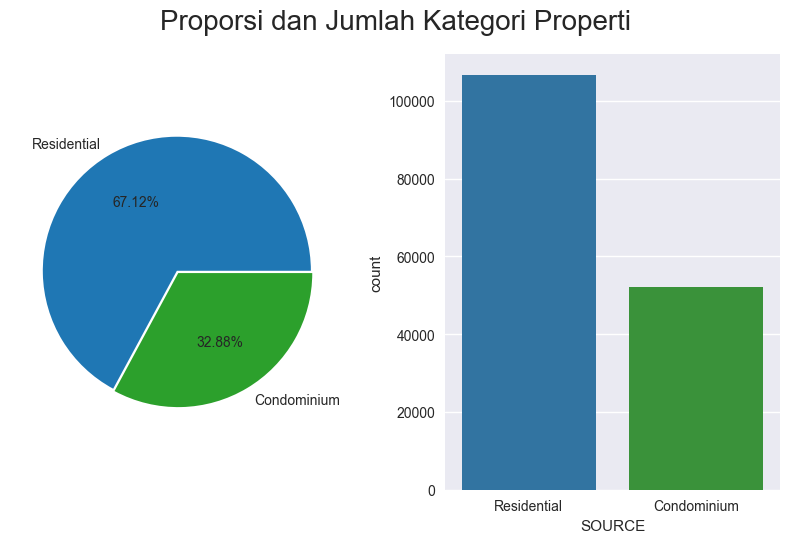

In [159]:
# Melihat proporsi dan jumlah kategori properti
piebar(df_DCproperties,'SOURCE', 'Proporsi dan Jumlah Kategori Properti','Residential','Condominium')

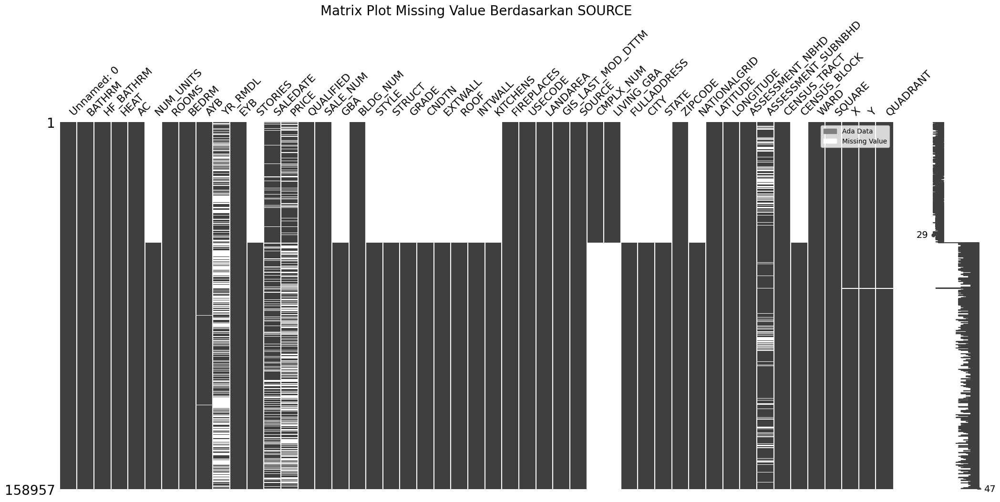

In [10]:
# Melihat missing value berdasarkan SOURCE
msnosort(df_DCproperties,'SOURCE')

Dataset mengandung informasi mengenai 2 tipe properti, yaitu Residential (67.12%) dan Condominium (32.88%). Berdasarkan domain knowledge dari sumber raw data yang telah disebutkan sebelumnya (Residential dan Condominium), diketahui bahwa terdapat perbedaan ketersediaan informasi dikarenakan perbedaan kolom fitur dari kedua raw data. Mengetahui hal tersebut, maka solusi yang terbaik adalah menggunakan 2 model yang berbeda untuk masing-masing tipe properti agar hasil prediksi harga lebih akurat. Oleh karena itu lingkup analisa yang akan dilakukan terbatas pada data Residential.

In [11]:
# Memisahkan data Residential
df = df_DCproperties[df_DCproperties['SOURCE']=='Residential']
df.reset_index(drop=True, inplace=True)
df.head()

,Unnamed: 0,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,STORIES,SALEDATE,PRICE,QUALIFIED,SALE_NUM,GBA,BLDG_NUM,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,GIS_LAST_MOD_DTTM,SOURCE,CMPLX_NUM,LIVING_GBA,FULLADDRESS,CITY,STATE,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,ASSESSMENT_SUBNBHD,CENSUS_TRACT,CENSUS_BLOCK,WARD,SQUARE,X,Y,QUADRANT
0,0,4,0,Warm Cool,Y,2.0,8,4,1910.0,1988.0,1972,3.0,2003-11-25 00:00:00,1095000.0,Q,1,2522.0,1,3 Story,Row Inside,Very Good,Good,Common Brick,Metal- Sms,Hardwood,2.0,5,24,1680,2018-07-22 18:01:43,Residential,NaN,NaN,1748 SWANN STREET NW,WASHINGTON,DC,20009.0,18S UJ 23061 09289,38.914680,-77.040832,Old City 2,040 D Old City 2,4201.0,004201 2006,Ward 2,152,-77.040429,38.914881,NW
1,1,3,1,Warm Cool,Y,2.0,11,5,1898.0,2007.0,1972,3.0,2000-08-17 00:00:00,NaN,U,1,2567.0,1,3 Story,Row Inside,Very Good,Good,Common Brick,Built Up,Hardwood,2.0,4,24,1680,2018-07-22 18:01:43,Residential,NaN,NaN,1746 SWANN STREET NW,WASHINGTON,DC,20009.0,18S UJ 23067 09289,38.914683,-77.040764,Old City 2,040 D Old City 2,4201.0,004201 2006,Ward 2,152,-77.040429,38.914881,NW
2,2,3,1,Hot Water Rad,Y,2.0,9,5,1910.0,2009.0,1984,3.0,2016-06-21 00:00:00,2100000.0,Q,3,2522.0,1,3 Story,Row Inside,Very Good,Very Good,Common Brick,Built Up,Hardwood,2.0,4,24,1680,2018-07-22 18:01:43,Residential,NaN,NaN,1744 SWANN STREET NW,WASHINGTON,DC,20009.0,18S UJ 23074 09289,38.914684,-77.040678,Old City 2,040 D Old City 2,4201.0,004201 2006,Ward 2,152,-77.040429,38.914881,NW
3,3,3,1,Hot Water Rad,Y,2.0,8,5,1900.0,2003.0,1984,3.0,2006-07-12 00:00:00,1602000.0,Q,1,2484.0,1,3 Story,Row Inside,Very Good,Good,Common Brick,Built Up,Hardwood,2.0,3,24,1680,2018-07-22 18:01:43,Residential,NaN,NaN,1742 SWANN STREET NW,WASHINGTON,DC,20009.0,18S UJ 23078 09288,38.914683,-77.040629,Old City 2,040 D Old City 2,4201.0,004201 2006,Ward 2,152,-77.040429,38.914881,NW
4,4,2,1,Warm Cool,Y,1.0,11,3,1913.0,2012.0,1985,3.0,NaN,NaN,U,1,5255.0,1,3 Story,Semi-Detached,Very Good,Good,Common Brick,Neopren,Hardwood,1.0,0,13,2032,2018-07-22 18:01:43,Residential,NaN,NaN,1804 NEW HAMPSHIRE AVENUE NW,WASHINGTON,DC,20009.0,18S UJ 23188 09253,38.914383,-77.039361,Old City 2,040 D Old City 2,4201.0,004201 2006,Ward 2,152,-77.040429,38.914881,NW


Kolom `SOURCE` merupakan sumber dari tipe properti. Karena tipe data condominium sudah dipisahkan, maka kolom SOURCE hanya berisi 1 data unik yaitu 'Residential'. Kolom tersebut sudah tidak menunjukkan informasi yang dibutuhkan maka akan dihapus.

In [12]:
# Menghapus kolom SOURCE
df.drop('SOURCE', axis = 1, inplace = True)

In [13]:
df[(df['PRICE']!=None)&(df['AYB']==1800) & (df['WARD']=='Ward 2') & (df['GRADE']=='Above Average') & (df['GBA']<2700) & (df['GBA']>2200)  & (df['HEAT']=='Warm Cool')].tail(2)


,Unnamed: 0,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,STORIES,SALEDATE,PRICE,QUALIFIED,SALE_NUM,GBA,BLDG_NUM,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,GIS_LAST_MOD_DTTM,CMPLX_NUM,LIVING_GBA,FULLADDRESS,CITY,STATE,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,ASSESSMENT_SUBNBHD,CENSUS_TRACT,CENSUS_BLOCK,WARD,SQUARE,X,Y,QUADRANT
37,37,2,2,Warm Cool,Y,2.0,8,4,1800.0,2009.0,1967,3.0,1997-10-20 00:00:00,339500.0,U,1,2520.0,1,3 Story,Row Inside,Above Average,Good,Common Brick,Built Up,Wood Floor,2.0,0,24,1853,2018-07-22 18:01:43,NaN,NaN,1432 CORCORAN STREET NW,WASHINGTON,DC,20009.0,18S UJ 23701 08943,38.911701,-77.033367,Old City 2,040 E Old City 2,5201.0,005201 4003,Ward 2,208,-77.033366,38.911716,NW
46,46,3,1,Warm Cool,Y,2.0,9,4,1800.0,2011.0,1964,3.0,2011-03-18 00:00:00,846000.0,Q,1,2610.0,1,3 Story,Row End,Above Average,Average,Common Brick,Built Up,Hardwood,2.0,2,24,1971,2018-07-22 18:01:43,NaN,NaN,1412 CORCORAN STREET NW,WASHINGTON,DC,20009.0,18S UJ 23761 08944,38.911716,-77.032672,Old City 2,040 E Old City 2,5201.0,005201 4003,Ward 2,208,-77.033366,38.911716,NW


Dari tabel di atas diketahui properti dengan fitur hampir identik yang merupakan data 'Qualified' dan 'Unqualified'. Data tersebut menunjukkan perbedaan harga yang sangat signifikan, dimana pada data U memiliki harga USD 339500 dan data Q dengan harga USD 846000. Dapat disimpulkan bahwa kolom Unqalified memiliki harga underpriced dan tidak sesuai dengan harga pasar.

Oleh karena itu, sesuai dengan latar belakang, akan dilakukan pemisahan pada data yang memiliki value U (unqualified) pada kolom QUALIFIED.

In [14]:
# Memisahkan data unqualified
dfunqualified = df[df['QUALIFIED']== 'U']
# Memakai data qualified untuk analisa selanjutnya 
df = df[df['QUALIFIED']=='Q']
df['QUALIFIED'].unique()

array(['Q'], dtype=object)

Karena pada kolom hanya terdapat 1 value yaitu data 'Qualified' maka kolom sudah tidak dibutuhkan. Oleh karena itu kolom `QUALIFIED` akan dihapus.

In [15]:
# Menghapus kolom QUALIFIED
df.drop('QUALIFIED', axis = 1, inplace = True)

In [16]:
# Datatype dan Menghitung jumlah dari kolom
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 45976 entries, 0 to 106687
Data columns (total 47 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Unnamed: 0          45976 non-null  int64  
 1   BATHRM              45976 non-null  int64  
 2   HF_BATHRM           45976 non-null  int64  
 3   HEAT                45976 non-null  object 
 4   AC                  45976 non-null  object 
 5   NUM_UNITS           45976 non-null  float64
 6   ROOMS               45976 non-null  int64  
 7   BEDRM               45976 non-null  int64  
 8   AYB                 45902 non-null  float64
 9   YR_RMDL             27761 non-null  float64
 10  EYB                 45976 non-null  int64  
 11  STORIES             45950 non-null  float64
 12  SALEDATE            45975 non-null  object 
 13  PRICE               45886 non-null  float64
 14  SALE_NUM            45976 non-null  int64  
 15  GBA                 45976 non-null  float64
 16  BLD

In [17]:
# Jumlah baris dan kolom
df.shape

(45976, 47)

In [18]:
# Menunjukkan statistik deskriptif masing-masing kolom
display(df.describe(), df.describe(include='object'))

,Unnamed: 0,BATHRM,HF_BATHRM,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,STORIES,PRICE,SALE_NUM,GBA,BLDG_NUM,KITCHENS,FIREPLACES,USECODE,LANDAREA,CMPLX_NUM,LIVING_GBA,ZIPCODE,LATITUDE,LONGITUDE,CENSUS_TRACT,X,Y
count,45976.000000,45976.000000,45976.000000,45976.000000,45976.000000,45976.000000,45902.000000,27761.000000,45976.000000,45950.000000,4.588600e+04,45976.000000,45976.000000,45976.000000,45975.000000,45976.000000,45976.000000,45976.000000,0.0,0.0,45976.000000,45976.000000,45976.000000,45976.000000,45902.000000,45902.000000
mean,50019.743888,2.246868,0.683857,1.194384,7.429507,3.428637,1934.930003,2004.748460,1971.069210,2.137261,6.281739e+05,1.921046,1730.294066,1.000239,1.228146,0.682595,13.149078,3160.686684,NaN,NaN,20011.483470,38.917006,-77.012562,5381.612950,-77.012583,38.916988
std,30733.717532,1.048265,0.599072,0.572219,2.217227,1.093436,31.330403,17.078211,16.963947,4.238243,5.712463e+05,1.497995,816.826791,0.015466,0.590708,0.925585,4.062043,2982.250577,NaN,NaN,7.599029,0.033424,0.043577,3499.310348,0.043576,0.033401
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1754.000000,20.000000,1928.000000,0.000000,2.500000e+02,1.000000,252.000000,1.000000,0.000000,0.000000,11.000000,0.000000,NaN,NaN,20001.000000,38.819953,-77.113909,100.000000,-77.113135,38.820576
25%,23030.750000,1.000000,0.000000,1.000000,6.000000,3.000000,1913.000000,2003.000000,1960.000000,2.000000,2.900000e+05,1.000000,1223.000000,1.000000,1.000000,0.000000,11.000000,1502.000000,NaN,NaN,20003.000000,38.893732,-77.040131,1901.000000,-77.040070,38.893936
50%,48222.000000,2.000000,1.000000,1.000000,7.000000,3.000000,1929.000000,2008.000000,1967.000000,2.000000,5.068175e+05,1.000000,1516.000000,1.000000,1.000000,0.000000,12.000000,2182.500000,NaN,NaN,20011.000000,38.917226,-77.009522,6600.000000,-77.010046,38.917389
75%,76762.500000,3.000000,1.000000,1.000000,8.000000,4.000000,1947.000000,2013.000000,1978.000000,2.000000,8.000000e+05,3.000000,1982.000000,1.000000,1.000000,1.000000,13.000000,4000.000000,NaN,NaN,20017.000000,38.943383,-76.984769,8701.000000,-76.984736,38.943542
max,106687.000000,12.000000,7.000000,6.000000,28.000000,20.000000,2018.000000,2019.000000,2018.000000,826.000000,2.200000e+07,15.000000,15902.000000,2.000000,6.000000,13.000000,39.000000,155905.000000,NaN,NaN,20052.000000,38.995435,-76.909758,11100.000000,-76.910511,38.993646


,HEAT,AC,SALEDATE,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,GIS_LAST_MOD_DTTM,FULLADDRESS,CITY,STATE,NATIONALGRID,ASSESSMENT_NBHD,ASSESSMENT_SUBNBHD,CENSUS_BLOCK,WARD,SQUARE,QUADRANT
count,45976,45976,45975,45976,45976,45976,45976,45976,45976,45976,45976,45834,45837,45837,45837,45976,39258,45837,45976,45976,45902
unique,14,3,6285,17,8,12,6,23,16,12,1,45824,1,1,45817,55,121,3710,8,3088,4
top,Forced Air,Y,2018-07-03 00:00:00,2 Story,Row Inside,Average,Good,Common Brick,Built Up,Hardwood,2018-07-22 18:01:43,945 O STREET NW,WASHINGTON,DC,18S UJ 17415 10883,Old City 1,039 K Old City 1,009000 1001,Ward 4,4327,NW
freq,18164,35327,53,34962,19064,14486,21974,34538,13646,35435,45976,2,45837,45837,2,6121,1127,285,8378,289,22602


|Attribute||Data Type||Description||Variable Type|
|:-||:-||:-||:-|
|Attribute||Data Type||Description||Variable Type|
|Unnamed: ||0||Int||Index|
|BATHRM||Int||Jumlah kamar mandi||Quant. Diskrit|
|HF_BATHRM||Int||Jumlah kamar mandi tanpa bathtub atau shower||Quant. Diskrit|
|HEAT||Object||Tipe pemanas ruangan||Qual. (Nominal)|
|AC||Object||Pendingin ruangan, Y - Ada, N - Tidak ada||Qual. (Nominal)|
|NUM_UNITS||Float||Jumlah unit||Quant. Diskrit|
|ROOMS||Int||Jumlah ruangan||Quant. Diskrit|
|BEDRM||Int||Jumlah kamar tidur||Quant. Diskrit|
|AYB||Float||Tahun properti dibangun||Quant. Kontinu|
|YR_RMDL||Float||Tahun properti direnovasi yang mengubah struktur||Quant. Kontinu|
|EYB||Int||Tahun properti direnovasi tanpa mengubah struktur||Quant. Kontinu|
|STORIES||Float||Jumlah lantai||Quant. Diskrit|
|SALEDATE||Object||Tanggal penjualan terbaru||Quant. Kontinu|
|PRICE||Float||Harga penjualan terbaru||Quant. KontinU|
|SALE_NUM||Int||Jumlah penjualan sejak tahun 2014||Quant. Diskrit|
|GBA||Float||Luas total area bangunan dalam squarefeet||Quant. Kontinu|
|BLDG_NUM||Int||Jumlah bangunan dalam properti||Quant. Diskrit|
|STYLE||Object||Style properti||Qual. (Nominal)|
|STRUCT||Object||Struktur bangunan||Qual. (Nominal)|
|GRADE||Object||Kualitas properti||Qual. (Ordinal)|
|CNDTN||Object||Kondisi properti||Qual. (Ordinal)|
|EXTWALL||Object||Jenis dinding eksterior||Qual. (Nominal)|
|ROOF||Object||Jenis atap rumah||Qual. (Nominal)|
|INTWALL||Object||Jenis dinding interior||Qual. (Nominal)|
|KITCHENS||Float||Jumlah dapur||Quant. Diskrit|
|FIREPLACES||Int||Jumlah perapian||Quant. Diskrit|
|USECODE||Int||Kode penggunaan properti||Qual. (Nominal)|
|LANDAREA||Int||Luas tanah properti dalam square feet||Quant. Kontinu|
|GIS_LAST_MOD_DTTM||Object||Tanggal data diperbaharui||Quant. Kontinu|
|CMPLX_NUM||Float||Nomor komplek||Qual. (Nominal)|
|LIVING_GBA||Float||Luas area tempat tinggal dalam square feet||Quant. Kontinu|
|FULLADDRESS||Object||Alamat jalan||Qual. (Nominal)|
|CITY||Object||Kota||Qual. (Nominal)|
|STATE||Object||Negara bagian||Qual. (Nominal)|
|ZIPCODE||Float||Kode pos||Qual. (Nominal)|
|NATIONALGRID||Object||Informasi terkait power station terdekat||Qual. (Nominal)|
|LATITUDE||Float||Latitude lokasi properti||Qual. (Nominal)|
|LONGITUDE||Float||Longitude lokasi properti||Qual. (Nominal)|
|ASSESSMENT_NBHD||Object||ID lingkungan||Qual. (Nominal)|
|ASSESSMENT_SUBNBHD||Object||ID sub lingkungan||Qual. (Nominal)|
|CENSUS_TRACT||Float||Region sensus||Qual. (Nominal)|
|CENSUS_BLOCK||Object||Blok pengambilan sensus||Qual. (Nominal)|
|WARD||Object||Distrik||Qual. (Nominal)|
|SQUARE||Object||Square (SSL - (Square, Suffix, Lot))||Qual. (Nominal)|
|X||Float||Longitude lokasi properti||Qual. (Nominal)|
|Y||Float||Latitude lokasi properti||Qual. (Nominal)|
|QUADRANT||Object||Kuadran kota (NE,SE,SW,NW)||Qual. (Nominal)|

In [19]:
# Memisahkan kolom numerik dan kategorik
Numerik = ['BATHRM','HF_BATHRM', 'NUM_UNITS','ROOMS','BEDRM', 'AYB', 'YR_RMDL','EYB','STORIES','PRICE','SALE_NUM','GBA','BLDG_NUM','KITCHENS','FIREPLACES','USECODE','LANDAREA','CMPLX_NUM','LIVING_GBA','ZIPCODE','LATITUDE','LONGITUDE','CENSUS_TRACT','X','Y']
Kategorik = ['HEAT','AC','SALEDATE','STYLE','STRUCT','GRADE','CNDTN','EXTWALL','ROOF','INTWALL','GIS_LAST_MOD_DTTM','FULLADDRESS','CITY','STATE','NATIONALGRID','ASSESSMENT_NBHD','ASSESSMENT_SUBNBHD','CENSUS_BLOCK','WARD','SQUARE','QUADRANT']

## Numeric
### CMPLX_NUM & LIVING_GBA
Berdasarkan sumber dataset dapat diketahui bahwa kolom CMPLX_NUM dan LIVING_GBA merupakan fitur dari raw data condominium dan kolom tersebut tidak memiliki value pada tipe residential, sehingga 2 kolom tersebut akan dihapus.

### USECODE
Use code merupakan kode untuk mengidentifikasi penggunaan properti dengan cara mengelompokkan jenis properti. Adapun makna dari kode tersebut yang akan dijelaskan lebih lanjut pada kolom di bawah. Data dari kolom ini merupakan data numerik kualitatif sehingga data type akan diubah menjadi object pada data preprocessing.

In [20]:
# Melihat Unique pada kolom USECODE
df['USECODE'].unique()

array([24, 11, 13, 12, 23, 15, 39, 19], dtype=int64)

|Code||Short Description||	Long Description|
|:-||:-||:-|
|11||Residential-Row-Single-Family||	(CLASS 1): Single-family dwelling with 2 walls built as common walls with another structure, 2 exposed walls; primarily used as place of abode|
|12||	Residential-Detached-Single-Family||	(CLASS 1): Free-standing dwelling with open space around it and in all exterior walls; primarily used as abode.|
|13||	Residential-Semi-Detached-Single-Family||	(CLASS 1): Structure with 1 dwelling place, 1 wall built as common wall with another structure, 3 exposed walls; primarily used as abode.|
|15||	Residential-Mixed Use||	(CLASS 1 or 2): Single-family property with commercial (usually office) space in part of house. If use is mostly single-family, lot may be eligible for a Homestead Deduction. Mixed-use eligible.|
|19||	Residential-Single-Family-Miscellaneous||	(CLASS 1) : All other residential-single family uses not otherwise coded|
|23||	Residential Flats-Less than 5||	(CLASS 1): Structure with more than 1 single family unit, less than 5; usually self-contained, under 1 roof; few accessory uses; in some cases, owner occupies 1 unit; built for this use.|
|24||	Residential-Conversions-Less than 5||	(CLASS 1 ): Structure with more than 1 single-family unit, but less than 5; usually self-contained, under 1 roof; few accessory uses; 1 unit may be owner-occupied; original primary use not multi-family.|
|39||	Residential-Transient, Miscellaneous||	(CLASS 2): All other residential transient not otherwise coded.

### ZIPCODE
Data pada kolom ini menunjukkan kode pos masing-masing residen dan merupakan data numerik kualitatif. Sehingga, tipe data dari kolom ini akan diubah menjadi object pada tahap data preprocessing.

In [21]:
# Melihat value kolom ZIPCODE
df['ZIPCODE'].unique()

array([20009., 20037., 20036., 20005., 20052., 20008., 20001., 20024.,
       20003., 20002., 20007., 20016., 20015., 20010., 20011., 20012.,
       20017., 20018., 20019., 20020., 20032.])

### SALE_NUM
Kolom `SALE_NUM` menunjukkan berapa banyaknya penjualan atau transaksi yang terjadi pada properti, dari sumber didapatkan informasi terkait kolom tersebut yang menjelaskan bahwa data tidak merepresentasikan banyaknya penjualan. Sehingga data pada kolom tersebut akan diabaikan dan ditindaklanjuti pada tahap data preprocessing.

In [22]:
# Melihat unique kolom SALE_NUM
df['SALE_NUM'].unique()

array([ 1,  3,  4,  5,  2,  7,  6,  9,  8, 10, 11, 12, 13, 15],
      dtype=int64)

### X, Y, LONGITUDE & LATITUDE

In [23]:
# Melihat perbedaan kolom LONGITUDE dan LATITUDE dengan X dan Y
display(df[['X','Y','LONGITUDE','LATITUDE']].head(10), df[['X','Y','LONGITUDE','LATITUDE']].tail(10))

,X,Y,LONGITUDE,LATITUDE
0,-77.040429,38.914881,-77.040832,38.914680
2,-77.040429,38.914881,-77.040678,38.914684
3,-77.040429,38.914881,-77.040629,38.914683
5,-77.040429,38.914881,-77.039715,38.914331
7,-77.040429,38.914881,-77.040129,38.915408
8,-77.040429,38.914881,-77.039903,38.915017
14,-77.040429,38.914881,-77.039716,38.915038
16,-77.040429,38.914881,-77.039844,38.915018
19,-77.040429,38.914881,-77.040138,38.915019
22,-77.033366,38.911716,-77.033925,38.911368


,X,Y,LONGITUDE,LATITUDE
106656,-76.997144,38.847259,-76.997142,38.848216
106657,-76.997144,38.847259,-76.997192,38.848213
106662,-76.997266,38.824946,-76.997396,38.825131
106663,-76.997266,38.824946,-76.997430,38.825080
106664,-76.997266,38.824946,-76.997449,38.825026
106666,-76.997266,38.824946,-76.997489,38.824922
106668,-76.997266,38.824946,-76.997597,38.824805
106672,-77.006347,38.821799,-77.007009,38.820755
106673,-77.006347,38.821799,-77.007013,38.820823
106687,-77.006347,38.821799,-77.005828,38.821855


In [24]:
# Melihat missing value pada kolom 
df[['X','Y','LONGITUDE','LATITUDE']].isna().sum()

X            74
Y            74
LONGITUDE     0
LATITUDE      0
dtype: int64

Dari tabel di atas dapat dilihat nilai pada kolom `X` dan `Y` cenderung lebih konstan, sehingga diasumsikan nilai pada kolom `LONGITUDE` dan `LATITUDE` lebih akurat karena memiliki koordinat yang tidak sama dari masing-masing unit. Selain itu, kolom `X` dan `Y` memiliki missing value, sehingga kolom yang digunakan sebagai koordinat adalah kolom `LONGITUDE` dan `LATITUDE` dan kolom `X` dan `Y` akan dihapus pada saat data preprocessing.

### STORIES

In [25]:
# Melihat anomali pada kolom STORIES
df['STORIES'].value_counts().tail(10)

6.00      4
25.00     4
1.70      2
8.25      1
2.30      1
275.00    1
250.00    1
826.00    1
7.00      1
20.00     1
Name: STORIES, dtype: int64

In [26]:
# Cek anomali kolom STORIES dengan value 826 lantai
df[df['STORIES']==826]

,Unnamed: 0,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,STORIES,SALEDATE,PRICE,SALE_NUM,GBA,BLDG_NUM,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,GIS_LAST_MOD_DTTM,CMPLX_NUM,LIVING_GBA,FULLADDRESS,CITY,STATE,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,ASSESSMENT_SUBNBHD,CENSUS_TRACT,CENSUS_BLOCK,WARD,SQUARE,X,Y,QUADRANT
7546,7546,1,2,Hot Water Rad,N,1.0,6,3,1920.0,2001.0,1969,826.0,2015-01-26 00:00:00,760000.0,5,1442.0,1,4 Story,Row Inside,Good Quality,Good,Common Brick,Metal- Sms,Wood Floor,1.0,0,11,966,2018-07-22 18:01:43,NaN,NaN,664 E STREET NE,WASHINGTON,DC,20002.0,18S UJ 26868 07163,38.896299,-76.996409,Old City 1,039 K Old City 1,8302.0,008302 1009,Ward 6,861,-76.997269,38.896641,NE


In [27]:
# Melihat informasi kolom STORIES dan kolom STYLE
df[['STORIES','STYLE']].sample(20)

,STORIES,STYLE
16558,2.0,2 Story
52470,2.0,2 Story
52809,2.0,2 Story
47308,2.5,2.5 Story Fin
87199,2.0,2 Story
40066,3.0,3 Story
76992,2.0,2 Story
50687,2.0,2 Story
95047,2.0,2 Story
34560,2.0,2 Story


Dari data di atas, dapat diketahui kolom `STORIES` memiliki beberapa data anomali, seperti contohnya bangunan yang memiliki 826 lantai namun data lainnya kurang sesuai dengan jumlah lantai tersebut (GBA 1442 sqft, `USECODE` 11 dimana penggunaan bangunan sebagai residential single family, `BATHRM` 1). Selain itu, kolom STYLE sudah merepresentasikan kolom `STORIES` sehingga kolom tersebut akan dihapus pada saat data preprocessing.

### AYB & EYB
Nilai AYB menunjukkan tahun properti dibangun, sedangkan EYB menunjukkan tahun renovasi. Tahun dibangun harus lebih awal daripada tahun renovasi, akan dilihat apabila terdapat tahun renovasi yang lebih awal.

In [28]:
# Melihat data dengan AYB lebih besar dari EYB
df[df['AYB']>df['EYB']].head()

,Unnamed: 0,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,STORIES,SALEDATE,PRICE,SALE_NUM,GBA,BLDG_NUM,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,GIS_LAST_MOD_DTTM,CMPLX_NUM,LIVING_GBA,FULLADDRESS,CITY,STATE,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,ASSESSMENT_SUBNBHD,CENSUS_TRACT,CENSUS_BLOCK,WARD,SQUARE,X,Y,QUADRANT
5093,5093,1,1,Forced Air,Y,1.0,5,2,1977.0,1985.0,1960,2.00,2005-05-03 00:00:00,335000.0,1,1350.0,1,2 Story,Row Inside,Above Average,Average,Common Brick,Metal- Sms,Hardwood,1.0,1,11,1151,2018-07-22 18:01:43,NaN,NaN,1425 CARROLLSBURG PLACE SW,WASHINGTON,DC,20024.0,18S UJ 25625 04518,38.872228,-77.010062,Old City 1,039 E Old City 1,6400.0,006400 2001,Ward 6,655,-77.009740,38.872505,SW
13307,13307,4,0,Hot Water Rad,N,4.0,12,4,1973.0,2001.0,1970,4.00,2018-01-17 00:00:00,2025000.0,4,5656.0,1,4 Story,Row Inside,Good Quality,Average,Common Brick,Built Up,Hardwood,4.0,1,24,2852,2018-07-22 18:01:43,NaN,NaN,21 8TH STREET NE,WASHINGTON,DC,20002.0,18S UJ 27006 06519,38.890524,-76.994658,Capitol Hill,009 C Capitol Hill,8100.0,008100 3008,Ward 6,919,-76.994390,38.890578,NE
20477,20477,3,1,Warm Cool,Y,1.0,9,3,2000.0,NaN,1999,3.00,2014-06-27 00:00:00,2620000.0,3,2474.0,1,3 Story,Row Inside,Exceptional-B,Very Good,Common Brick,Built Up,Hardwood,1.0,3,11,2000,2018-07-22 18:01:43,NaN,NaN,1231 28TH STREET NW,WASHINGTON,DC,20007.0,18S UJ 21649 08386,38.906265,-77.056869,Georgetown,025 J Georgetown,100.0,000100 2006,Ward 2,1215,-77.056279,38.906508,NW
20478,20478,4,1,Warm Cool,Y,1.0,10,6,2003.0,NaN,1999,2.75,2003-09-03 00:00:00,2250000.0,1,3052.0,1,3 Story,Row End,Exceptional-B,Excellent,Common Brick,Metal- Sms,Hardwood,1.0,2,11,2400,2018-07-22 18:01:43,NaN,NaN,1229 28TH STREET NW,WASHINGTON,DC,20007.0,18S UJ 21648 08380,38.906211,-77.056877,Georgetown,025 J Georgetown,100.0,000100 2006,Ward 2,1215,-77.056279,38.906508,NW
20479,20479,4,1,Warm Cool,Y,1.0,7,4,2003.0,NaN,1999,2.50,2015-07-16 00:00:00,2095000.0,5,2060.0,1,2.5 Story Fin,Row End,Exceptional-B,Good,Common Brick,Metal- Sms,Hardwood,1.0,2,11,2000,2018-07-22 18:01:43,NaN,NaN,2721 OLIVE STREET NW,WASHINGTON,DC,20007.0,18S UJ 21683 08375,38.906227,-77.056488,Georgetown,025 J Georgetown,100.0,000100 2006,Ward 2,1215,-77.056279,38.906508,NW


### AYB & SALEDATE
Kolom `AYB` menunjukkan tahun properti dibangun, sedangkan `SALEDATE` menunjukkan waktu terakhir properti diperjualbelikan. Dari deskirpsi masing-masing kolom, terlihat adanya kemungkinan bahwa transaksi terjadi sebelum properti tersebut dibangun. Hal ini akan dianalisa lebih lanjut pada tahap data preprocessing.

### YR_RMDL
Terdapat value typo pada kolom `YR_RMDL`, dimana kolom seharusnya menunjukkan 4 digit angka sebagai tahun. Sehingga data akan ditindaklanjuti pada tahap data preprocessing.

In [29]:
# Melihat typo kolom YR_RMDL
df[df['YR_RMDL']<1000]

,Unnamed: 0,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,STORIES,SALEDATE,PRICE,SALE_NUM,GBA,BLDG_NUM,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,GIS_LAST_MOD_DTTM,CMPLX_NUM,LIVING_GBA,FULLADDRESS,CITY,STATE,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,ASSESSMENT_SUBNBHD,CENSUS_TRACT,CENSUS_BLOCK,WARD,SQUARE,X,Y,QUADRANT
56600,56600,1,1,Forced Air,Y,1.0,8,4,1929.0,20.0,1967,2.0,2015-08-06 00:00:00,335000.0,2,1640.0,1,2 Story,Semi-Detached,Above Average,Good,Common Brick,Built Up,Hardwood,1.0,1,13,2380,2018-07-22 18:01:43,NaN,NaN,617 ONEIDA PLACE NW,WASHINGTON,DC,20011.0,18S UJ 24811 14526,38.962197,-77.021993,Brightwood,006 E Brightwood,1901.0,001901 1000,Ward 4,3202,-77.021133,38.962204,NW


Selain itu, diketahui dataset berisi informasi hingga bulan juli tahun 2018. Maka akan dilihat apabila terdapat value dengan tahun di atas 2018.

In [30]:
# Melihat YR_RMDL di atas 2018
df[df['YR_RMDL']>2018]

,Unnamed: 0,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,STORIES,SALEDATE,PRICE,SALE_NUM,GBA,BLDG_NUM,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,GIS_LAST_MOD_DTTM,CMPLX_NUM,LIVING_GBA,FULLADDRESS,CITY,STATE,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,ASSESSMENT_SUBNBHD,CENSUS_TRACT,CENSUS_BLOCK,WARD,SQUARE,X,Y,QUADRANT
70849,70849,3,0,Forced Air,Y,1.0,7,3,1953.0,2019.0,1971,2.0,2018-01-02 00:00:00,564950.0,3,1080.0,1,2 Story,Semi-Detached,Average,Good,Common Brick,Comp Shingle,Hardwood,1.0,2,13,2434,2018-07-22 18:01:43,NaN,NaN,4914 12TH STREET NE,WASHINGTON,DC,20017.0,18S UJ 27483 12969,38.948706,-76.990779,Riggs Park,NaN,9509.0,009509 1006,Ward 5,3899,-76.991407,38.949432,NE


Terdapat 1 kolom dengan value '2019' yang menyatakan bahwa nilai tersebut tidak valid. Akan ditindaklanjuti pada tahap data preprocessing. Selain itu, akan dilihat apabila terdapat data dengan nilai `YR_RMDL` lebih kecil daripada `AYB`, dimana seharusnya `AYB` memiliki value lebih kecil karena merupakan tahun properti dibangun.

In [31]:
# Melihat data dengan AYB besar dari YR_RMDL
df[df['AYB']>df['YR_RMDL']].head()

,Unnamed: 0,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,STORIES,SALEDATE,PRICE,SALE_NUM,GBA,BLDG_NUM,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,GIS_LAST_MOD_DTTM,CMPLX_NUM,LIVING_GBA,FULLADDRESS,CITY,STATE,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,ASSESSMENT_SUBNBHD,CENSUS_TRACT,CENSUS_BLOCK,WARD,SQUARE,X,Y,QUADRANT
3716,3716,1,1,Forced Air,Y,1.0,5,3,1997.0,1995.0,2004,2.0,2016-06-22 00:00:00,640000.0,3,1484.0,1,2 Story,Row Inside,Above Average,Average,Common Brick,Built Up,Hardwood,1.0,0,11,975,2018-07-22 18:01:43,NaN,NaN,37 HANOVER PLACE NW,WASHINGTON,DC,20001.0,18S UJ 25702 08493,38.908045,-77.010178,Old City 2,040 A Old City 2,4600.0,004600 1004,Ward 5,617,-77.010328,38.908045,NW
3795,3795,1,1,Warm Cool,Y,1.0,5,2,1980.0,1978.0,1992,2.0,2017-06-28 00:00:00,792500.0,2,1356.0,1,2 Story,Row Inside,Above Average,Average,Common Brick,Metal- Sms,Hardwood,1.0,1,11,1066,2018-07-22 18:01:43,NaN,NaN,403 4TH STREET NE,WASHINGTON,DC,20002.0,18S UJ 26522 07021,38.894946,-77.000357,Old City 1,039 K Old City 1,8301.0,008301 2006,Ward 6,812,-77.000295,38.895546,NE
4015,4015,2,1,Warm Cool,Y,2.0,6,3,1972.0,1966.0,1981,3.0,1997-10-08 00:00:00,338500.0,1,1890.0,1,3 Story,Row Inside,Above Average,Good,Common Brick,Built Up,Hardwood,2.0,2,24,1327,2018-07-22 18:01:43,NaN,NaN,1733 CORCORAN STREET NW,WASHINGTON,DC,20009.0,18S UJ 23152 08993,38.912035,-77.039709,Old City 2,040 D Old City 2,5301.0,005301 4001,Ward 2,155,-77.039833,38.911727,NW
12077,12077,2,0,Forced Air,Y,1.0,2,2,1911.0,1880.0,1964,1.0,2014-05-02 00:00:00,570000.0,2,1232.0,1,1 Story,Row Inside,Average,Good,Common Brick,Metal- Sms,Lt Concrete,1.0,1,11,864,2018-07-22 18:01:43,NaN,NaN,203 13TH STREET SE,WASHINGTON,DC,20003.0,18S UJ 27532 06152,38.887320,-76.988497,Old City 1,039 M Old City 1,6700.0,006700 2006,Ward 6,1015,-76.989324,38.886668,SE
12819,12819,1,1,Hot Water Rad,Y,1.0,7,3,1978.0,1970.0,1984,2.0,2001-05-02 00:00:00,295000.0,1,1444.0,1,2 Story,Row Inside,Average,Average,Common Brick,Built Up,Hardwood,1.0,1,11,1216,2018-07-22 18:01:43,NaN,NaN,411 11TH STREET NE,WASHINGTON,DC,20002.0,18S UJ 27310 07028,38.895166,-76.991282,Old City 1,039 K Old City 1,8100.0,008100 1005,Ward 6,985,-76.991287,38.895310,NE


### Categoric

In [32]:
# Data unik masing-masing fitur kategorik
kat1= []
for i in Kategorik:
    if df[i].nunique()<=100:
        kat1.append(i)
    else:
        continue

listItem = []
for col in df[kat1] :
    listItem.append([col, df[col].nunique(), df[col].unique()])

dfDesc = pd.DataFrame(columns=['dataFeatures','unique', 'uniqueSample'],
                     data=listItem)
dfDesc

,dataFeatures,unique,uniqueSample
0,HEAT,14,"[Warm Cool, Hot Water Rad, Forced Air, Elec Base Brd, Ht Pump, Wall Furnace, Water Base Brd, Electric Rad, Air Exchng, Evp Cool, No Data, Ind Unit, Air-Oil, Gravity Furnac]"
1,AC,3,"[Y, N, 0]"
2,STYLE,17,"[3 Story, 4 Story, 2 Story, 2.5 Story Fin, 3.5 Story Fin, 1 Story, 1.5 Story Fin, 2.5 Story Unfin, Default, 3.5 Story Unfin, 1.5 Story Unfin, Split Level, Split Foyer, Bi-Level, Vacant, 4.5 Story Fin, 4.5 Story Unfin]"
3,STRUCT,8,"[Row Inside, Semi-Detached, Single, Row End, Multi, Town Inside, Town End, Default]"
4,GRADE,12,"[Very Good, Above Average, Good Quality, Excellent, Average, Superior, Fair Quality, Exceptional-D, Exceptional-C, Low Quality, Exceptional-A, Exceptional-B]"
5,CNDTN,6,"[Good, Very Good, Average, Excellent, Fair, Poor]"
6,EXTWALL,23,"[Common Brick, Stucco, Stone, Stucco Block, Brick/Stone, Concrete Block, Face Brick, Wood Siding, Brick/Siding, Brick/Stucco, Stone Veneer, Brick Veneer, Vinyl Siding, Stone/Stucco, Stone/Siding, Aluminum, Concrete, Metal Siding, Shingle, Hardboard, Default, Plywood, Adobe]"
7,ROOF,16,"[Metal- Sms, Built Up, Neopren, Metal- Cpr, Typical, Slate, Comp Shingle, Composition Ro, Metal- Pre, Shake, Shingle, Clay Tile, Water Proof, Wood- FS, Concrete Tile, Concrete]"
8,INTWALL,12,"[Hardwood, Wood Floor, Hardwood/Carp, Carpet, Ceramic Tile, Lt Concrete, Default, Terrazo, Parquet, Resiliant, Vinyl Sheet, Vinyl Comp]"
9,GIS_LAST_MOD_DTTM,1,[2018-07-22 18:01:43]


### QUADRANT
Area di Washington D.C terbagi menjadi 4 kuadran yang terdiri dari Northwest, Northeast, Southeast, dan Southwest.

### WARD
Area Washington, D.C. terbagi menjadi 8 Ward, setiap ward terdiri dari beberapa neighborhood.

|Ward||Neighborhood|
|:-||:-|
|Ward 1||	Adams Morgan, Columbia Heights, Kalorama Triangle, etc|
|Ward 2||	Burleith, Chinatown, Downtown, etc|
|Ward 3||American University Park, Cathedral Heights, Chevy Chase, etc|
|Ward 4||	Barnaby Woods, Brightwood, Brightwood Park, etc|
|Ward 5||	Arboretum, Bloomingdale, Brentwood, etc|
|Ward 6||	Barney Circle, Capitol Hill, Capitol Riverfront, etc|
|Ward 7||	Benning Heights, Benning Ridge, Benning, etc|
|Ward 8||	Anacostia, Barry Farm, Bellevue, etc|

### STYLE
Storey (Inggris) atau Story( Amerika) adalah tingkatan lantai pada bangunan yang biasa digunakan pada suatu properti secara fungsional. Untuk penomoran story, di Amerika menggunakan jumlah nomor yang sama dengan jumlah lantai. Untuk 'setengah' story (1.5, 2.5, dll) menunjukkan bahwa lantai di atasnya memiliki balkon di dalam rumah (atau setengah area dari luas lantai bawah)

### CITY & STATE
City dan State merupakan kota dan negara bagian dari data properti, sedangkan pada pengumpulan data hanya diambil dari Washington, D.C. dimana disebutkan raw data didapat dari Website resmi Washington DC (Opendata.DC). Sehingga kolom akan dihapus pada saat data preprocessing karena tidak menunjukkan info yang berarti.

### GIS_LAST_MOD_DTTM
Berdasarkan sumber, diketahui kolom GIS_LAST_MOD_DTTM menunjukkan terakhirnya data diupdate, dimana value unik yang terdapat pada kolom tersebut ada 1 yaitu '2018-07-22 18:01:43'. Data tersebut tidak menunjukkan info yang berarti dan tidak relevan sehingga kolom akan dihapus pada saat data preprocessing.

### AC
Terdapat value '0' pada kolom AC, yang menunjukkan kejanggalan dibandingkan dengan value lain yaitu 'Y' (yes / memiliki AC) dan 'N' (no / tidak memiliki AC). Data tersebut akan dianalisa lebih lanjut pada tahap data preprocessing

### HEAT
Terdapat value 'No Data' pada kolom HEAT, sehingga akan ditindaklanjuti pada tahap data preprocessing.

### STRUCT, STYLE, INTWALL & EXTWALL
Terdapat value 'default' pada kolom STRUCT, STYLE, INTWALL dan EXTWALL, yang akan ditindaklanjuti pada tahap data preprocessing.

### GRADE & CNDTN
Ada 2 kolom yang termasuk dalam Rating Scale yaitu GRADE dan CNDTN. Berdasarkan sumber dataset, kolom-kolom tersebut telah memiliki tingkatan masing-masing. Tingkatan dalam urutan terburuk sampai terbaik antara lain:

1. CNDTN : Poor, Fair, Average, Good, Very Good, Excellent
2. GRADE: Low Quality, Fair Quality, Average, Above Average, Good Quality, Very Good, Excellent, Superior, Exceptional A, Exceptional B, Exceptional C, Exceptional D

# Hasil Data Understanding
Adapun beberapa hal yang dapat disimpulkan dari pemahaman data di atas, antara lain:

- Lingkup analisa yang akan dilakukan yaitu untuk properti 'Residential' dan hanya pada data 'Qualified'
- Terdapat 45976 baris dan 47 kolom, dimana salah satu kolomnya adalah kolom index
- Kolom index bernama Unnamed: 0 diasumsikan didapat melalui auto-generate saat penggabungan raw data oleh dataset creator dan - setelah ditelusuri kolom tersebut memiliki data yang tidak berarti untuk analisa selanjutnya
- Terdapat 26 kolom numerik dan 21 kolom kategorik
- Terindikasi adanya missing value di dalam data sehingga akan ditindaklanjuti di bagian data preprocessing
- Terindikasinya beberapa kolom yang tidak diperlukan untuk dianalisa lebih lanjut, yang akan dihapus dibagian data preprocessing, yaitu kolom Unnamed: 0, CITY, STATE, GIS_LAST_MOD_DTTM, SALE_NUM, STORIES, CMPLX_NUM, LIVING_GBA, X, dan Y
- Terdapat beberapa anomali dan typo pada kolom AC, HEAT, STRUCT, STYLE, INTWALL, EXTWALL, AYB, EYB, SALEDATE, dan YR_RMDL yang akan ditindaklanjuti di bagian data preprocessing

# Exploratory Data Analysis & Preprocessing

In [33]:
# Membuat dataset baru
dfclean = df.copy()

## Data Irrelevelant

Berdasarkan informasi pada tahap Data Understanding, terdapat beberapa kolom yang tidak diperlukan sehingga kolom-kolom tersebut akan dihapus.

In [34]:
# Menghapus kolom-kolom yang tidak relevan
dfclean.drop(['Unnamed: 0','CITY','STATE','GIS_LAST_MOD_DTTM','SALE_NUM','STORIES', 'CMPLX_NUM', 'LIVING_GBA', 'X','Y'], axis=1, inplace=True)
dfclean.head()

,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,SALEDATE,PRICE,GBA,BLDG_NUM,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,FULLADDRESS,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,ASSESSMENT_SUBNBHD,CENSUS_TRACT,CENSUS_BLOCK,WARD,SQUARE,QUADRANT
0,4,0,Warm Cool,Y,2.0,8,4,1910.0,1988.0,1972,2003-11-25 00:00:00,1095000.0,2522.0,1,3 Story,Row Inside,Very Good,Good,Common Brick,Metal- Sms,Hardwood,2.0,5,24,1680,1748 SWANN STREET NW,20009.0,18S UJ 23061 09289,38.914680,-77.040832,Old City 2,040 D Old City 2,4201.0,004201 2006,Ward 2,152,NW
2,3,1,Hot Water Rad,Y,2.0,9,5,1910.0,2009.0,1984,2016-06-21 00:00:00,2100000.0,2522.0,1,3 Story,Row Inside,Very Good,Very Good,Common Brick,Built Up,Hardwood,2.0,4,24,1680,1744 SWANN STREET NW,20009.0,18S UJ 23074 09289,38.914684,-77.040678,Old City 2,040 D Old City 2,4201.0,004201 2006,Ward 2,152,NW
3,3,1,Hot Water Rad,Y,2.0,8,5,1900.0,2003.0,1984,2006-07-12 00:00:00,1602000.0,2484.0,1,3 Story,Row Inside,Very Good,Good,Common Brick,Built Up,Hardwood,2.0,3,24,1680,1742 SWANN STREET NW,20009.0,18S UJ 23078 09288,38.914683,-77.040629,Old City 2,040 D Old City 2,4201.0,004201 2006,Ward 2,152,NW
5,3,2,Hot Water Rad,Y,1.0,10,5,1913.0,NaN,1972,2010-02-26 00:00:00,1950000.0,5344.0,1,4 Story,Row Inside,Very Good,Good,Common Brick,Built Up,Hardwood,1.0,4,11,2196,1709 S STREET NW,20009.0,18S UJ 23157 09248,38.914331,-77.039715,Old City 2,040 D Old City 2,4201.0,004201 2006,Ward 2,152,NW
7,3,1,Hot Water Rad,Y,2.0,8,4,1906.0,2011.0,1972,2011-09-29 00:00:00,1050000.0,2401.0,1,3 Story,Row Inside,Very Good,Average,Common Brick,Metal- Sms,Hardwood,2.0,1,24,1627,1746 1/2 T STREET NW,20009.0,18S UJ 23124 09368,38.915408,-77.040129,Old City 2,040 D Old City 2,4201.0,004201 2005,Ward 2,152,NW


In [35]:
# Melihat total baris dan kolom
dfclean.shape

(45976, 37)

In [36]:
# Cek data duplikat
print(f'''data duplikat: {dfclean.duplicated().sum()}
persentase data duplikat: {round(dfclean.duplicated().sum()/df.shape[0]*100,5)}%''')

data duplikat: 0
persentase data duplikat: 0.0%


data duplikat: 0
persentase data duplikat: 0.0%
Data duplikat merupakan kesamaan nilai pada semua kolom pada dua data atau lebih. Data duplikat harus diperhatikan karena dapat mempengaruhi performa model machine learning yang dibuat, sehingga hasil evaluasi data test bisa menjadi bias karena adanya kemungkinan information leakage dari data yang ditraining. Tetapi dari informasi di atas, diketahui pada dataset tidak terdapat data duplikat.

Selain itu, ditemukan satu data typo pada kolom YR_RMDL dengan value 20 dimana seharusnya merupakan kombinasi 4 angka yang merujuk kepada tahun, karena hanya terdapat 1 baris data sehingga data akan dihapus.

In [37]:
# Melihat typo pada kolom YR_RMDL
dfclean[dfclean['YR_RMDL']==20]

,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,SALEDATE,PRICE,GBA,BLDG_NUM,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,FULLADDRESS,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,ASSESSMENT_SUBNBHD,CENSUS_TRACT,CENSUS_BLOCK,WARD,SQUARE,QUADRANT
56600,1,1,Forced Air,Y,1.0,8,4,1929.0,20.0,1967,2015-08-06 00:00:00,335000.0,1640.0,1,2 Story,Semi-Detached,Above Average,Good,Common Brick,Built Up,Hardwood,1.0,1,13,2380,617 ONEIDA PLACE NW,20011.0,18S UJ 24811 14526,38.962197,-77.021993,Brightwood,006 E Brightwood,1901.0,001901 1000,Ward 4,3202,NW


In [38]:
# Menghapus data typo
dfclean.drop(dfclean[dfclean['YR_RMDL']==20].index, axis=0,inplace=True)
dfclean[dfclean['YR_RMDL']==20]

,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,SALEDATE,PRICE,GBA,BLDG_NUM,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,FULLADDRESS,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,ASSESSMENT_SUBNBHD,CENSUS_TRACT,CENSUS_BLOCK,WARD,SQUARE,QUADRANT


# Missing Value
Selanjutnya akan dilihat pada data diskrit yang memiliki value '0'.

In [39]:
# Melihat kolom diskrit yang memiliki nilai 0
diskrit = ['BATHRM','HF_BATHRM','NUM_UNITS','ROOMS','BEDRM','KITCHENS','BLDG_NUM','FIREPLACES']
data0 = []
a = 0 
for i in diskrit: 
    for b in range(len(dfclean[i]+1)):
        if dfclean[i].values[b]<1:
            if data0 == []:
                data0.append([i,'True'])
            elif i in data0[a][0]:         
                continue
            else:
                data0.append([i,'True'])
                a+=1
        else :
            continue
        

dfCek = pd.DataFrame(columns=['Column','Contain 0'],
                     data=data0)
dfCek

,Column,Contain 0
0,BATHRM,True
1,HF_BATHRM,True
2,NUM_UNITS,True
3,ROOMS,True
4,BEDRM,True
5,KITCHENS,True
6,FIREPLACES,True


Terdapat value '0' pada kolom BATHRM, HF_BATHRM, NUM_UNITS, ROOMS, BEDRM, KITCHENS, dan FIREPLACES. Berdasarkan domain knowledge, value '0' pada kolom HF_BATHRM dan FIREPLACES wajar karena tidak semua properti residential memiliki fitur tersebut.

Sesuai dengan USECODE yaitu sebagai residential, value '0' pada kolom BATHRM, NUM_UNITS, ROOMS, BEDRM, dan KITCHENS dianggap tidak wajar. Setiap properti seharusnya memiliki kamar mandi, jumlah unit, ruangan, kamar tidur, dan dapur berdasarkan Use Code bangunan. Akan dilihat persentase kolom dengan value '0'.

In [40]:
# Melihat persentase kolom diskrit dengan value yang tidak wajar
diskrit0 = ['BATHRM','NUM_UNITS','ROOMS','BEDRM','KITCHENS']
list1 = []
for i in diskrit0:
    list1.append(len(dfclean[dfclean[i]==0])/dfclean.shape[0]*100)
sum(list1)

0.2588363240891789

Jumlah persentase data dengan value '0' pada kolom yang disebutkan senilai 0.25%. Karena tidak wajar dan persentase sedikit, value '0' akan dianggap sebagai missing value.

In [41]:
# Merubah value 0 dengan NaN
for i in diskrit0:
    dfclean[i] = dfclean[i].replace(0, np.nan)

In [42]:
# Melihat missing value masing-masing kolom
dfclean.isna().sum()

BATHRM                    5
HF_BATHRM                 0
HEAT                      0
AC                        0
NUM_UNITS                37
ROOMS                    18
BEDRM                    35
AYB                      74
YR_RMDL               18215
EYB                       0
SALEDATE                  1
PRICE                    90
GBA                       0
BLDG_NUM                  0
STYLE                     0
STRUCT                    0
GRADE                     0
CNDTN                     0
EXTWALL                   0
ROOF                      0
INTWALL                   0
KITCHENS                 25
FIREPLACES                0
USECODE                   0
LANDAREA                  0
FULLADDRESS             142
ZIPCODE                   0
NATIONALGRID            139
LATITUDE                  0
LONGITUDE                 0
ASSESSMENT_NBHD           0
ASSESSMENT_SUBNBHD     6718
CENSUS_TRACT              0
CENSUS_BLOCK            139
WARD                      0
SQUARE              

In [43]:
# Menghitung missing value
print(f'''Jumlah missing value: {dfclean.isnull().sum().sum()}
Jumlah baris dengan missing value: {dfclean[dfclean.isnull().any(axis=1)].shape[0]}''')

Jumlah missing value: 25712
Jumlah baris dengan missing value: 21931


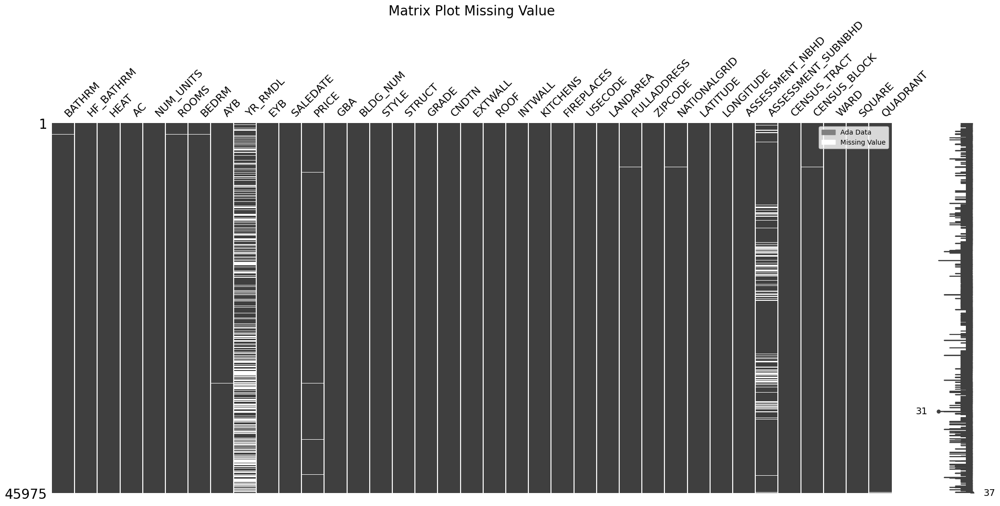

In [44]:
# Melihat missing value dengan matrix plot
missingmatrix(dfclean)

Hal pertama yang dilakukan adalah menangani missing value pada kolom `PRICE` yang akan dijadikan *target* pada proses pembuatan model machine learning. Penanganan yang dilakukan adalah menghapus data yang memiliki missing value pada kolom `PRICE`. Hal tersebut dilakukan karena data target tidak bisa dilakukan penanganan lain, apabila target bukan merupakan data aktual akan menimbulkan bias pada hasil prediksi.

In [45]:
# Melihat missing value pada kolom price
dfclean['PRICE'].isna().sum()

90

In [46]:
# Menghapus data dengan missing value pada kolom price
dfclean.drop(dfclean[dfclean['PRICE'].isna()==True].index, axis=0,inplace=True)
dfclean.shape

(45885, 37)

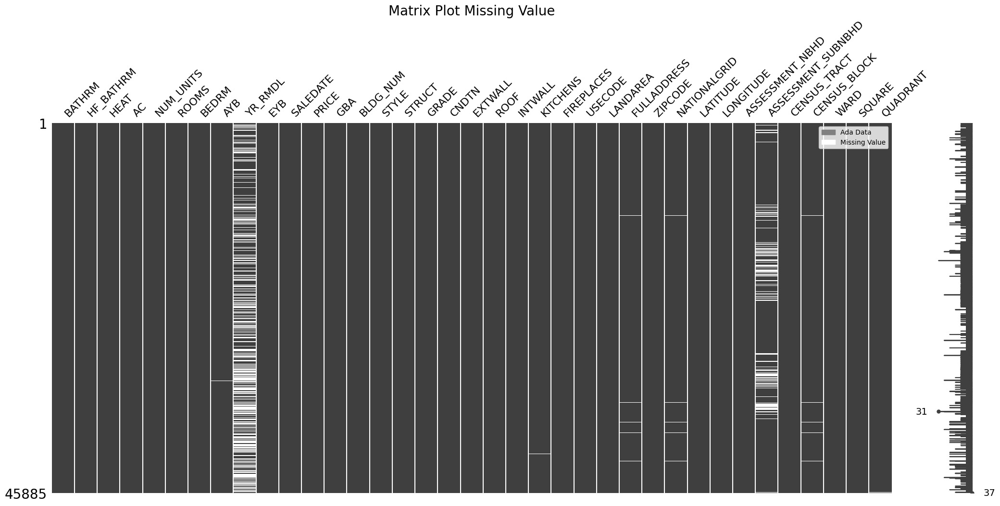

In [47]:
# Melihat missingness pada dataset
missingmatrix(dfclean)

In [48]:
# Persentase Missing Value
dfclean.isna().sum()/dfclean.shape[0]*100

BATHRM                 0.010897
HF_BATHRM              0.000000
HEAT                   0.000000
AC                     0.000000
NUM_UNITS              0.080636
ROOMS                  0.037049
BEDRM                  0.074098
AYB                    0.159093
YR_RMDL               39.568486
EYB                    0.000000
SALEDATE               0.000000
PRICE                  0.000000
GBA                    0.000000
BLDG_NUM               0.000000
STYLE                  0.000000
STRUCT                 0.000000
GRADE                  0.000000
CNDTN                  0.000000
EXTWALL                0.000000
ROOF                   0.000000
INTWALL                0.000000
KITCHENS               0.054484
FIREPLACES             0.000000
USECODE                0.000000
LANDAREA               0.000000
FULLADDRESS            0.309469
ZIPCODE                0.000000
NATIONALGRID           0.302931
LATITUDE               0.000000
LONGITUDE              0.000000
ASSESSMENT_NBHD        0.000000
ASSESSME

Dari missingness di atas diambil beberapa kesimpulan:

- Melakukan drop pada data dengan missing value di bawah 1% karena tidak akan mempengaruhi distribusi data secara signifikan
- Melakukan analisa lebih lanjut pada kolom YR_RMDL dan ASSESSMENT_SUBNBHD karena memiliki missing value yang cukup signifikan yaitu 39.56% dan 14.61%

In [49]:
# Menghapus data dengan missing value di bawah 1% 
kolomMV = ['BATHRM', 'NUM_UNITS', 'ROOMS', 'BEDRM', 'AYB', 'KITCHENS','FULLADDRESS','NATIONALGRID','CENSUS_BLOCK','QUADRANT']
dfclean.dropna(subset=kolomMV, inplace=True)
dfclean.isna().sum()

BATHRM                    0
HF_BATHRM                 0
HEAT                      0
AC                        0
NUM_UNITS                 0
ROOMS                     0
BEDRM                     0
AYB                       0
YR_RMDL               17947
EYB                       0
SALEDATE                  0
PRICE                     0
GBA                       0
BLDG_NUM                  0
STYLE                     0
STRUCT                    0
GRADE                     0
CNDTN                     0
EXTWALL                   0
ROOF                      0
INTWALL                   0
KITCHENS                  0
FIREPLACES                0
USECODE                   0
LANDAREA                  0
FULLADDRESS               0
ZIPCODE                   0
NATIONALGRID              0
LATITUDE                  0
LONGITUDE                 0
ASSESSMENT_NBHD           0
ASSESSMENT_SUBNBHD     6654
CENSUS_TRACT              0
CENSUS_BLOCK              0
WARD                      0
SQUARE              

### YR_RMDL
Kolom YR_RMDL memiliki missing value yang besar yaitu 39.56%, salah satu pilihannya adalah menghapus kolom tersebut. Tetapi kolom YR_RMDL menunjukkan tahun perubahan struktur bangunan. Perubahan struktur bangunan atau renovasi dapat meningkatkan laba atau Return of Investment (ROI) sebuah properti (Investopedia), sehingga secara domain knowledge diketahui bahwa value kolom tersebut mempengaruhi harga properti.

Kolom EYB menunjukkan tahun renovasi tanpa mengubah struktur dan tidak memiliki missing value, tetapi apabila model hanya menggunakan kolom tersebut, diketahui bahwa terdapat tahun renovasi yang lebih baru pada kolom YR_RMDL.

In [50]:
# Melihat YR_RMDL yang lebih besar dari EYB
df[df['YR_RMDL']>df['EYB']].head()

,Unnamed: 0,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,STORIES,SALEDATE,PRICE,SALE_NUM,GBA,BLDG_NUM,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,GIS_LAST_MOD_DTTM,CMPLX_NUM,LIVING_GBA,FULLADDRESS,CITY,STATE,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,ASSESSMENT_SUBNBHD,CENSUS_TRACT,CENSUS_BLOCK,WARD,SQUARE,X,Y,QUADRANT
0,0,4,0,Warm Cool,Y,2.0,8,4,1910.0,1988.0,1972,3.0,2003-11-25 00:00:00,1095000.0,1,2522.0,1,3 Story,Row Inside,Very Good,Good,Common Brick,Metal- Sms,Hardwood,2.0,5,24,1680,2018-07-22 18:01:43,NaN,NaN,1748 SWANN STREET NW,WASHINGTON,DC,20009.0,18S UJ 23061 09289,38.914680,-77.040832,Old City 2,040 D Old City 2,4201.0,004201 2006,Ward 2,152,-77.040429,38.914881,NW
2,2,3,1,Hot Water Rad,Y,2.0,9,5,1910.0,2009.0,1984,3.0,2016-06-21 00:00:00,2100000.0,3,2522.0,1,3 Story,Row Inside,Very Good,Very Good,Common Brick,Built Up,Hardwood,2.0,4,24,1680,2018-07-22 18:01:43,NaN,NaN,1744 SWANN STREET NW,WASHINGTON,DC,20009.0,18S UJ 23074 09289,38.914684,-77.040678,Old City 2,040 D Old City 2,4201.0,004201 2006,Ward 2,152,-77.040429,38.914881,NW
3,3,3,1,Hot Water Rad,Y,2.0,8,5,1900.0,2003.0,1984,3.0,2006-07-12 00:00:00,1602000.0,1,2484.0,1,3 Story,Row Inside,Very Good,Good,Common Brick,Built Up,Hardwood,2.0,3,24,1680,2018-07-22 18:01:43,NaN,NaN,1742 SWANN STREET NW,WASHINGTON,DC,20009.0,18S UJ 23078 09288,38.914683,-77.040629,Old City 2,040 D Old City 2,4201.0,004201 2006,Ward 2,152,-77.040429,38.914881,NW
7,7,3,1,Hot Water Rad,Y,2.0,8,4,1906.0,2011.0,1972,3.0,2011-09-29 00:00:00,1050000.0,1,2401.0,1,3 Story,Row Inside,Very Good,Average,Common Brick,Metal- Sms,Hardwood,2.0,1,24,1627,2018-07-22 18:01:43,NaN,NaN,1746 1/2 T STREET NW,WASHINGTON,DC,20009.0,18S UJ 23124 09368,38.915408,-77.040129,Old City 2,040 D Old City 2,4201.0,004201 2005,Ward 2,152,-77.040429,38.914881,NW
8,8,3,1,Warm Cool,Y,2.0,7,3,1908.0,2008.0,1967,2.0,2018-05-03 00:00:00,1430000.0,4,1488.0,1,2 Story,Row Inside,Above Average,Very Good,Common Brick,Built Up,Hardwood,2.0,1,24,1424,2018-07-22 18:01:43,NaN,NaN,1727 SWANN STREET NW,WASHINGTON,DC,20009.0,18S UJ 23142 09324,38.915017,-77.039903,Old City 2,040 D Old City 2,4201.0,004201 2005,Ward 2,152,-77.040429,38.914881,NW


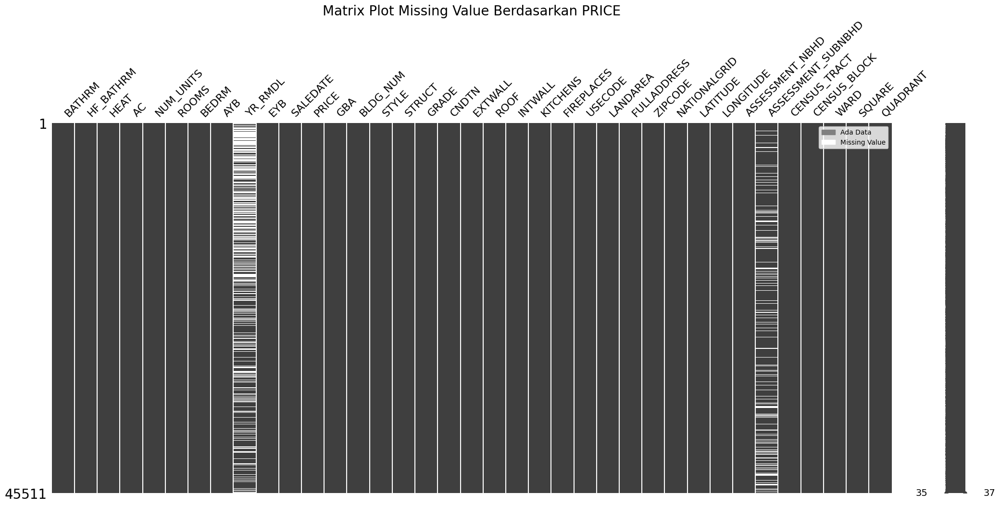

In [51]:
# Percobaan dengan missingness matrix berdasarkan kolom lain
msnosort(dfclean, 'PRICE')

In [52]:
# Melihat nilai unik YR_RMDL
nilaiunik = dfclean['YR_RMDL'].dropna().unique()
print(sorted(nilaiunik))

[1880.0, 1900.0, 1910.0, 1920.0, 1923.0, 1925.0, 1926.0, 1927.0, 1928.0, 1929.0, 1930.0, 1932.0, 1934.0, 1935.0, 1936.0, 1939.0, 1940.0, 1941.0, 1942.0, 1943.0, 1944.0, 1945.0, 1946.0, 1947.0, 1948.0, 1949.0, 1950.0, 1951.0, 1952.0, 1953.0, 1954.0, 1955.0, 1956.0, 1957.0, 1958.0, 1959.0, 1960.0, 1961.0, 1962.0, 1963.0, 1964.0, 1965.0, 1966.0, 1967.0, 1968.0, 1969.0, 1970.0, 1971.0, 1972.0, 1973.0, 1974.0, 1975.0, 1976.0, 1977.0, 1978.0, 1979.0, 1980.0, 1981.0, 1982.0, 1983.0, 1984.0, 1985.0, 1986.0, 1987.0, 1988.0, 1989.0, 1990.0, 1991.0, 1992.0, 1993.0, 1994.0, 1995.0, 1996.0, 1997.0, 1998.0, 1999.0, 2000.0, 2001.0, 2002.0, 2003.0, 2004.0, 2005.0, 2006.0, 2007.0, 2008.0, 2009.0, 2010.0, 2011.0, 2012.0, 2013.0, 2014.0, 2015.0, 2016.0, 2017.0, 2018.0, 2019.0]


Setelah dilakukan beberapa percobaan matrix missingness untuk mencari hubungan YR_RMDL dengan fitur lain, tidak ditemukan pola yang menggambarkan hubungan kolom dengan fitur lainnya. Setelah itu, dilakukan penelusuran terhadap raw data untuk menemukan faktor yang mempengaruhi missingness. Dari raw data dapat dilihat memang terdapat missing value. Secara domain knowledge, dapat diketahui tidak semua rumah dilakukan remodeling, sehingga dapat diasumsikan bahwa missing value menunjukkan rumah yang tidak melewati proses remodeling. Langkah yang akan dilakukan adalah dengan mengubah value menjadi kategorik dengan binning untuk mempermudah analisa dan modeling, dengan value sebagai berikut:

1. Value '0' menjadi 'No Remodeling'
2. <=1910
3. 1911 - 1940
4. 1941 - 1970
5. 1971 - 2000
6. Lebih dari 2000

Binning akan dilakukan pada tahap data preparation.

### ASSESSMENT_SUBNBHD

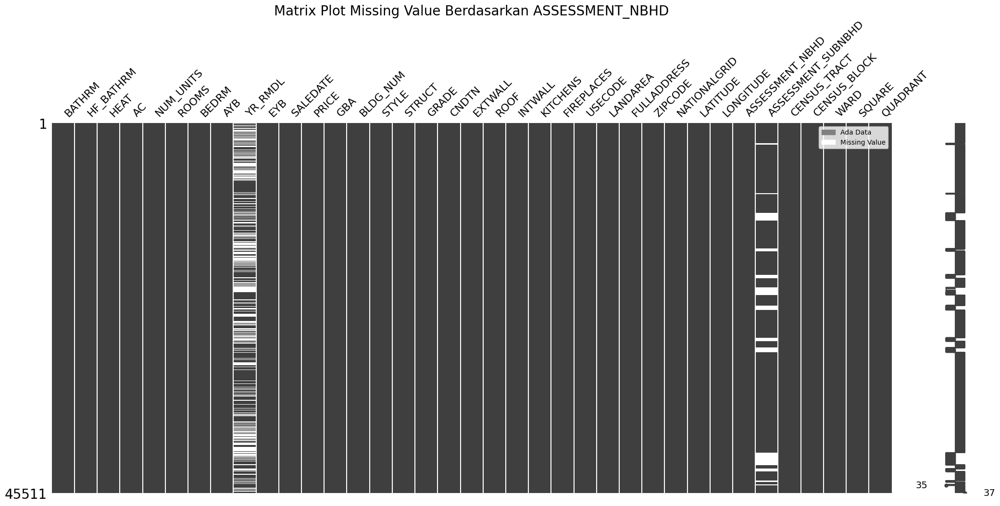

In [53]:
# Matrix missingnes berdasarkan sort kolom ASSESSMENT_NBHD
msnosort(dfclean, 'ASSESSMENT_NBHD')

In [54]:
# Melihat kolom ASSESSMENT_NBHD dan ASSESSMENT_SUBNBHD
dfclean[['ASSESSMENT_NBHD','ASSESSMENT_SUBNBHD']].sample(20)

,ASSESSMENT_NBHD,ASSESSMENT_SUBNBHD
3636,Capitol Hill,009 C Capitol Hill
13746,Old City 1,039 F Old City 1
47798,Columbia Heights,015 D Columbia Heights
102327,Anacostia,002 A Anacostia
44048,Mt. Pleasant,036 A Mt. Pleasant
30924,Chevy Chase,011 A Chevy Chase
2471,Old City 2,040 D Old City 2
75281,Woodridge,056 C Woodridge
106261,Congress Heights,016 C Congress Heights
21698,Glover Park,NaN


Dari matrix missingness berdasarkan sort kolom ASSESSMENT_NBHD atau neighborhood, diketahui terdapat pola pada missingness. Setelah ditelusuri lebih lanjut menggunakan sample, terlihat bahwa kolom ASSESSMENT_SUBNBHD merupakan neighborhood dengan detail nomor dan nama blok. Kolom ASSESSMENT_NBHD sudah mewakili informasi yang terkandung dalam ASSESSMENT_SUBNBHD. Namun, nomor dan blok bukan merupakan faktor yang berpengaruh terhadap harga rumah. Maka dari itu, akan dilakukan eliminasi terhadap kolom ASSESSMENT_SUBNBHD.

In [55]:
# Eliminasi kolom ASSESSMENT_SUBNBHD
dfclean.drop('ASSESSMENT_SUBNBHD',axis = 1, inplace = True)

## Data Type
Data type disesuaikan berdasarkan jenis variabel. Variabel numerik kualitatif akan diubah menjadi object dan variabel diskrit akan diubah menjadi integer. Selain itu SALEDATE akan disesuaikan.

In [56]:
# Melihat data type
dfclean.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 45511 entries, 0 to 106687
Data columns (total 36 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   BATHRM           45511 non-null  float64
 1   HF_BATHRM        45511 non-null  int64  
 2   HEAT             45511 non-null  object 
 3   AC               45511 non-null  object 
 4   NUM_UNITS        45511 non-null  float64
 5   ROOMS            45511 non-null  float64
 6   BEDRM            45511 non-null  float64
 7   AYB              45511 non-null  float64
 8   YR_RMDL          27564 non-null  float64
 9   EYB              45511 non-null  int64  
 10  SALEDATE         45511 non-null  object 
 11  PRICE            45511 non-null  float64
 12  GBA              45511 non-null  float64
 13  BLDG_NUM         45511 non-null  int64  
 14  STYLE            45511 non-null  object 
 15  STRUCT           45511 non-null  object 
 16  GRADE            45511 non-null  object 
 17  CNDTN      

### USECODE & ZIPCODE

In [57]:
# Mengubah USECODE dan ZIPCODE menjadi object
for i in ['USECODE','ZIPCODE']:
    dfclean[i] = dfclean[i].astype('object')
    dfclean[i].info()

<class 'pandas.core.series.Series'>
Int64Index: 45511 entries, 0 to 106687
Series name: USECODE
Non-Null Count  Dtype 
--------------  ----- 
45511 non-null  object
dtypes: object(1)
memory usage: 711.1+ KB
<class 'pandas.core.series.Series'>
Int64Index: 45511 entries, 0 to 106687
Series name: ZIPCODE
Non-Null Count  Dtype 
--------------  ----- 
45511 non-null  object
dtypes: object(1)
memory usage: 711.1+ KB


### CENSUS_BLOCK & CENSUS TRACT

In [58]:
# Mengubah CENSUS_BLOCK dan CENSUS_TRACT menjadi object
dfclean['CENSUS_BLOCK'] = dfclean['CENSUS_BLOCK'].str.replace(' ', '')
dfclean['CENSUS_BLOCK'] = dfclean['CENSUS_BLOCK'].astype('object')
dfclean['CENSUS_TRACT'] = dfclean['CENSUS_TRACT'].astype('object')
dfclean[['CENSUS_BLOCK','CENSUS_TRACT']].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 45511 entries, 0 to 106687
Data columns (total 2 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   CENSUS_BLOCK  45511 non-null  object
 1   CENSUS_TRACT  45511 non-null  object
dtypes: object(2)
memory usage: 1.0+ MB


### SALEDATE
Kolom SALEDATE berisi informasi tahun, bulan, dan tanggal penjualan terbaru. Tahun dan bulan dapat menunjukkan tren sehingga akan dibuat kolom baru yang terpisah, dan kolom SALEDATE akan dieliminasi.

In [59]:
# Mengubah SALEDATE menjadi datetime
dfclean['SALEDATE'] = pd.to_datetime(dfclean['SALEDATE'])
dfclean['SALEDATE'].info

<bound method Series.info of 0        2003-11-25
2        2016-06-21
3        2006-07-12
5        2010-02-26
7        2011-09-29
            ...    
106666   2012-12-21
106668   2005-03-01
106672   2002-12-23
106673   2002-08-28
106687   2004-02-10
Name: SALEDATE, Length: 45511, dtype: datetime64[ns]>

In [60]:
# Membuat kolom SALEYEAR dan SALEMONTH
dfclean['SALEYEAR'] = dfclean['SALEDATE'].dt.year
dfclean['SALEMONTH'] = dfclean['SALEDATE'].dt.month
# Eliminasi kolom SALEDATE
dfclean.drop('SALEDATE', axis = 1, inplace = True)

### AYB, BATHRM, NUM_UNITS, ROOMS, BEDRM, KITCHENS

In [61]:
# Mengubah tipe data menjadi integer
for i in ['AYB', 'BATHRM', 'NUM_UNITS', 'ROOMS', 'BEDRM', 'KITCHENS']:
    dfclean[i] = dfclean[i].astype('int64')


## Cek Data Type Keseluruhan

In [62]:
# Melihat tipe data
dfclean.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 45511 entries, 0 to 106687
Data columns (total 37 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   BATHRM           45511 non-null  int64  
 1   HF_BATHRM        45511 non-null  int64  
 2   HEAT             45511 non-null  object 
 3   AC               45511 non-null  object 
 4   NUM_UNITS        45511 non-null  int64  
 5   ROOMS            45511 non-null  int64  
 6   BEDRM            45511 non-null  int64  
 7   AYB              45511 non-null  int64  
 8   YR_RMDL          27564 non-null  float64
 9   EYB              45511 non-null  int64  
 10  PRICE            45511 non-null  float64
 11  GBA              45511 non-null  float64
 12  BLDG_NUM         45511 non-null  int64  
 13  STYLE            45511 non-null  object 
 14  STRUCT           45511 non-null  object 
 15  GRADE            45511 non-null  object 
 16  CNDTN            45511 non-null  object 
 17  EXTWALL    

## Data Anomaly
Sesuai dengan Data Understanding, data anomali yang akan ditindaklanjuti antara lain terdapat pada kolom AC, HEAT, STRUCT, STYLE, EXTWALL, INTWALL, AYB, EYB, dan YR_RMDL. Data anomali akan ditreatment sesuai dengan kebutuhan masing-masing kolom.

### AC

In [63]:
# Melihat kolom AC dengan value 0
dfclean[dfclean['AC']=='0'].head()

,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,PRICE,GBA,BLDG_NUM,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,FULLADDRESS,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,CENSUS_TRACT,CENSUS_BLOCK,WARD,SQUARE,QUADRANT,SALEYEAR,SALEMONTH
11541,2,0,Hot Water Rad,0,2,10,4,1909,NaN,1963,390000.0,1920.0,2,2 Story,Row End,Very Good,Average,Common Brick,Metal- Sms,Hardwood,2,0,15,1970,1101 EAST CAPITOL STREET SE,20003.0,18S UJ 27290 06352,38.889072,-76.991340,Old City 1,6700.0,0067002003,Ward 6,989,SE,1993,12
12050,3,0,Hot Water Rad,0,3,9,3,1905,2016.0,1960,950000.0,1304.0,1,1.5 Story Unfin,Row Inside,Good Quality,Good,Common Brick,Built Up,Hardwood,3,1,23,786,719 E STREET SE,20003.0,18S UJ 26918 05637,38.882563,-76.995447,Capitol Hill,7000.0,0070002012,Ward 6,903,SE,2016,1
12436,1,1,No Data,0,1,6,2,1910,2009.0,1964,588700.0,672.0,1,2 Story,Row Inside,Average,Good,Stucco,Neopren,Hardwood/Carp,1,0,11,660,246 10TH STREET NE,20002.0,18S UJ 27170 06829,38.893344,-76.992839,Old City 1,8100.0,0081002005,Ward 6,939,NE,2015,6
14048,2,0,Hot Water Rad,0,1,6,3,1916,1980.0,1969,210000.0,1746.0,1,2 Story,Row End,Good Quality,Average,Face Brick,Built Up,Hardwood,1,1,11,1466,503 11TH STREET SE,20003.0,18S UJ 27238 05622,38.882495,-76.991753,Capitol Hill,7000.0,0070002009,Ward 6,973,SE,2000,6
17539,2,0,Hot Water Rad,0,1,6,3,1917,1975.0,1957,119000.0,1140.0,1,2 Story,Row Inside,Above Average,Average,Common Brick,Built Up,Hardwood,1,1,11,1066,713 14TH STREET SE,20003.0,18S UJ 27757 05421,38.880782,-76.985728,Old City 1,6900.0,0069002009,Ward 6,1044,SE,2000,4


In [64]:
# Jumlah dan persentase baris dengan value 0 pada kolom AC
print(f'''Jumlah baris dengan value 0: {len(dfclean[dfclean['AC']=='0'])} 
Jumlah persentase dengan value 0: {round(len(dfclean[dfclean['AC']=='0'])/dfclean.shape[0]*100,3)}%''')

Jumlah baris dengan value 0: 9 
Jumlah persentase dengan value 0: 0.02%


In [65]:
# Melihat AC dengan value 0 berdasarkan GRADE properti
dfclean[dfclean['AC']=='0']['GRADE'].value_counts()

Good Quality     4
Above Average    3
Very Good        1
Average          1
Name: GRADE, dtype: int64

In [66]:
# Melihat modus kolom AC berdasarkan GRADE
for i in dfclean[dfclean['AC']=='0']['GRADE'].unique():
    display(dfclean[dfclean['GRADE']==i]['AC'].mode())

0    Y
Name: AC, dtype: object

0    Y
Name: AC, dtype: object

0    Y
Name: AC, dtype: object

0    Y
Name: AC, dtype: object

Value '0' merupakan data string, yang menunjukkan bahwa input data ditujukan untuk data kategorik kualitatif. Value lain (Y & N) merupakan data string yang bersifat kualitatif. Berdasarkan data di atas dapat dilihat bahwa value '0' terdapat pada baris dengan kategori GRADE 'Average', 'Above Average', 'Good Quality', dan 'Very Good'. Setelah dilihat modus pada masing-masing kategori tersebut, didapatkan value 'Y' yang juga merupakan modus kolom AC. Sehingga akan dilakukan Imputasi pada value '0' dengan modus tersebut pada tahap data preparation.

In [67]:
# Merubah value 0 menjadi NaN
dfclean['AC'] = dfclean['AC'].replace('0', np.nan)

### Heat

In [68]:
# Melihat kolom HEAT dengan value 'No Data'
dfclean['HEAT'].value_counts()

Forced Air        17963
Hot Water Rad     14998
Warm Cool         11600
Ht Pump             657
Water Base Brd       76
Wall Furnace         57
Elec Base Brd        50
Electric Rad         28
Air-Oil              26
Gravity Furnac       24
Evp Cool             11
Air Exchng            9
Ind Unit              7
No Data               5
Name: HEAT, dtype: int64

Terdapat data pada kolom HEAT dengan value 'No Data' sejumlah 5. Berdasarkan domain knowledge, semua rumah di Amerika Serikat memiliki heater. Hal itu disebabkan oleh musim dingin dimana rata-rata temperatur di Washington D.C. bisa mencapai di bawah 30 Fahrenheit atau di bawah 0 Celcius. Sehingga, salah satu langkah yang dapat dilakukan adalah mengganti 'No Data' menjadi heater yang paling sering digunakan.

In [69]:
# Melihat kolom HEAT dengan value No Data
dfclean[dfclean['HEAT']=='No Data']

,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,PRICE,GBA,BLDG_NUM,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,FULLADDRESS,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,CENSUS_TRACT,CENSUS_BLOCK,WARD,SQUARE,QUADRANT,SALEYEAR,SALEMONTH
2337,3,1,No Data,Y,2,9,4,1906,NaN,1969,271000.0,1712.0,1,2 Story,Row Inside,Good Quality,Good,Common Brick,Metal- Sms,Hardwood,2,1,24,1307,2033 13TH STREET NW,20009.0,18S UJ 24063 09627,38.917931,-77.029370,Old City 2,4400.0,0044001016,Ward 1,273,NW,2001,8
12436,1,1,No Data,NaN,1,6,2,1910,2009.0,1964,588700.0,672.0,1,2 Story,Row Inside,Average,Good,Stucco,Neopren,Hardwood/Carp,1,0,11,660,246 10TH STREET NE,20002.0,18S UJ 27170 06829,38.893344,-76.992839,Old City 1,8100.0,0081002005,Ward 6,939,NE,2015,6
45306,2,1,No Data,Y,1,12,4,1938,NaN,1963,783000.0,2166.0,1,2.5 Story Fin,Single,Very Good,Good,Common Brick,Slate,Hardwood,1,1,12,4888,1411 LOCUST ROAD NW,20012.0,18S UJ 23836 17208,38.986158,-77.033936,Shepherd Heights,1600.0,0016001011,Ward 4,2770,NW,2016,11
82723,1,0,No Data,N,1,5,2,1942,NaN,1943,82000.0,928.0,1,2 Story,Row Inside,Average,Average,Common Brick,Comp Shingle,Default,1,0,11,1152,3316 CLAY PLACE NE,20019.0,18S UJ 30114 06876,38.894342,-76.958928,Lily Ponds,9604.0,0096042008,Ward 7,5002,NE,2001,8
90141,1,1,No Data,N,1,7,3,1970,NaN,1977,349000.0,1315.0,1,Default,Semi-Detached,Average,Average,Brick/Siding,Built Up,Hardwood,1,0,13,2500,5318 JAY STREET NE,20019.0,18S UJ 33207 07611,38.901560,-76.923460,Deanwood,7807.0,0078072000,Ward 7,5205,NE,2018,1


In [70]:
# Persentase value No Data
len(dfclean[dfclean['HEAT']=='No Data'])/dfclean.shape[0]*100

0.010986354947155632

Dapat dilihat dari informasi di atas terdapat 5 baris data yang memiliki value 'No Data' atau sebesar 0.01%. Dikarenakan sedikitnya jumlah tersebut maka ubahan value tersebut tidak akan terlalu mengganggu distribusi data. Selain itu karena kolom HEAT merupakan kategorik, maka value 'No Data' akan diganti dengan modus sebagai central tendency pada tahap data preparation dengan simple imputer.

In [71]:
# Merubah value No Data menjadi NaN
dfclean['HEAT'] = dfclean['HEAT'].replace('No Data', np.nan)

### EXTWALL & INTWALL

In [72]:
# Melihat value pada kolom EXTWALL dan INTWALL
display(dfclean['EXTWALL'].value_counts(),dfclean['INTWALL'].value_counts())

Common Brick      34260
Brick/Siding       2869
Vinyl Siding       2287
Wood Siding        1748
Stucco             1287
Brick Veneer        478
Shingle             373
Face Brick          366
Brick/Stucco        342
Aluminum            318
Brick/Stone         314
Stone               295
Stone/Siding        174
Stone/Stucco        127
Stone Veneer        119
Hardboard            51
Concrete             30
Concrete Block       27
Stucco Block         20
Metal Siding         19
Default               5
Plywood               1
Adobe                 1
Name: EXTWALL, dtype: int64

Hardwood         35115
Hardwood/Carp     5956
Wood Floor        2918
Carpet            1395
Ceramic Tile        36
Lt Concrete         36
Default             25
Parquet              9
Vinyl Comp           7
Resiliant            6
Vinyl Sheet          5
Terrazo              3
Name: INTWALL, dtype: int64

In [73]:
# Persentase value Default
display(len(dfclean[dfclean['EXTWALL']=='Default'])/dfclean.shape[0]*100, len(dfclean[dfclean['INTWALL']=='Default'])/dfclean.shape[0]*100)

0.010986354947155632

0.05493177473577817

Dari data di atas dapat dilihat bahwa terdapat value 'Default' pada kolom EXTWALL dan INTWALL masing-masing sebesar 5 dan 25 (0.01% dan 0.05%). Salah satu cara yang bisa dilakukan untuk menangani value tersebut adalah dengan melihat fitur lain yang sekiranya memiliki korelasi dengan kolom EXTWALL dan INTWALL. Berdasarkan domain knowledge, material yang digunakan pada suatu properti dapat merefleksikan grade properti tersebut.

Terlihat bahwa jumlah data anomali tersebut juga tergolong cukup kecil (<1%), maka ubahan yang dilakukan tidak akan terlalu menganggu distribusi data. Selain itu, karena data anomali berupa data kategorik, 'Default' akan diganti dengan modus berdasarkan GRADE masing masing.

In [74]:
# Melihat value GRADE pada data yang memiliki value Default pada kolom EXTWALL dan INTWALL
display(dfclean[dfclean['EXTWALL']=='Default']['GRADE'].value_counts(), dfclean[dfclean['INTWALL']=='Default']['GRADE'].value_counts())

Good Quality     4
Above Average    1
Name: GRADE, dtype: int64

Average          15
Good Quality      4
Above Average     3
Excellent         2
Very Good         1
Name: GRADE, dtype: int64

In [75]:
# Melihat value Default pada kolom EXTWALL
for i in dfclean[dfclean['EXTWALL']=='Default']['GRADE'].unique():
    display(dfclean[dfclean['GRADE']==i]['EXTWALL'].mode())

0    Common Brick
Name: EXTWALL, dtype: object

0    Common Brick
Name: EXTWALL, dtype: object

In [76]:
# Melihat value Default pada kolom INTWALL
for i in dfclean[dfclean['INTWALL']=='Default']['GRADE'].unique():
    display(dfclean[dfclean['GRADE']==i]['INTWALL'].mode())


0    Hardwood
Name: INTWALL, dtype: object

0    Hardwood
Name: INTWALL, dtype: object

0    Hardwood
Name: INTWALL, dtype: object

0    Hardwood
Name: INTWALL, dtype: object

0    Hardwood
Name: INTWALL, dtype: object

Dapat dilihat bahwa modus untuk semua grade pada kolom EXTWALL merupakan 'Common Brick' dan pada kolom INTWALL merupakan 'Hardwood'. Akan digunakan simple imputer menggunakan modus masing-masing kolom pada data 'Default' di tahap data preparation.

In [77]:
# Merubah value Default menjadi NaN
dfclean['EXTWALL'] = dfclean['EXTWALL'].replace('Default', np.nan)
dfclean['INTWALL'] = dfclean['INTWALL'].replace('Default', np.nan)

### AYB & EYB

In [78]:
# Melihat AYB yang lebih besar dari EYB
dfclean[dfclean['AYB']>dfclean['EYB']]

,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,PRICE,GBA,BLDG_NUM,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,FULLADDRESS,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,CENSUS_TRACT,CENSUS_BLOCK,WARD,SQUARE,QUADRANT,SALEYEAR,SALEMONTH
5093,1,1,Forced Air,Y,1,5,2,1977,1985.0,1960,335000.0,1350.0,1,2 Story,Row Inside,Above Average,Average,Common Brick,Metal- Sms,Hardwood,1,1,11,1151,1425 CARROLLSBURG PLACE SW,20024.0,18S UJ 25625 04518,38.872228,-77.010062,Old City 1,6400.0,0064002001,Ward 6,655,SW,2005,5
13307,4,0,Hot Water Rad,N,4,12,4,1973,2001.0,1970,2025000.0,5656.0,1,4 Story,Row Inside,Good Quality,Average,Common Brick,Built Up,Hardwood,4,1,24,2852,21 8TH STREET NE,20002.0,18S UJ 27006 06519,38.890524,-76.994658,Capitol Hill,8100.0,0081003008,Ward 6,919,NE,2018,1
20477,3,1,Warm Cool,Y,1,9,3,2000,NaN,1999,2620000.0,2474.0,1,3 Story,Row Inside,Exceptional-B,Very Good,Common Brick,Built Up,Hardwood,1,3,11,2000,1231 28TH STREET NW,20007.0,18S UJ 21649 08386,38.906265,-77.056869,Georgetown,100.0,0001002006,Ward 2,1215,NW,2014,6
20478,4,1,Warm Cool,Y,1,10,6,2003,NaN,1999,2250000.0,3052.0,1,3 Story,Row End,Exceptional-B,Excellent,Common Brick,Metal- Sms,Hardwood,1,2,11,2400,1229 28TH STREET NW,20007.0,18S UJ 21648 08380,38.906211,-77.056877,Georgetown,100.0,0001002006,Ward 2,1215,NW,2003,9
20479,4,1,Warm Cool,Y,1,7,4,2003,NaN,1999,2095000.0,2060.0,1,2.5 Story Fin,Row End,Exceptional-B,Good,Common Brick,Metal- Sms,Hardwood,1,2,11,2000,2721 OLIVE STREET NW,20007.0,18S UJ 21683 08375,38.906227,-77.056488,Georgetown,100.0,0001002006,Ward 2,1215,NW,2015,7
22652,3,1,Warm Cool,Y,1,9,4,2000,NaN,1999,1325000.0,2474.0,1,3 Story,Row Inside,Exceptional-B,Very Good,Brick Veneer,Metal- Sms,Hardwood,1,1,11,2000,1235 28TH STREET NW,20007.0,18S UJ 21649 08398,38.906372,-77.056877,Georgetown,100.0,0001002006,Ward 2,1215,NW,2003,2
69854,2,1,Forced Air,Y,1,8,3,1995,NaN,1980,165000.0,1120.0,1,2 Story,Semi-Detached,Above Average,Average,Vinyl Siding,Comp Shingle,Wood Floor,1,0,13,3331,4732 6TH PLACE NE,20017.0,18S UJ 26885 12887,38.947851,-76.997661,Brookland,9509.0,0095093004,Ward 5,3796,NE,2002,2
89984,1,0,Hot Water Rad,N,1,4,2,1937,NaN,1936,120000.0,832.0,1,1 Story,Single,Fair Quality,Average,Vinyl Siding,Comp Shingle,Wood Floor,1,0,12,4600,5001 MEADE STREET NE,20019.0,18S UJ 32696 08101,38.905871,-76.929467,Deanwood,7806.0,0078061009,Ward 7,5174,NE,2003,7


In [79]:
# Melihat banyaknya data
len(dfclean[dfclean['AYB']>dfclean['EYB']])

8

In [80]:
# Persentase data anomali
len(dfclean[dfclean['AYB']>dfclean['EYB']])/dfclean.shape[0]*100

0.017578167915449014

Setelah melihat hasil dari pengecekkan tersebut, terdapat 8 data yang memiliki tahun bangun (AYB) lebih baru dibanding dengan tahun renovasi (EYB). Berdasarkan domain knowledge dari sumber data diketahui bahwa value tahun EYB memang harus lebih akhir dibandingkan value tahun AYB. Persentase data tersebut juga cukup kecil (0.01%). Oleh karena itu, data dengan value error tersebut akan dihapus.

In [81]:
# Menghapus data anomali pada kolom AYB dan EYB
idx = dfclean[dfclean['AYB']>dfclean['EYB']].index
dfclean.drop(idx, axis=0, inplace=True)

### YR_RMDL

In [82]:
# Melihat persentase value di atas 2018
len(dfclean[dfclean['YR_RMDL']>2018])/dfclean.shape[0]*100

0.002197657297321056

Terdapat 1 data dengan kolom di atas 2018, karena dataset dibuat pada tahun 2018 sehingga data tersebut diasumsikan merupakan kesalahan input. Karena persentase kecil sehingga langkah yang dilakukan adalah menghapus baris tersebut.

In [83]:
# Menghapus baris dengan value YR_RMDL di atas 2018
dfclean.drop(dfclean[dfclean['YR_RMDL']>2018].index, axis = 0, inplace = True)

In [84]:
# Melihat jumlah dan persentase data dengan YR_RMDL lebih besar dari EYB
print(len(dfclean[dfclean['AYB']>dfclean['YR_RMDL']]))
print(len(dfclean[dfclean['AYB']>dfclean['YR_RMDL']])/dfclean.shape[0]*100)

13
0.028570172739659793


Berdasarkan domain knowledge, tidak mungkin tahun properti dibangun lebih baru dibandingkan tahun properti direnovasi. Karena jumlah data dan persentase sedikit, sehingga data tersebut akan dieliminasi.

In [85]:
# Menghapus baris dengan AYB lebih besar dari YR_RMDL
dfclean.drop(dfclean[dfclean['AYB']>dfclean['YR_RMDL']].index, axis = 0, inplace = True)

### SALEYEAR & AYB

In [86]:
# Melihat kolom dengan AYB lebih besar dari SALEYEAR
dfclean[dfclean['AYB']>dfclean['SALEYEAR']]

,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,PRICE,GBA,BLDG_NUM,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,FULLADDRESS,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,CENSUS_TRACT,CENSUS_BLOCK,WARD,SQUARE,QUADRANT,SALEYEAR,SALEMONTH
1183,4,1,Forced Air,Y,2,10,6,2012,NaN,2014,405000.0,2980.0,1,2 Story,Row Inside,Above Average,Good,Common Brick,Built Up,Hardwood,2,0,23,2500,1816 6TH STREET NW,20001.0,18S UJ 24855 09254,38.914727,-77.020139,Old City 2,4801.0,0048011002,Ward 6,441,NW,2009,6
1253,4,1,Forced Air,Y,1,5,4,2012,NaN,2012,440000.0,4644.0,1,3 Story,Row Inside,Very Good,Very Good,Brick Veneer,Built Up,Hardwood,1,0,11,3371,917 T STREET NW,20001.0,18S UJ 24459 09375,38.915742,-77.024742,Old City 2,4400.0,0044002002,Ward 1,361,NW,2010,12
3352,6,0,Forced Air,Y,2,8,4,2017,NaN,2017,462340.0,3000.0,1,3 Story,Multi,Good Quality,Excellent,Common Brick,Metal- Sms,Hardwood,2,0,23,1600,1001 O STREET NW,20001.0,18S UJ 24317 08602,38.908753,-77.026178,Old City 2,4901.0,0049012014,Ward 2,338,NW,2016,5
3622,3,0,Forced Air,Y,1,10,2,2010,NaN,2013,737020.0,1692.0,1,3 Story,Row End,Good Quality,Very Good,Common Brick,Neopren,Hardwood,1,0,11,1027,932 4TH STREET SE,20003.0,18S UJ 26513 05218,38.878707,-77.000012,Old City 1,7200.0,0072001016,Ward 6,824,SE,2009,12
3623,2,1,Forced Air,Y,1,8,3,2010,NaN,2012,584155.0,1372.0,1,3 Story,Row Inside,Very Good,Very Good,Common Brick,Neopren,Hardwood,1,0,11,725,930 4TH STREET SE,20003.0,18S UJ 26513 05222,38.878748,-77.000010,Old City 1,7200.0,0072001016,Ward 6,824,SE,2009,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
101481,2,1,Warm Cool,Y,1,7,3,2004,NaN,2008,160496.0,1280.0,1,2 Story,Row End,Above Average,Very Good,Common Brick,Comp Shingle,Carpet,1,0,11,2031,2417 HILLSDALE PLACE SE,20020.0,18S UJ 27616 02812,38.857261,-76.986728,Randle Heights,7407.0,0074072011,Ward 8,5870,SE,2003,9
101483,2,2,Forced Air,Y,1,7,3,2005,NaN,2009,132500.0,1280.0,1,2 Story,Row Inside,Above Average,Very Good,Common Brick,Comp Shingle,Hardwood,1,0,11,1186,2411 HILLSDALE PLACE SE,20020.0,18S UJ 27630 02821,38.857318,-76.986605,Randle Heights,7407.0,0074072011,Ward 8,5870,SE,2004,2
102416,3,1,Warm Cool,Y,1,7,4,2013,NaN,2014,279900.0,1632.0,1,3 Story,Row End,Average,Very Good,Vinyl Siding,Comp Shingle,Hardwood/Carp,1,0,11,2257,1525 TANNER STREET SE,20020.0,18S UJ 28052 01690,38.847242,-76.981392,Randle Heights,7404.0,0074042010,Ward 8,5890,SE,2012,11
103646,2,2,Forced Air,Y,1,7,4,2002,NaN,2007,140790.0,1564.0,1,3 Story,Row Inside,Above Average,Excellent,Brick/Siding,Comp Shingle,Hardwood/Carp,1,0,11,1463,855 MONTERIA COURT SE,20032.0,18S UH 27204 99843,38.830439,-76.990698,Congress Heights,9700.0,0097002000,Ward 8,6159,SE,2001,12


In [87]:
# Melihat persentase
len(dfclean[dfclean['AYB']>dfclean['SALEYEAR']])/dfclean.shape[0]*100

0.31436171382092376

Dari data di atas, terdapat 143 data (0.31%) yang menunjukkan bahwa adanya transaksi properti yang dilakukan sebelum properti tersebut dibangun. Hal ini dianggap tidak wajar sehingga data tersebut akan dihapus.

In [88]:
# Menghapus data dengan dengan AYB lebih besar dari SALEYEAR
dfclean.drop(dfclean[dfclean['AYB']>dfclean['SALEYEAR']].index, axis = 0, inplace = True)

### STRUCT & STYLE

In [89]:
# Melihat default pada kolom STRUCT dan STYLE
display(dfclean['STRUCT'].value_counts(),dfclean['STYLE'].value_counts())

Row Inside       18859
Single           12631
Semi-Detached     6455
Row End           5465
Multi             1718
Town Inside        153
Town End            62
Default              3
Name: STRUCT, dtype: int64

2 Story            34539
3 Story             4503
2.5 Story Fin       3255
1 Story             1365
1.5 Story Fin        839
2.5 Story Unfin      301
4 Story              186
Split Level          132
Split Foyer           88
3.5 Story Fin         67
1.5 Story Unfin       41
Default               12
Bi-Level               8
3.5 Story Unfin        5
Vacant                 2
4.5 Story Unfin        2
4.5 Story Fin          1
Name: STYLE, dtype: int64

Karena jumlah data sedikit, mengganti value 'default' tidak mengubah proporsi secara signifikan. Data merupakan variabel kategorik maka akan digunakan simple imputer dengan modus masing-masing kolom pada tahap data preparation.

In [90]:
# Melakukan drop default menjadi nan
dfclean['STRUCT'] = dfclean['STRUCT'].replace('Default', np.nan)
dfclean['STYLE'] = dfclean['STYLE'].replace('Default', np.nan)

# Outlier

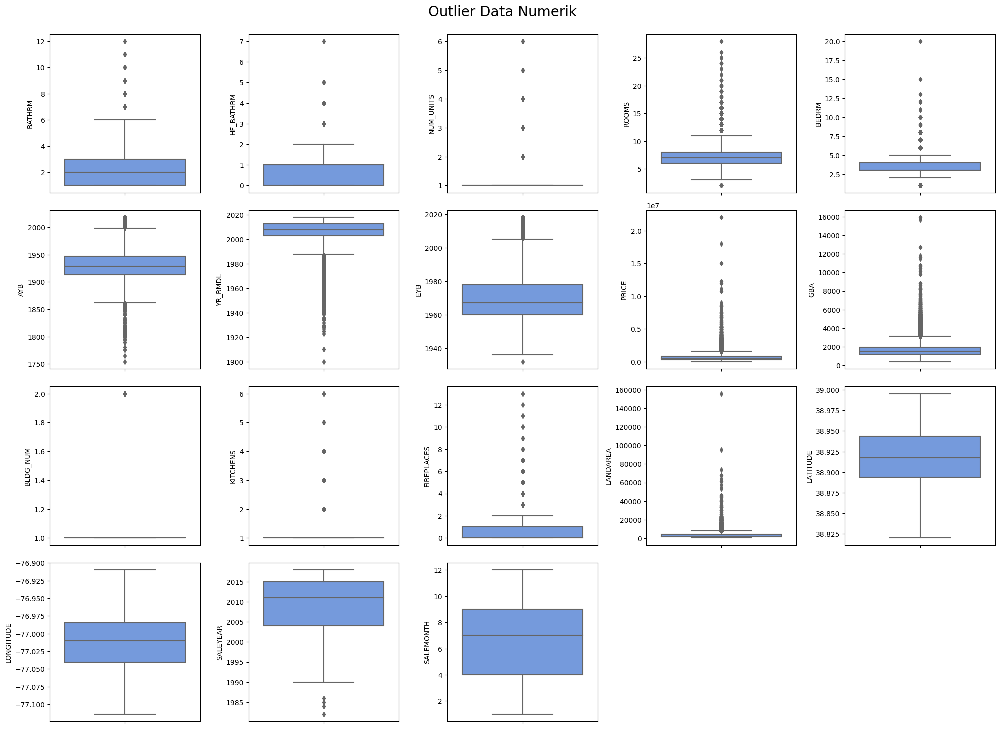

In [91]:
# Melihat distribusi data dengan boxplot
kolnum = dfclean.select_dtypes(exclude=object).columns
plt.figure(figsize=(20,18))
for i in range(0, len(kolnum)):
  plt.subplot(5, 5, i+1)
  sns.boxplot(y=dfclean[kolnum[i]], color='cornflowerblue', orient='v')
plt.suptitle('Outlier Data Numerik', size=20, y=1.0)
plt.tight_layout()
plt.show()

In [92]:
# Melihat lower bound, upper bound, outlier, dan persentase outlier
dfoutlier = []
for i in range(0, len(kolnum)):
    Q1 = dfclean[kolnum[i]].quantile(0.25)
    Q3 = dfclean[kolnum[i]].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound =  Q1 - (1.5 * IQR)
    upper_bound =  Q3 + (1.5 * IQR)
    condition = (dfclean[kolnum[i]]< lower_bound) | (dfclean[kolnum[i]]> upper_bound)
    outlier = dfclean.loc[condition, kolnum[i]].count()
    PersentaseOutlier = outlier/dfclean[kolnum[i]].count()*100
    dfoutlier.append([kolnum[i], outlier,round(upper_bound), round(lower_bound), round(PersentaseOutlier,2)])

dfout = pd.DataFrame(columns=['Kolom','Jumlah Outlier', 'Upper Bound', 'Lower Bound', 'Persentase'],
                     data=dfoutlier)
dfout

,Kolom,Jumlah Outlier,Upper Bound,Lower Bound,Persentase
0,BATHRM,96,6,-2,0.21
1,HF_BATHRM,121,2,-2,0.27
2,NUM_UNITS,6199,1,1,13.67
3,ROOMS,2585,11,3,5.70
4,BEDRM,2306,6,2,5.09
5,AYB,3860,1998,1862,8.51
6,YR_RMDL,2682,2028,1988,9.74
7,EYB,3692,2005,1933,8.14
8,PRICE,2019,1565000,-475000,4.45
9,GBA,2736,3117,85,6.03


Dari data di atas, sesuai dengan domain knowledge, data diskrit wajar memiliki outlier. Untuk data kontinu juga wajar memiliki outlier karena tingginya variansi data. Kolom PRICE, GBA, dan LANDAREA akan dilakukan analisa lebih lanjut untuk memahami outlier.

### PRICE

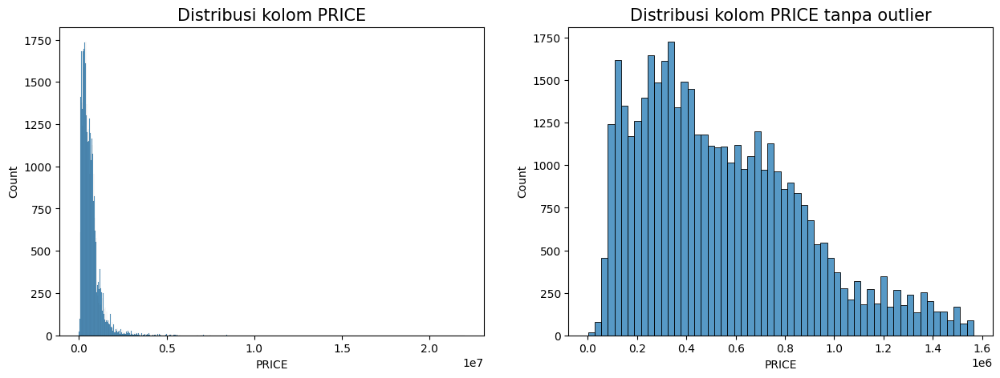

In [93]:
# Melihat distribusi kolom price
plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
plt.title('Distribusi kolom PRICE', fontsize=15)
sns.histplot(x=dfclean['PRICE'])
plt.subplot(1,2,2)
sns.histplot(x=dfclean[dfclean['PRICE']<1565000]['PRICE'])
plt.title('Distribusi kolom PRICE tanpa outlier', fontsize=15)
plt.show()

In [94]:
# Melihat 5 rumah dengan harga terendah
dfclean.sort_values('PRICE').head()

,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,PRICE,GBA,BLDG_NUM,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,FULLADDRESS,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,CENSUS_TRACT,CENSUS_BLOCK,WARD,SQUARE,QUADRANT,SALEYEAR,SALEMONTH
43281,2,0,Hot Water Rad,N,1,5,2,1921,NaN,1954,250.0,1440.0,1,2 Story,Row Inside,Average,Average,Common Brick,Metal- Sms,Hardwood,1,0,11,1489,1416 OAK STREET NW,20010.0,18S UJ 23746 11418,38.934000,-77.033475,Columbia Heights,2801.0,0028011001,Ward 1,2684,NW,1999,10
48414,2,0,Forced Air,N,1,8,5,1908,1988.0,1960,250.0,2281.0,1,3 Story,Row Inside,Good Quality,Average,Common Brick,Metal- Sms,Wood Floor,1,0,11,2417,1326 IRVING STREET NW,20010.0,18S UJ 23975 10790,38.928385,-77.030679,Columbia Heights,3000.0,0030002001,Ward 1,2849,NW,1999,11
97510,2,2,Warm Cool,Y,1,7,3,1999,NaN,2005,4850.0,1200.0,1,2 Story,Semi-Detached,Above Average,Good,Brick/Siding,Comp Shingle,Hardwood/Carp,1,0,13,3335,2721 KNOX TERRACE SE,20020.0,18S UJ 29258 02326,38.853205,-76.967661,Randle Heights,7502.0,0075022006,Ward 8,5728,SE,1999,1
86711,2,0,Hot Water Rad,N,2,8,4,1953,NaN,1953,7425.0,1184.0,1,2 Story,Multi,Average,Average,Common Brick,Metal- Sms,Hardwood,2,0,23,2500,1012 48TH STREET NE,20019.0,18S UJ 32298 07878,38.903787,-76.934004,Deanwood,7806.0,0078062014,Ward 7,5154,NE,1998,2
67355,1,1,Forced Air,N,1,5,2,1922,NaN,1954,10400.0,1080.0,1,2 Story,Row Inside,Average,Average,Common Brick,Metal- Sms,Hardwood,1,0,11,1115,232 ASCOT PLACE NE,20002.0,18S UJ 26418 09906,38.920912,-77.002283,Brookland,9203.0,0092032008,Ward 5,3557,NE,2000,3


Diketahui terdapat outlier pada kolom PRICE dengan nilai PRICE di atas $1565000 berdasarkan nilai upperbound. Setelah ditelusuri lebih lanjut terkait fitur dan kondisi properti, pemerintah menyatakan bahwa harga properti tersebut masih dalam kategori wajar dimana data ini merupakan data yang Qualified. Sehingga untuk outlier di atas upperbound akan tetap digunakan untuk model machine learning dengan menggunakan metrik evaluasi yang tidak sensitif terhadap outlier.

Selain itu dapat dilihat bahwa distribusi kolom PRICE right skewed, sehingga nilai lower bound -475000. Oleh karena itu, untuk batas bawah akan dianalisa berdasarkan domain knowledge. Terdapat beberapa rumah dengan harga rendah, dimana fitur dan kondisi tidak sesuai dengan harga rumah-rumah tersebut. Dari grafik distribusi di atas, dapat dilihat terdapat perbedaan jumlah kelompok harga yang cukup signifikan. Akan dilihat berdasarkan kelompoknya dengan harga di bawah 200000 dibagi menjadi 8 kelompok dengan range harga yang sama.

In [95]:
# Melihat distribusi data di bawah 200000
dfclean[dfclean['PRICE']<=200000]['PRICE'].value_counts(bins=8).sort_index()

(50.249, 25218.75]         17
(25218.75, 50187.5]        71
(50187.5, 75156.25]       315
(75156.25, 100125.0]     1069
(100125.0, 125093.75]    1375
(125093.75, 150062.5]    1371
(150062.5, 175031.25]    1163
(175031.25, 200000.0]    1150
Name: PRICE, dtype: int64

Dapat dilihat terdapat perbedaan jumlah data yang signifikan berdasarkan kelompok harga, yaitu pada kelompok harga diantara 50187.5 - 75156.25 berjumlah 315, sedangkan pada kelompok harga 75156.25 - 100125.0 berjumlah 1069. Sehingga batas bawah yang diambil yaitu rumah dengan harga $75156.25, dan data dengan harga di bawah harga tersebut akan dihapus.

In [96]:
# Menghapus data dengan harga dibahwa 75156.25
dfclean.drop(dfclean[dfclean['PRICE']<75156.25].index, axis = 0, inplace = True)

### LAND AREA & GBA

In [97]:
# Melihat 5 nilai tertinggi pada kolom GBA 
dfclean.sort_values('GBA', ascending = False).head()

,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,PRICE,GBA,BLDG_NUM,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,FULLADDRESS,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,CENSUS_TRACT,CENSUS_BLOCK,WARD,SQUARE,QUADRANT,SALEYEAR,SALEMONTH
38696,9,2,Warm Cool,Y,1,22,8,2001,2010.0,2013,7500000.0,15902.0,1,2 Story,Single,Exceptional-B,Very Good,Stucco,Built Up,Hardwood,1,8,12,33405,2600 ROCK CREEK DRIVE NW,20008.0,18S UJ 21764 09967,38.920523,-77.055960,Massachusetts Avenue Heights,400.0,0004002023,Ward 3,2140,NW,2007,10
34527,9,5,Forced Air,Y,2,25,7,1994,NaN,2012,18000000.0,15673.0,1,2.5 Story Fin,Single,Exceptional-D,Excellent,Common Brick,Slate,Hardwood,2,5,12,35240,3107 FESSENDEN STREET NW,20008.0,18S UJ 21109 13760,38.954550,-77.064497,Forest Hills,1301.0,0013012008,Ward 3,2277,NW,2015,12
36674,12,3,Warm Cool,Y,1,19,9,2008,NaN,2016,12250000.0,12713.0,1,2 Story,Single,Exceptional-D,Excellent,Stone/Stucco,Concrete Tile,Ceramic Tile,2,4,12,16525,2221 30TH STREET NW,20008.0,18S UJ 21493 09883,38.919714,-77.059062,Massachusetts Avenue Heights,400.0,0004002011,Ward 3,2198,NW,2015,10
37921,6,2,Forced Air,Y,1,11,6,1962,2005.0,2001,2425000.0,11810.0,1,2 Story,Single,Superior,Good,Stone,Built Up,Hardwood,1,4,12,73771,2901 FESSENDEN STREET NW,20008.0,18S UJ 21636 13809,38.955104,-77.058430,Forest Hills,1301.0,0013012000,Ward 3,2272,NW,2001,11
37118,11,1,Warm Cool,Y,1,26,7,1986,2014.0,2010,15000000.0,11616.0,1,2 Story,Single,Exceptional-D,Excellent,Stone,Neopren,Hardwood,2,5,12,23541,2501 30TH STREET NW,20008.0,18S UJ 21508 09938,38.920213,-77.058898,Massachusetts Avenue Heights,400.0,0004002012,Ward 3,2199,NW,2006,5


In [98]:
# Melihat 5 nilai tertinggi pada kolom LANDAREA 
dfclean.sort_values('LANDAREA', ascending = False).head()

,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,PRICE,GBA,BLDG_NUM,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,FULLADDRESS,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,CENSUS_TRACT,CENSUS_BLOCK,WARD,SQUARE,QUADRANT,SALEYEAR,SALEMONTH
20685,6,5,Warm Cool,Y,1,17,9,1801,2013.0,1986,22000000.0,10110.0,1,2.5 Story Fin,Single,Exceptional-C,Good,Common Brick,Slate,Hardwood,2,4,12,155905,1623 28TH STREET NW,20007.0,18S UJ 21685 08985,38.911670,-77.056612,Georgetown,100.0,0001001000,Ward 2,1285,NW,2011,7
35548,8,0,Ht Pump,Y,1,14,8,1910,2001.0,1983,2700000.0,6699.0,1,3 Story,Single,Superior,Good,Stone,Slate,Hardwood,1,4,12,95370,2800 UPTON STREET NW,20008.0,18S UJ 21815 12333,38.941848,-77.055985,Forest Hills,1302.0,0013023005,Ward 3,2238,NW,2003,6
37921,6,2,Forced Air,Y,1,11,6,1962,2005.0,2001,2425000.0,11810.0,1,2 Story,Single,Superior,Good,Stone,Built Up,Hardwood,1,4,12,73771,2901 FESSENDEN STREET NW,20008.0,18S UJ 21636 13809,38.955104,-77.058430,Forest Hills,1301.0,0013012000,Ward 3,2272,NW,2001,11
26462,5,3,Forced Air,Y,1,17,8,1930,2002.0,1998,2300000.0,6814.0,1,3 Story,Single,Exceptional-B,Very Good,Common Brick,Slate,Hardwood,1,3,12,67727,4926 GLENBROOK ROAD NW,20016.0,18S UJ 18149 11716,38.935533,-77.098092,Spring Valley,901.0,0009013026,Ward 3,1517,NW,1992,12
22961,6,2,Warm Cool,Y,1,16,5,1931,2007.0,1998,5225000.0,6230.0,1,2.5 Story Fin,Single,Exceptional-A,Very Good,Common Brick,Comp Shingle,Hardwood,1,6,12,64205,2400 FOXHALL ROAD NW,20007.0,18S UJ 18813 10223,38.922226,-77.090048,Berkley,801.0,0008012008,Ward 3,1382,NW,2017,11


Berdasarkan boxplot, GBA dan LANDAREA memiliki variansi yang tinggi sehingga terdapat outlier. Selain itu terdapat extreme outlier pada kolom GBA dan LANDAREA. Namun extreme outlier tersebut masih dinilai wajar dan juga setelah ditelusuri berdasarkan koordinatnya memiliki nilai yang sesuai. Maka dari itu data dengan extreme outlier tidak akan ditindaklanjuti untuk sekarang.

# Data Preparation & Feature Engineering
Selanjutnya akan dibuat 2 data untuk digunakan pada tahap Data Analytics dan tahap Machine Learning (Modeling). Pertama, kolom price sebagai target akan dipindahkan menjadi kolom terakhir.

In [99]:
dfclean.shape

(44943, 37)

In [100]:
# Memindahkan kolom PRICE
price_col = dfclean.pop(item='PRICE')
dfclean.insert(36, 'PRICE' ,price_col)
dfclean.head()

,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,GBA,BLDG_NUM,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,FULLADDRESS,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,CENSUS_TRACT,CENSUS_BLOCK,WARD,SQUARE,QUADRANT,SALEYEAR,SALEMONTH,PRICE
0,4,0,Warm Cool,Y,2,8,4,1910,1988.0,1972,2522.0,1,3 Story,Row Inside,Very Good,Good,Common Brick,Metal- Sms,Hardwood,2,5,24,1680,1748 SWANN STREET NW,20009.0,18S UJ 23061 09289,38.914680,-77.040832,Old City 2,4201.0,0042012006,Ward 2,152,NW,2003,11,1095000.0
2,3,1,Hot Water Rad,Y,2,9,5,1910,2009.0,1984,2522.0,1,3 Story,Row Inside,Very Good,Very Good,Common Brick,Built Up,Hardwood,2,4,24,1680,1744 SWANN STREET NW,20009.0,18S UJ 23074 09289,38.914684,-77.040678,Old City 2,4201.0,0042012006,Ward 2,152,NW,2016,6,2100000.0
3,3,1,Hot Water Rad,Y,2,8,5,1900,2003.0,1984,2484.0,1,3 Story,Row Inside,Very Good,Good,Common Brick,Built Up,Hardwood,2,3,24,1680,1742 SWANN STREET NW,20009.0,18S UJ 23078 09288,38.914683,-77.040629,Old City 2,4201.0,0042012006,Ward 2,152,NW,2006,7,1602000.0
5,3,2,Hot Water Rad,Y,1,10,5,1913,NaN,1972,5344.0,1,4 Story,Row Inside,Very Good,Good,Common Brick,Built Up,Hardwood,1,4,11,2196,1709 S STREET NW,20009.0,18S UJ 23157 09248,38.914331,-77.039715,Old City 2,4201.0,0042012006,Ward 2,152,NW,2010,2,1950000.0
7,3,1,Hot Water Rad,Y,2,8,4,1906,2011.0,1972,2401.0,1,3 Story,Row Inside,Very Good,Average,Common Brick,Metal- Sms,Hardwood,2,1,24,1627,1746 1/2 T STREET NW,20009.0,18S UJ 23124 09368,38.915408,-77.040129,Old City 2,4201.0,0042012005,Ward 2,152,NW,2011,9,1050000.0


In [101]:
# Melakukan Reset Index 
dfclean.reset_index(inplace = True)
dfclean.drop('index',axis = 1, inplace = True)
dfclean.head()

,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,GBA,BLDG_NUM,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,FULLADDRESS,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,CENSUS_TRACT,CENSUS_BLOCK,WARD,SQUARE,QUADRANT,SALEYEAR,SALEMONTH,PRICE
0,4,0,Warm Cool,Y,2,8,4,1910,1988.0,1972,2522.0,1,3 Story,Row Inside,Very Good,Good,Common Brick,Metal- Sms,Hardwood,2,5,24,1680,1748 SWANN STREET NW,20009.0,18S UJ 23061 09289,38.914680,-77.040832,Old City 2,4201.0,0042012006,Ward 2,152,NW,2003,11,1095000.0
1,3,1,Hot Water Rad,Y,2,9,5,1910,2009.0,1984,2522.0,1,3 Story,Row Inside,Very Good,Very Good,Common Brick,Built Up,Hardwood,2,4,24,1680,1744 SWANN STREET NW,20009.0,18S UJ 23074 09289,38.914684,-77.040678,Old City 2,4201.0,0042012006,Ward 2,152,NW,2016,6,2100000.0
2,3,1,Hot Water Rad,Y,2,8,5,1900,2003.0,1984,2484.0,1,3 Story,Row Inside,Very Good,Good,Common Brick,Built Up,Hardwood,2,3,24,1680,1742 SWANN STREET NW,20009.0,18S UJ 23078 09288,38.914683,-77.040629,Old City 2,4201.0,0042012006,Ward 2,152,NW,2006,7,1602000.0
3,3,2,Hot Water Rad,Y,1,10,5,1913,NaN,1972,5344.0,1,4 Story,Row Inside,Very Good,Good,Common Brick,Built Up,Hardwood,1,4,11,2196,1709 S STREET NW,20009.0,18S UJ 23157 09248,38.914331,-77.039715,Old City 2,4201.0,0042012006,Ward 2,152,NW,2010,2,1950000.0
4,3,1,Hot Water Rad,Y,2,8,4,1906,2011.0,1972,2401.0,1,3 Story,Row Inside,Very Good,Average,Common Brick,Metal- Sms,Hardwood,2,1,24,1627,1746 1/2 T STREET NW,20009.0,18S UJ 23124 09368,38.915408,-77.040129,Old City 2,4201.0,0042012005,Ward 2,152,NW,2011,9,1050000.0


Untuk pembuatan model machine learning, akan dilakukan beberapa proses persiapan antara lain:

1. Binning
Dibuat binning pada kolom `YR_MDL` berdasarkan urutan rentang tahun remodeling, yaitu mengubah data numerik kontinu menjadi kategorik ordinal.

In [102]:
# Membuat binning pada kolom YR_RMDL
def BinningTahun (Tahun): 
    if Tahun <= 1910: 
        return "<=1910"
    elif (Tahun > 1910) & (Tahun <= 1940):
        return "1911-1940"
    elif (Tahun > 1940) & (Tahun <= 1970):
        return "1941-1970"
    elif (Tahun > 1970) & (Tahun <= 2000):
        return "1971-2000"
    elif Tahun > 2000:
        return ">2000"
    else: 
        return "No Remodeling"
    
dfclean["YR_RMDL"] = dfclean["YR_RMDL"].apply(lambda Tahun: BinningTahun(Tahun))
dfclean["YR_RMDL"].head()

0        1971-2000
1            >2000
2            >2000
3    No Remodeling
4            >2000
Name: YR_RMDL, dtype: object

dfAnalytics akan digunakan untuk tahap analisa data, sedangkan dfModel akan digunakan pada tahap Machine Learning.

In [103]:
# Membuat dataframe baru
dfAnalytics = dfclean.copy()
dfModel = dfclean.copy()

2. Menghapus kolom `FULLADDRESS`, `NATIONALGRID`, `ASSESSMENT_NBHD`, `CENSUS_TRACT`, `CENSUS_BLOCK` dan `SQUARE`, karena memiliki kardinalitas yang tinggi, selain itu informasi dari data terkait lokasi sudah direpresentasikan oleh kolom `ZIPCODE`, `LONGITUDE`, `LATITTUDE`, `WARD`, dan `QUADRANT`.

3. Membuat SimpleImputer dengan modus pada kolom `AC`, `HEAT`, `EXTWALL`, dan `INTWALL`

4. Melakukan One Hot Encoding pada kolom `AC` dan `QUADRANT`, karena kolom memiliki value yang sedikit dan tidak memiliki tingkatan tertentu

5. Melakukan Ordinal Encoding pada kolom `YR_RMDL`, `GRADE`, dan `CNDTN`, karena memiliki value yang bertingkat, urutan tingkatan akan disesuaikan menggunakan ordinal mapping

6. Melakukan Binary Encoding pada kolom `ZIPCODE`, `WARD`, `USECODE`, `HEAT`, `STYLE`, `STRUCT`, `EXTWALL`, `ROOF`, dan `INTWALL`, karena merupakan kolom yang bersifat kualitatif, memiliki value unique yang banyak (lebih dari 6), dan tidak memiliki tingkatan tertentu

7. Membuat transformer dengan SimpleImputer dan Encoding untuk persiapan modeling

In [104]:
# Menghapus kolom yang tidak dibutuhkan
dfModel = dfModel.drop(['FULLADDRESS','NATIONALGRID','ASSESSMENT_NBHD','CENSUS_TRACT', 'CENSUS_BLOCK','SQUARE'], axis = 1)
dfModel.head()

,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,GBA,BLDG_NUM,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,ZIPCODE,LATITUDE,LONGITUDE,WARD,QUADRANT,SALEYEAR,SALEMONTH,PRICE
0,4,0,Warm Cool,Y,2,8,4,1910,1971-2000,1972,2522.0,1,3 Story,Row Inside,Very Good,Good,Common Brick,Metal- Sms,Hardwood,2,5,24,1680,20009.0,38.914680,-77.040832,Ward 2,NW,2003,11,1095000.0
1,3,1,Hot Water Rad,Y,2,9,5,1910,>2000,1984,2522.0,1,3 Story,Row Inside,Very Good,Very Good,Common Brick,Built Up,Hardwood,2,4,24,1680,20009.0,38.914684,-77.040678,Ward 2,NW,2016,6,2100000.0
2,3,1,Hot Water Rad,Y,2,8,5,1900,>2000,1984,2484.0,1,3 Story,Row Inside,Very Good,Good,Common Brick,Built Up,Hardwood,2,3,24,1680,20009.0,38.914683,-77.040629,Ward 2,NW,2006,7,1602000.0
3,3,2,Hot Water Rad,Y,1,10,5,1913,No Remodeling,1972,5344.0,1,4 Story,Row Inside,Very Good,Good,Common Brick,Built Up,Hardwood,1,4,11,2196,20009.0,38.914331,-77.039715,Ward 2,NW,2010,2,1950000.0
4,3,1,Hot Water Rad,Y,2,8,4,1906,>2000,1972,2401.0,1,3 Story,Row Inside,Very Good,Average,Common Brick,Metal- Sms,Hardwood,2,1,24,1627,20009.0,38.915408,-77.040129,Ward 2,NW,2011,9,1050000.0


### Multicollinearity

Multicollinearity meningkatkan varians pada koefisien regresi yang dapat mempengaruhi standar error model machine learning. Multicollinearity yang dapat mempengaruhi model adalah ketika nilai koefisien korelasi lebih dari 0.8

Text(0.5, 1.0, 'Correlation Matrix')

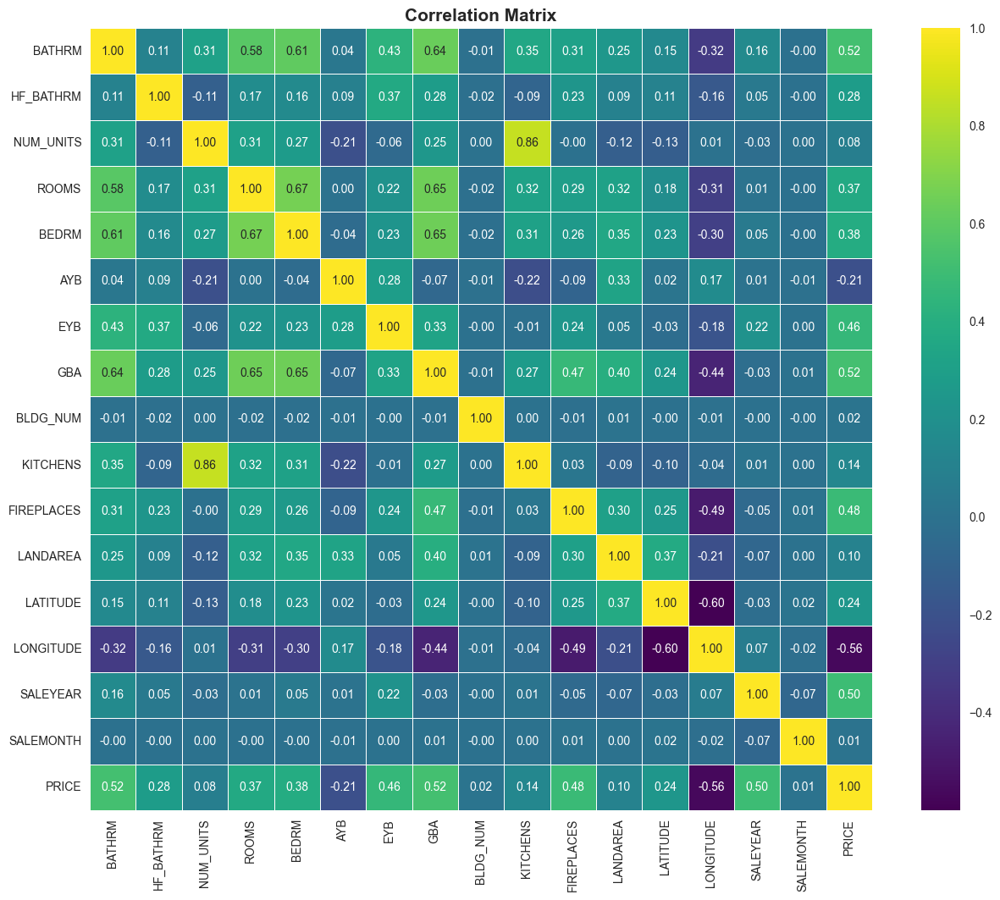

In [164]:
# Melihat multicolinearity pada dataset
plt.figure(figsize=(15, 12))
palette=sns.diverging_palette(20, 220, n=256)
corr = dfModel.corr(method='spearman')
sns.heatmap(corr, annot=True, fmt='.2f', cmap='viridis', square=True, linewidths=.5)
plt.title('Correlation Matrix', size=15, weight='bold')

Terdapat korelasi tinggi dengan nilai 0.86 pada kolom `KITCHENS` dan `NUM_UNITS`. Berdasarkan domain knowledge, 2 kolom tersebut memiliki informasi yang dibutuhkan untuk prediksi. Dapat dilihat juga terdapat beberapa nilai korelasi kecil terhadap target, langkah yang dilakukan adalah menindaklanjuti pada tahap feature selection.

### Encoding

In [105]:
# Ordinal mapping
ordinal_mapping = [
    {'col':'YR_RMDL',
    'mapping':{'No Remodeling' : 0,
    '<=1910' : 1,
    '1911-1940' : 2,
    '1941-1970' : 3,
    '1971-2000' : 4,
    '>2000' : 5,
    }},
    {'col':'GRADE',
    'mapping':{'Low Quality' : 0,
    'Fair Quality' : 1,
    'Average' : 2,
    'Above Average' : 3,
    'Good Quality' : 4,
    'Very Good' : 5,
    'Excellent' : 6,
    'Superior' : 7,
    'Exceptional-A' :8,
    'Exceptional-B' : 9,
    'Exceptional-C' : 10,
    'Exceptional-D' :11,
    }}, 
    {'col':'CNDTN',
    'mapping':{'Poor' : 0,
    'Fair' : 1,
    'Average' : 2,
    'Good' : 3,
    'Very Good' : 4,
    'Excellent' : 5,
    }}
]


In [106]:
# Melihat jumlah baris dan kolom data analisa
dfAnalytics.shape

(44943, 37)

In [107]:
# Melihat jumlah baris dan kolom data modeling
dfModel.shape

(44943, 31)

In [118]:
# Transformer
PipelineOHE = Pipeline([('simpleimputer', SimpleImputer(strategy='most_frequent')),
                        ('onehot', OneHotEncoder(drop='first'))])

PipelineBinary = Pipeline([('simpleimputer', SimpleImputer(strategy='most_frequent')),
                        ('binary', ce.BinaryEncoder())])

transformer = ColumnTransformer([
    ('onehot', PipelineOHE, ['AC','QUADRANT']),
    ('ordinal', ce.OrdinalEncoder(mapping= ordinal_mapping), ['YR_RMDL','GRADE','CNDTN']),
    ('binary', PipelineBinary, ['ZIPCODE', 'WARD', 'USECODE','HEAT', 'STYLE', 'STRUCT', 'EXTWALL', 'ROOF', 'INTWALL'])
], remainder='passthrough') 

### Spiitting Data

8. Melakukan splitting data, yaitu 80% data yang digunakan sebagai data train dan 20% yang digunakan sebagai data test

In [120]:
# Melakukan pemisahan feature x dan target y
x = dfModel.drop(columns=['PRICE'])
y = dfModel['PRICE']

In [121]:
# Melakukan splitting data train 80% dan data test 20%
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.2,random_state=0)

In [122]:
# Melihat data setelah encoding
testing = pd.DataFrame(transformer.fit_transform(x_train),columns=list(transformer.transformers_[0][1].get_feature_names_out())+ transformer.transformers_[1][1].get_feature_names()+transformer.transformers_[2][1][1].get_feature_names()+['BATHRM', 'HF_BATHRM', 'NUM_UNITS', 'ROOMS', 'BEDRM', 'AYB', 'EYB', 'GBA', 'BUILDING_NUM', 'KITCHENS', 'FIREPLACES', 'LANDAREA', 'LATITUDE', 'LONGITUDE', 'SALEYEAR', 'SALEMONTH'])
testing

,AC_Y,QUADRANT_NW,QUADRANT_SE,QUADRANT_SW,YR_RMDL,GRADE,CNDTN,0_0,0_1,0_2,0_3,0_4,1_0,1_1,1_2,1_3,2_0,2_1,2_2,2_3,3_0,3_1,3_2,3_3,4_0,4_1,4_2,4_3,5_0,5_1,5_2,6_0,6_1,6_2,6_3,6_4,7_0,7_1,7_2,7_3,7_4,8_0,8_1,8_2,8_3,BATHRM,HF_BATHRM,NUM_UNITS,ROOMS,BEDRM,AYB,EYB,GBA,BUILDING_NUM,KITCHENS,FIREPLACES,LANDAREA,LATITUDE,LONGITUDE,SALEYEAR,SALEMONTH
0,1.0,0.0,0.0,0.0,5.0,2.0,4.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,2.0,1.0,1.0,6.0,2.0,1952.0,1982.0,1184.0,1.0,1.0,0.0,1200.0,38.906837,-76.979868,2018.0,2.0
1,1.0,1.0,0.0,0.0,0.0,2.0,3.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,6.0,3.0,1925.0,1964.0,1560.0,1.0,1.0,0.0,1689.0,38.948959,-77.020344,2005.0,3.0
2,1.0,1.0,0.0,0.0,0.0,4.0,3.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,2.0,1.0,1.0,7.0,5.0,1937.0,1969.0,2498.0,1.0,1.0,2.0,5431.0,38.970737,-77.069310,2015.0,10.0
3,1.0,1.0,0.0,0.0,5.0,4.0,3.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,7.0,0.0,3.0,11.0,7.0,1910.0,1986.0,4464.0,1.0,3.0,3.0,2598.0,38.933751,-77.029420,2013.0,2.0
4,1.0,1.0,0.0,0.0,5.0,6.0,2.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,3.0,1.0,1.0,9.0,5.0,1920.0,1975.0,2136.0,1.0,1.0,1.0,5155.0,38.958161,-77.073869,2011.0,11.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35949,1.0,0.0,0.0,0.0,0.0,5.0,5.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,2.0,1.0,1.0,8.0,3.0,2016.0,2017.0,1730.0,1.0,1.0,1.0,822.0,38.931000,-76.997045,2017.0,5.0
35950,1.0,1.0,0.0,0.0,5.0,5.0,3.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,4.0,0.0,1.0,9.0,4.0,1951.0,1975.0,2232.0,1.0,1.0,2.0,7338.0,38.988689,-77.045215,2004.0,9.0
35951,1.0,0.0,1.0,0.0,0.0,3.0,4.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,2.0,1.0,1.0,7.0,3.0,2011.0,2013.0,1536.0,1.0,1.0,0.0,3058.0,38.854898,-76.983903,2011.0,3.0
35952,1.0,0.0,1.0,0.0,0.0,4.0,4.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,3.0,1.0,1.0,7.0,4.0,2008.0,2014.0,2108.0,1.0,1.0,1.0,5455.0,38.842831,-76.980422,2014.0,7.0


# Data Analysis
Setelah dilakukan EDA dan Data Preprocessing, selanjutnya akan dilakukan analisa untuk memahami harga properti berdasarkan karakteristiknya.

## Price

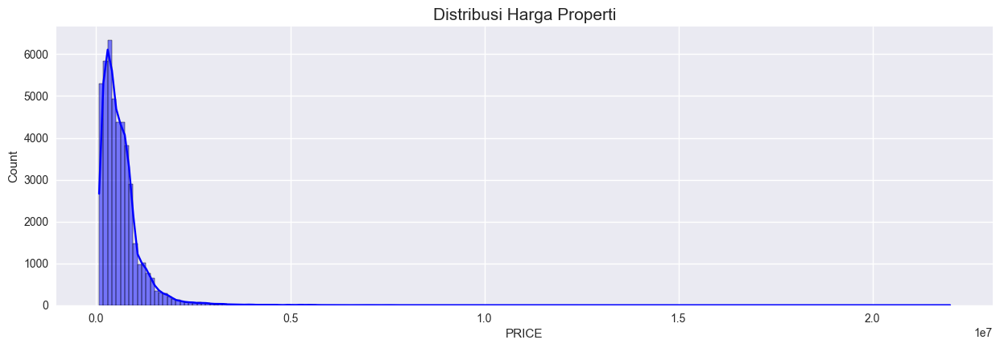

In [148]:
# Melihat distribusi kolom PRICE
plt.style.use('seaborn')
plt.figure(figsize=(15,4.5))
sns.histplot(dfAnalytics['PRICE'],kde=True,color='Blue', bins=200)
plt.title('Distribusi Harga Properti', fontsize=15)
plt.show()

In [124]:
# Median kolom PRICE
print(f'''Median harga properti DC: {round(dfAnalytics['PRICE'].median(),2)}''')

Median harga properti DC: 515000.0


Median harga properti DC: 515000.0
Distribusi harga properti Washington D.C. right skewed atau tidak normal, sehingga central tendency yang digunakan adalah median. Hal di atas menunjukkan bahwa mayoritas penduduk di Washington D.C. membeli properti di kisaran median harga $515000.00. Right skewed dapat terjadi karena terdapat sedikit jumlah properti yang sangat mahal dan hanya sedikit orang yang mampu membeli rumah dengan harga tersebut.

Selanjutnya akan dilihat matrix korelasi antar fitur variabel kuantitatif dengan target (harga) untuk mengetahui seberapa kuat hubungan antar variabel. Karena distribusi tidak normal, sehingga akan digunakan Uji Spearman.

Text(0.5, 1.0, 'Correlation Matrix')

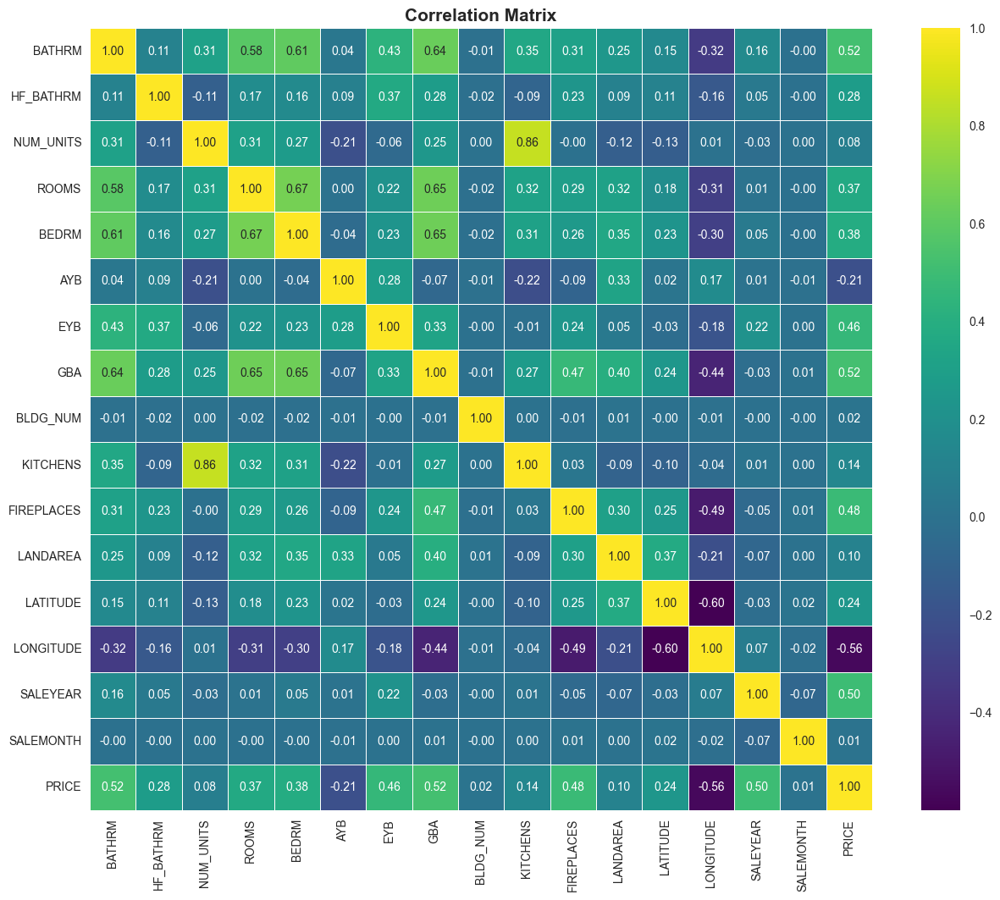

In [165]:
# Korelasi Matrix Spearman
plt.figure(figsize=(15, 12))
palette=sns.diverging_palette(20, 220, n=256)
corr = dfAnalytics.corr(method='spearman')
sns.heatmap(corr, annot=True, fmt='.2f', cmap='viridis', square=True, linewidths=.5)
plt.title('Correlation Matrix', size=15, weight='bold')

Pada heatmap di atas, akan diamati kategori dengan koefisien korelasi di atas 0,4. Koefisien 0,4 sampai 0,6 menandakan kategori memiliki korelasi yang sedang, 0,6 sampai 0,8 menandakan korelasi yang cukup kuat, 0,8 sampai 1 menandakan korelasi yang sangat kuat. Untuk lebih jelasnya dapat dilihat disini.

Dapat diketahui beberapa hal antara lain:

1. Variabel BATHRM, EYB, GBA, FIREPLACES, dan SALEYEAR memiliki korelasi positif yang sedang terhadap target.
2. Variabel LONGITUDE memiliki korelasi negatif yang sedang terhadap target, hal ini menunjukkan bahwa lokasi mempengaruhi harga dengan arah yang berlawanan, dimana semakin kecil longitude harga properti semakin mahal.
3. Terdapat korelasi positif dan negatif yang kecil pada beberapa variabel terhadap target seperti NUM_UNITS, BLDG_NUM, dan SALEMONTH.

## Price based on Trend

### SALEYEAR

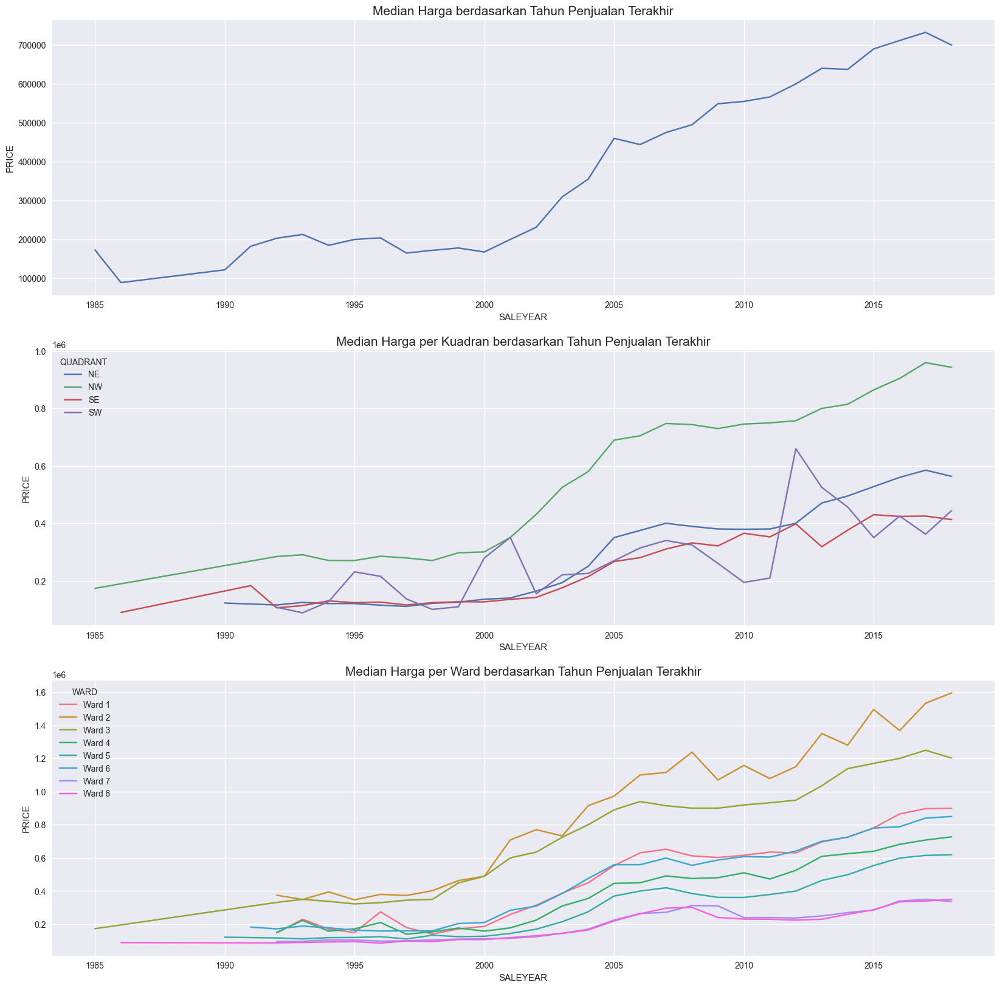

<Figure size 1500x1000 with 0 Axes>

In [123]:
# Trend harga berdasarkan tahun penjualan
yearly_med = dfAnalytics.groupby('SALEYEAR').median('PRICE')
yearly_quad = dfAnalytics.groupby(['QUADRANT', 'SALEYEAR']).median('PRICE')
yearly_ward = dfAnalytics.groupby(['WARD', 'SALEYEAR']).median('PRICE')
plt.style.use('seaborn')
fig, axes = plt.subplots(3,1, figsize=(20,20))
plt.figure(figsize=(15,10))
sns.lineplot(data=yearly_med, x='SALEYEAR', y='PRICE', ax=axes[0]).set_title('Median Harga berdasarkan Tahun Penjualan Terakhir', size=15)
sns.lineplot(data=yearly_quad, x='SALEYEAR', y='PRICE', hue='QUADRANT', ax=axes[1]).set_title('Median Harga per Kuadran berdasarkan Tahun Penjualan Terakhir', size=15)
sns.lineplot(data=yearly_ward, x='SALEYEAR', y='PRICE', hue='WARD', ax=axes[2]).set_title('Median Harga per Ward berdasarkan Tahun Penjualan Terakhir', size=15)
plt.show()

In [111]:
# Melihat tahun dengan median harga tertinggi
dfAnalytics.groupby('SALEYEAR').median('PRICE').sort_values('PRICE', ascending = False).head(1)

,BATHRM,HF_BATHRM,NUM_UNITS,ROOMS,BEDRM,AYB,EYB,GBA,BLDG_NUM,KITCHENS,FIREPLACES,LANDAREA,LATITUDE,LONGITUDE,SALEMONTH,PRICE
SALEYEAR,,,,,,,,,,,,,,,,
2017,2.0,1.0,1.0,7.0,3.0,1929.0,1968.0,1508.0,1.0,1.0,0.0,2115.5,38.915676,-77.003835,7.0,732500.0


Dari grafik di atas dapat diketahui beberapa hal, antara lain:

1. Dari tahun ke tahun, median harga penjualan properti rumah cenderung naik. Hal ini dikarenakan beberapa hal seperti inflasi dan meningkatnya demand yang melebihi properti yang tersedia. Dapat diketahui median harga tertinggi yaitu pada tahun 2017 dengan harga $732500. Kenaikan harga yang sangat tinggi di Washington D.C., diakibatkan karena prospek kawasan tersebut, dimana terdapat tingginya tingkat pendidikan dan pendapatan, selain itu didorong oleh sedikitnya jumlah properti.
2. Quadrant dengan tren median harga tertinggi berada pada kawasan NW atau NorthWest yang merupakan Central Business District(CBD), dimana CBD merupakan area dengan aksesibilitas tertinggi ditambah memiliki variasi dan konsentrasi barang dan jasa khusus yang lebih besar daripada area lainnya (Murphy). Sedangkan pada kawasan SW atau SouthWest memiliki median harga yang tidak stabil dan kurang kompetitif. Pada masing-masing Quadrant berisi dari beberapa gabungan Ward, sehingga akan dilihat tren median harga tiap Ward.
3. Dapat dilihat tren median harga pada masing-masing Ward cenderung meningkat dan garis tren yang lebih stabil. Sehingga Ward dapat digunakan untuk lebih memahami pasar properti. Ward dengan tren median harga tertinggi yaitu Ward 2 dan Ward 3.

### Salemonth

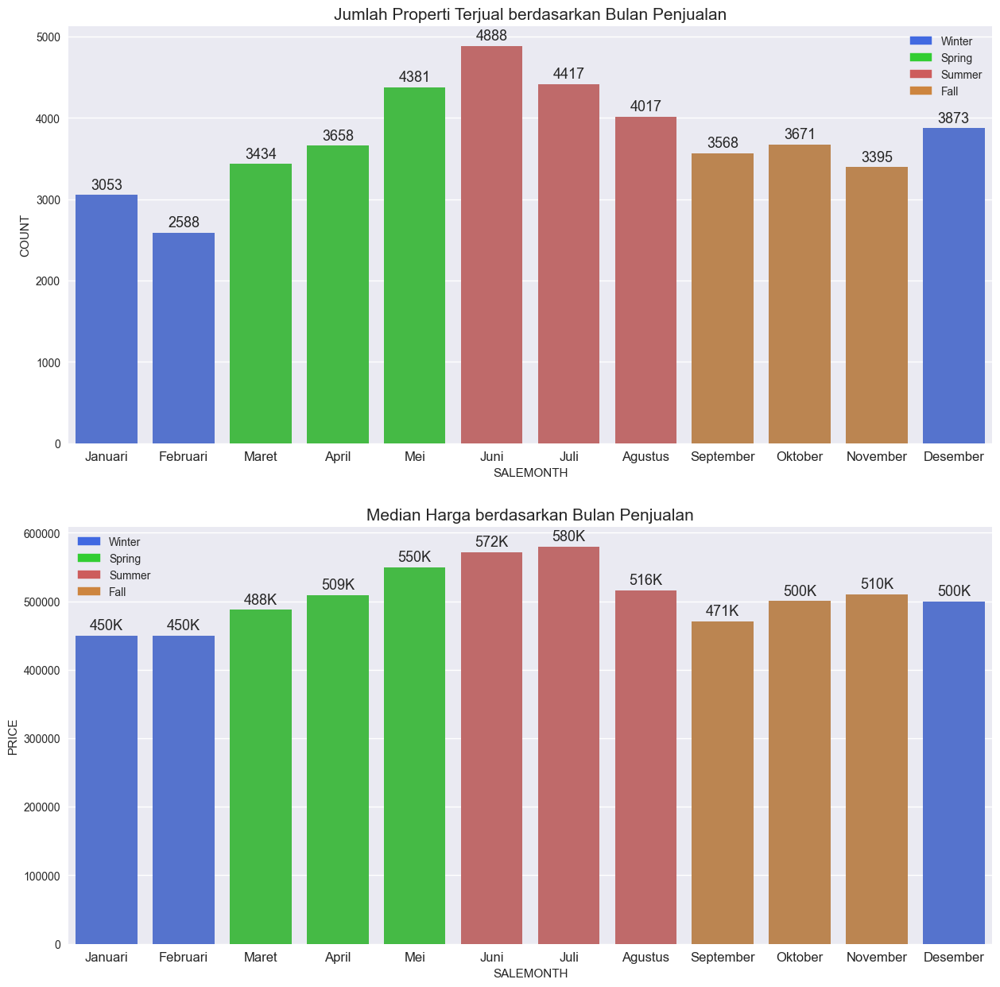

<Figure size 1500x1100 with 0 Axes>

In [160]:
# Trend harga berdasarkan bulan penjualan
monthlymed = dfAnalytics.groupby('SALEMONTH')['PRICE'].median().reset_index()
monthlycount = dfAnalytics.groupby('SALEMONTH')['PRICE'].count().reset_index().rename(columns={'PRICE':'COUNT'})
palette_month = {
   1 : 'royalblue',
   2 : 'royalblue',
   3 : 'limegreen',
   4 : 'limegreen',
   5 : 'limegreen',
   6 : 'indianred',
   7 : 'indianred',
   8 : 'indianred',
   9 : 'peru',
   10 : 'peru',
   11 : 'peru',
   12 : 'royalblue'
}
month_name = ['Januari', 'Februari', 'Maret', 'April', 'Mei', 'Juni', 'Juli', 'Agustus', 'September', 'Oktober', 'November', 'Desember']
winter = mpatches.Patch(color='royalblue', label='Winter')
spring = mpatches.Patch(color='limegreen', label='Spring')
summer = mpatches.Patch(color='indianred', label='Summer')
fall = mpatches.Patch(color='peru', label='Fall')
plt.style.use('seaborn')
fig, axes = plt.subplots(2,1, figsize=(15,15))
plt.figure(figsize=(15,11))
count_bar = sns.barplot(data=monthlycount, x ='SALEMONTH', y = 'COUNT',ax=axes[0], palette=palette_month)
for bar in count_bar.patches:
    count_bar.annotate(format(bar.get_height(), '.0f'), 
                   (bar.get_x() + bar.get_width() / 2., bar.get_height()), 
                   ha = 'center', va = 'center', 
                   xytext = (0, 9), size=13,
                   textcoords = 'offset points')
med_bar = sns.barplot(data=monthlymed, x='SALEMONTH', y='PRICE', ax=axes[1], palette=palette_month)
for bar in med_bar.patches:
    med_bar.annotate(format(bar.get_height()/1000, '.0f') + 'K', 
                   (bar.get_x() + bar.get_width() / 2., bar.get_height()), 
                   ha = 'center', va = 'center', 
                   xytext = (0, 9), size=13,
                   textcoords = 'offset points')
axes[0].set_title('Jumlah Properti Terjual berdasarkan Bulan Penjualan', size=15)
axes[1].set_title('Median Harga berdasarkan Bulan Penjualan', size=15)
axes[0].set_xticklabels(month_name, size=12)
axes[1].set_xticklabels(month_name, size=12)
axes[0].legend(handles=[winter, spring, summer, fall])
axes[1].legend(handles=[winter, spring, summer, fall])
plt.show()

Dari grafik di atas diketahui bahwa bulan Januari memiliki nilai median harga terendah sedangkan bulan Juli memiliki median harga tertinggi. Pola yang hampir sama didapatkan dari jumlah penjualan properti. Dengan demand properti yang tinggi, maka median harga juga semakin meningkat. Dapat diketahui pasar di Amerika dipengaruhi oleh bulan dan musim, dimana pada musim dingin yaitu bulan Desember sampai Februari memiliki nilai harga terendah yang merupakan waktu para pengusaha real estate menurunkan intensitas penjualan karena holiday season. Market residential real estate mulai kembali aktif di musim semi dari bulan Maret sampai Mei, dan median harga dan jumlah properti memuncak dengan demand terbanyak pada musim panas yaitu bulan Juni sampai Agustus. Dengan mengetahui tren bulan, agen real estate company dapat membantu customer menyarankan waktu beli terbaik.

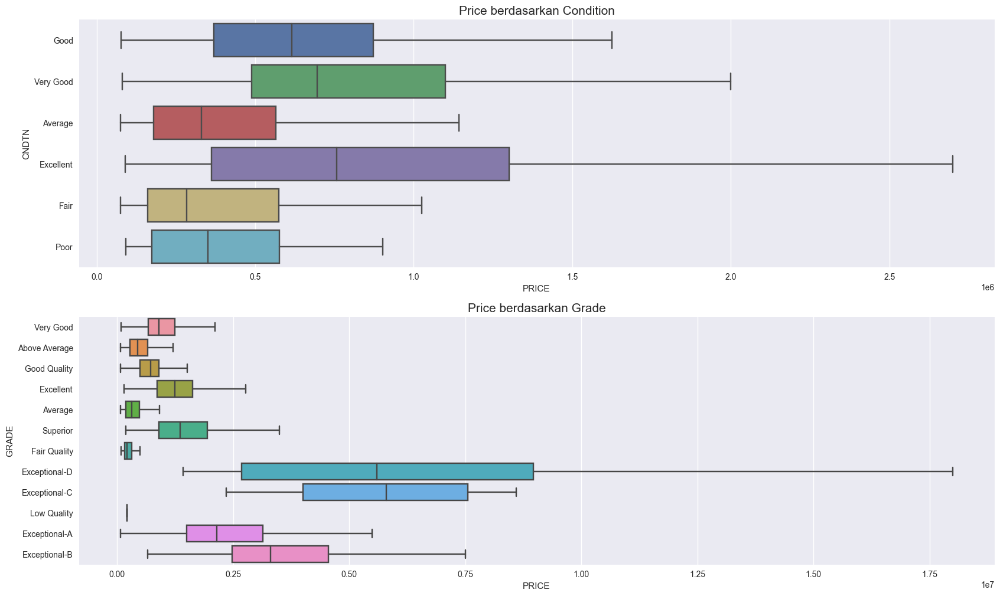

In [113]:
# Melihat distribusi PRICE berdasarkan CONDITION dan GRADE
plt.style.use('seaborn')
fig, axes = plt.subplots(2,1, figsize=(20,12))
sns.boxplot(x= dfAnalytics['PRICE'], y=dfAnalytics['CNDTN'], ax=axes[0], showfliers = False).set_title('Price berdasarkan Condition', size=15 )
sns.boxplot(x= dfAnalytics['PRICE'], y=dfAnalytics['GRADE'], ax=axes[1], showfliers = False).set_title('Price berdasarkan Grade', size=15)
plt.show()

Dari boxplot di atas dapat diketahui beberapa hal, yaitu:

1. Pada variabel 'Condition', range harga pada kondisi 'Poor', 'Fair', dan 'Average' memiliki perbedaan harga yang tidak signifikan. Sedangkan pada 'Good', 'Very Good' dan 'Excellent' menunjukkan distribusi harga yang cukup berbeda.
2. Terjadi hal yang sama pada variabel 'Grade' dimana perbedaan signifikan hanya terjadi pada properti dengan grade di atas 'Superior'.
3. Dapat dilihat bahwa semakin tinggi kondisi dan grade suatu properti, maka semakin tinggi harganya.

Untuk memastikan asumsi tersebut, akan dilakukan Uji Statistik Kruskal-Wallis karena data tidak memiliki distribusi normal. Kruskal-Wallis digunakan untuk mengetahui apabila terdapat perbedaan pada kelompok variabel Qualitatif (lebih dari 2 kelompok) berdasarkan median harga. H0 menunjukkan bahwa tidak ada perbedaan kelompok variabel Qualitative independen berdasarkan variabel Quantitative dependen. Sedangkan Ha atau Tolak H0 menunjukkan tidak terdapat cukup bukti bahwa tidak adanya perbedaan pada variabel independen Qualitative berdasarkan variabel dependen Quantitative. H0 diterima ketika hasil P-Value dari uji tersebut lebih dari 0.05, dan H0 ditolak ketika hasil P-Value kurang dari sama dengan 0.05. Ketika H0 ditolak menunjukkan terdapat hubungan antara variabel independen dengan variabel dependen.

In [126]:
# Kruskal-Wallis test pada CNDTN dan GRADE terhadap PRICE
kruskaltest(dfAnalytics,'CNDTN')
kruskaltest(dfAnalytics,'GRADE')

Result of CNDTN
H stat: 7444.423567903828
P-value: 0.0
Result of GRADE
H stat: 17039.67581617188
P-value: 0.0


Berdasarkan hasil test Kruskal-Wallis, diketahui bahwa masing-masing kolom mendapatkan nilai P-value di bawah 0.05 (Menolak H0). Hal ini menyatakan bahwa pada kedua fitur tersebut terbukti bahwa median harga properti tiap kelompok berbeda.

In [114]:
# Melihat sebaran PRICE berdasarkan lokasi
fig = px.scatter_mapbox(dfAnalytics[dfAnalytics['PRICE']<1656000], lat='LATITUDE', lon='LONGITUDE', color='PRICE', hover_data=['PRICE', 'ASSESSMENT_NBHD','WARD', 'QUADRANT'],
                        color_discrete_sequence=px.colors.qualitative.Safe, zoom=9.5, height=500, width=700, opacity=0.5,
                        title='Distribusi Harga DC Residential Properties')
fig.update_traces(marker=dict(size=2.5))
fig.update_layout(mapbox_style='carto-darkmatter',margin=dict(l=10,r=0,t=40,b=10))
fig.show()


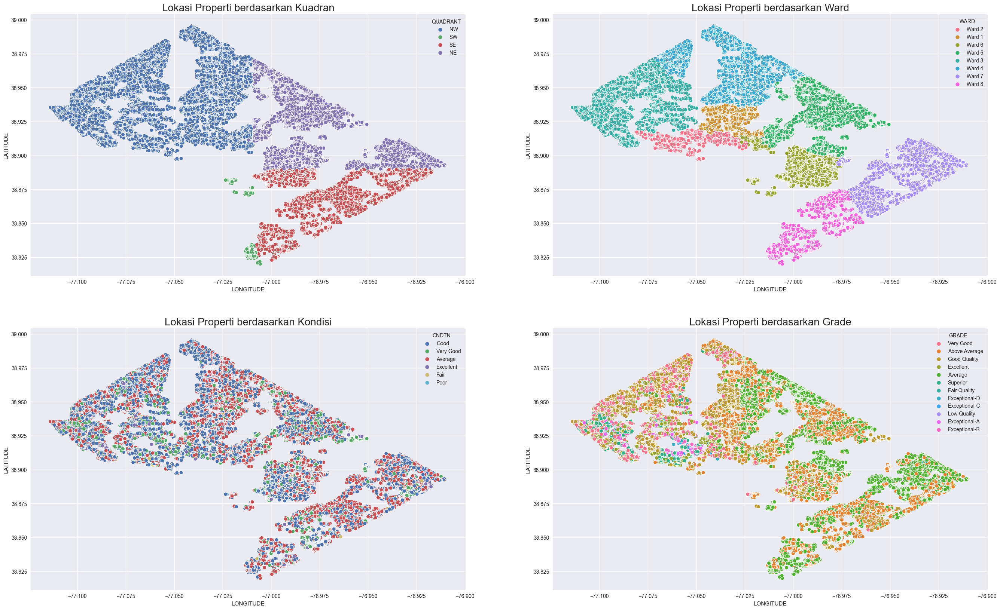

In [115]:
# Melihat Quadrant Ward Condition dan Grade berdasarkan koordinat lokasi
fig, axes = plt.subplots(2,2, figsize=(33,20))
sns.scatterplot(data=dfAnalytics, x='LONGITUDE', y='LATITUDE', hue='QUADRANT', ax=axes[0][0]).set_title('Lokasi Properti berdasarkan Kuadran',size=20)
sns.scatterplot(data=dfAnalytics, x='LONGITUDE', y='LATITUDE', hue='WARD', ax=axes[0][1]).set_title('Lokasi Properti berdasarkan Ward',size=20)
sns.scatterplot(data=dfAnalytics, x='LONGITUDE', y='LATITUDE', hue='CNDTN', ax=axes[1][0]).set_title('Lokasi Properti berdasarkan Kondisi',size=20)
sns.scatterplot(data=dfAnalytics, x='LONGITUDE', y='LATITUDE', hue='GRADE', ax=axes[1][1]).set_title('Lokasi Properti berdasarkan Grade',size=20)
plt.show()

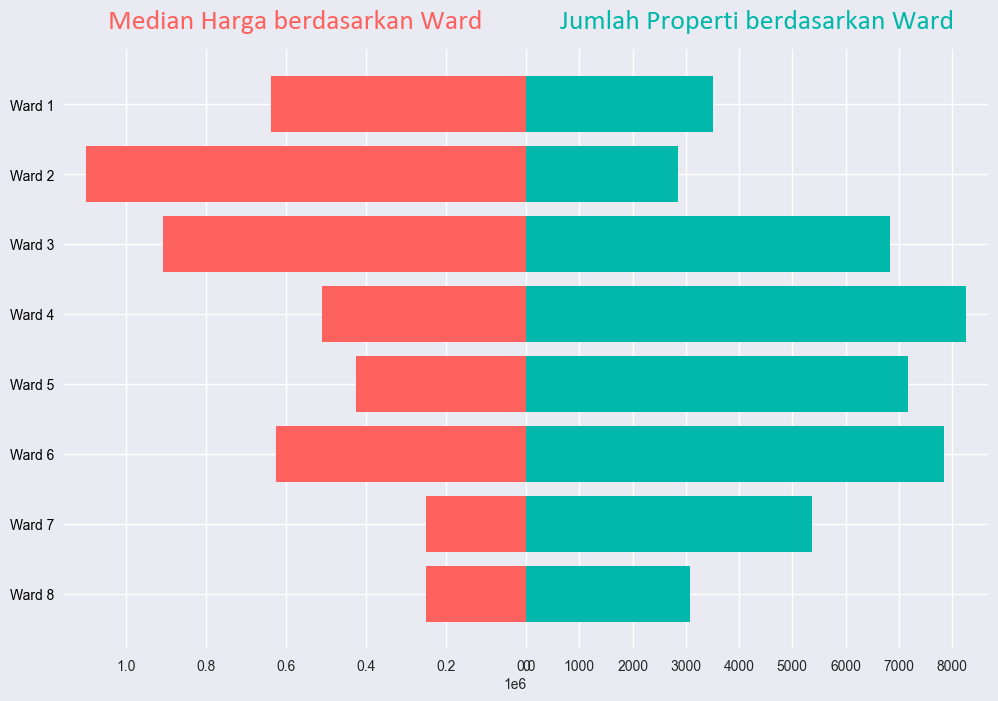

In [168]:
# Melihat median harga dan jumlah properti berdasarkan WARD dan QUADRANT
price_ward = dfAnalytics.groupby('WARD')['PRICE'].median().reset_index()
count_ward = dfAnalytics.groupby('WARD')['PRICE'].count().reset_index().rename(columns={'PRICE':'COUNT'})
df_ward = pd.merge(price_ward, count_ward, on='WARD')
df_ward.set_index('WARD', inplace = True)

font_color = '#525252'
hfont = {'fontname':'Calibri'}
facecolor = '#eaeaf2'
color_red = '#fd625e'
color_blue = '#01b8aa'
index = df_ward.index
column0 = df_ward['PRICE']
column1 = df_ward['COUNT']
titlemed = 'Median Harga berdasarkan Ward'
titlecount = 'Jumlah Properti berdasarkan Ward'

fig, axes = plt.subplots(figsize=(12,8), facecolor=facecolor, ncols=2, sharey=True)
fig.tight_layout()

axes[0].barh(index, column0, align='center', color=color_red, zorder=10)
axes[0].set_title(titlemed, fontsize=20, pad=15, color=color_red, **hfont)
axes[1].barh(index, column1, align='center', color=color_blue, zorder=10)
axes[1].set_title(titlecount, fontsize=20, pad=15, color=color_blue, **hfont)

axes[0].set(yticks=df_ward.index, yticklabels=df_ward.index,)
axes[0].yaxis.tick_left()
axes[0].tick_params(axis='y', colors='black')

axes[0].invert_xaxis() 

plt.gca().invert_yaxis()

plt.subplots_adjust(wspace=0, top=0.85, bottom=0.1, left=0.18, right=0.95)
plt.show()

Dari data di atas, dapat dilihat bahwa Ward 2 memiliki median harga yang tertinggi, namun menjadi yang terendah pada jumlah rumah yang terjual. Hal ini bisa disebabkan oleh 44,1% rumah yang terjual berada pada neighborhood Georgetown yang menduduki peringkat ke 6 neighborhood dengan median income tertinggi di Washington DC. Selain itu, dapat dilihat bahwa Ward 3 menduduki peringkat kedua dalam median harga namun memiliki selisih yang tidak jauh dengan Ward 4 dalam jumlah penjualan properti. Disebutkan oleh sumber yang sama, bahwa 6 dari 24 Neighborhood yang ada di Ward 3 termasuk dalam 10 neighborhood dengan median income tertinggi di Washington DC.

Disamping itu, Ward 4 dan 6 menjadi wilayah dengan jumlah properti yang paling banyak terjual dengan harga yang lebih murah. Pada kedua Ward tersebut, didapatkan bahwa value 'Average' & 'Above Average' pada GRADE dan value 'Good' & 'Average' pada kolom CNDTN menjadi value yang paling banyak. Dengan pilihan kondisi dan kelas rumah tersebut, menunjukkan bahwa Ward 4 dan 6 merupakan wilayah yang menjadi favorit penduduk kelas menengah di Washington DC.

Akan dilihat apabila terdapat perbedaan median harga masing-masing kelompok pada kolom WARD dan QUADRANT dengan Uji Kruskal-Wallis.

In [127]:
# Uji Kruskal-Wallis WARD dan QUADRANT terhadap PRICE
kruskaltest(dfAnalytics,'WARD')
kruskaltest(dfAnalytics,'QUADRANT')

Result of WARD
H stat: 18210.15214934275
P-value: 0.0
Result of QUADRANT
H stat: 8730.708983030154
P-value: 0.0


Berdasarkan hasil test Kruskal-Wallis, diketahui bahwa masing-masing kolom mendapatkan nilai P-value di bawah 0.05 (Menolak H0). Hal ini menyatakan bahwa pada kedua fitur tersebut terbukti bahwa median harga properti tiap kelompok berbeda.

## Price based on Land and Structure

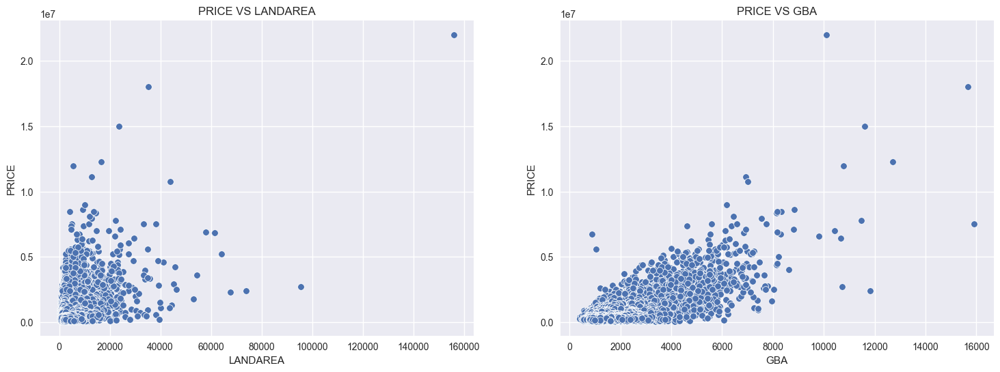

In [128]:
# Hubungan antara LANDAREA dan GBA dengan PRICE 
plt.style.use('seaborn')
fig, axes = plt.subplots(1,2, figsize=(18,6))
sns.scatterplot(data=dfAnalytics, x='LANDAREA', y='PRICE', ax=axes[0]).set_title('PRICE VS LANDAREA')
sns.scatterplot(data=dfAnalytics, x='GBA', y='PRICE', ax=axes[1]).set_title('PRICE VS GBA')
plt.show()

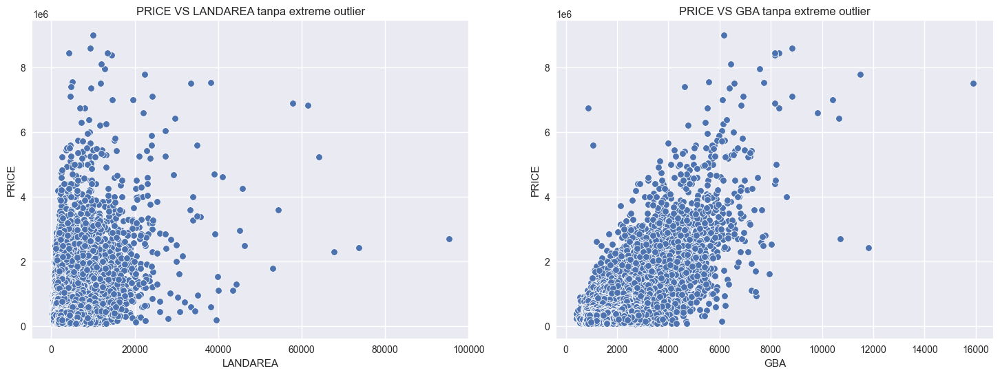

In [129]:
# Hubungan antara LANDAREA dan GBA dengan PRICE dengan menghapus extreme outlier
plt.style.use('seaborn')
fig, axes = plt.subplots(1,2, figsize=(18,6))
sns.scatterplot(data=dfAnalytics[dfAnalytics['PRICE']<10000000], x='LANDAREA', y='PRICE', ax=axes[0]).set_title('PRICE VS LANDAREA tanpa extreme outlier')
sns.scatterplot(data=dfAnalytics[dfAnalytics['PRICE']<10000000], x='GBA', y='PRICE', ax=axes[1]).set_title('PRICE VS GBA tanpa extreme outlier')
plt.show()

Setelah dilihat pada grafik dengan mengurangi outlier, hampir tidak terlihat adanya hubungan antara LANDAREA dan PRICE (no association). Namun, pada kolom GBA dapat dilihat terdapat hubungan moderate secara positif yang bersifat linear. Pada kolom tersebut diketahui semakin meningkat GBA, maka PRICE pun juga meningkat. Terdapat beberapa outlier yang bisa saja disebabkan karena pengaruh lain seperti fasilitas/fitur, lokasi, kelas maupun kondisi properti yang dapat mempengaruhi harga jual rumah tersebut.

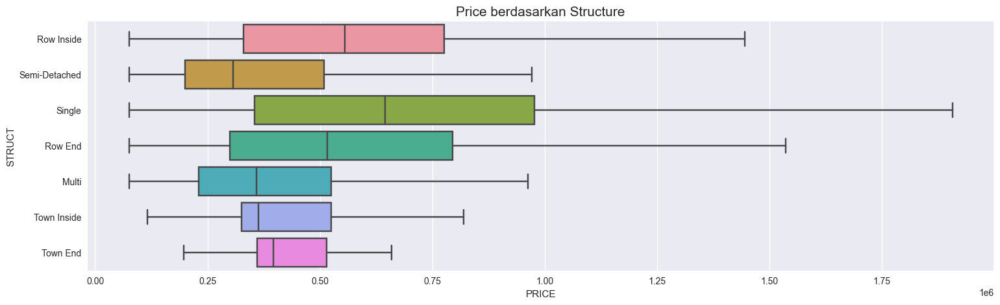

In [130]:
# Distribusi PRICE berdasarkan STRUCT
plt.style.use('seaborn')
plt.figure(figsize=(18,5))
sns.boxplot(x= dfAnalytics['PRICE'], y=dfAnalytics['STRUCT'], showfliers = False).set_title('Price berdasarkan Structure', size=15)
plt.show()

Berdasarkan stuktur bangunan, median harga tertinggi dimiliki oleh Single lalu disusul oleh Row Inside. Sedangkan median harga terendah dimiliki oleh rumah dengan Semi-Detached dan Multi. Hal ini bisa saja dipengaruhi oleh keuntungan yang didapatkan. Tipe struktur Single memiliki privasi yang lebih baik dibandingkan dengan struktur lain. Sedangkan Multi dan Semi-Detached merupakan stuktur yang kurang bisa mendapatkan privasi. Semi-Detached sendiri merupakan struktur dimana 2 rumah memiliki 1 tembok yang terhubung, sedangkan Multi merupakan sebuah bangunan yang diisi oleh 2 keluarga atau lebih. Dengan tingginya permintaan pasar dan sedikitnya ketersedian rumah, maka dalam hal ini privasi bisa dikatakan 'mahal'.

Akan dilihat apabila terdapat perbedaan median harga masing-masing kelompok pada kolom STRUCT dengan Uji Kruskal-Wallis.

In [131]:
# Melakukan Uji Kruskal-Wallis pada STRUCT terhadap PRICE
kruskaltest(dfAnalytics, 'STRUCT')

Result of STRUCT
H stat: 3385.7542952500007
P-value: 0.0


Berdasarkan hasil test Kruskal-Wallis, diketahui bahwa masing-masing kolom mendapatkan nilai P-value di bawah 0.05 (Menolak H0). Hal ini menyatakan bahwa pada fitur tersebut terbukti bahwa median harga properti tiap kelompok berbeda.

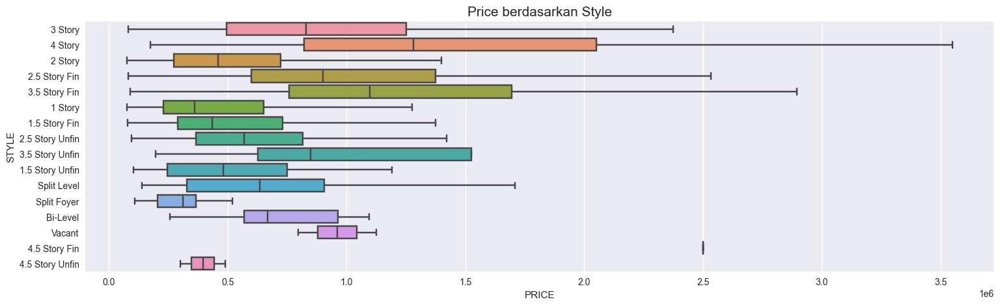

In [132]:
# Melihat distribusi PRICE berdasarkan STYLE
plt.style.use('seaborn')
plt.figure(figsize=(18,5))
sns.boxplot(x= dfAnalytics['PRICE'], y=dfAnalytics['STYLE'], showfliers = False).set_title('Price berdasarkan Style', size=15)
plt.show()

Dilihat dari hasil boxplot di atas didapatkan tipe bangunan 4.5 story fin memiliki nilai median tertinggi, lalu ada tipe bangunan 4 story di bawahnya. Selain itu, Split Foyer menjadi tipe bangunan dengan median harga terendah. Secara domain knowledge, semakin tinggi rumah maka harga rumah akan semakin mahal karena waktu dan biaya untuk pembuatan rumah yang lebih banyak. Namun, luas bangunan atau GBA juga perlu menjadi pertimbangan karena semakin luas setiap lantai maka biaya pun meningkat dan harga rumah juga akan meningkat.

Akan dilihat apabila terdapat perbedaan median harga masing-masing kelompok pada kolom STYLE dengan Uji Kruskal-Wallis.

In [133]:
# Uji Kruskal-Wallis pada Style terhadap PRICE
kruskaltest(dfAnalytics, 'STYLE')

Result of STYLE
H stat: 5166.365137578362
P-value: 0.0


Berdasarkan hasil test Kruskal-Wallis, diketahui bahwa masing-masing kolom mendapatkan nilai P-value di bawah 0.05 (Menolak H0). Hal ini menyatakan bahwa pada fitur tersebut terbukti bahwa median harga properti tiap kelompok berbeda.

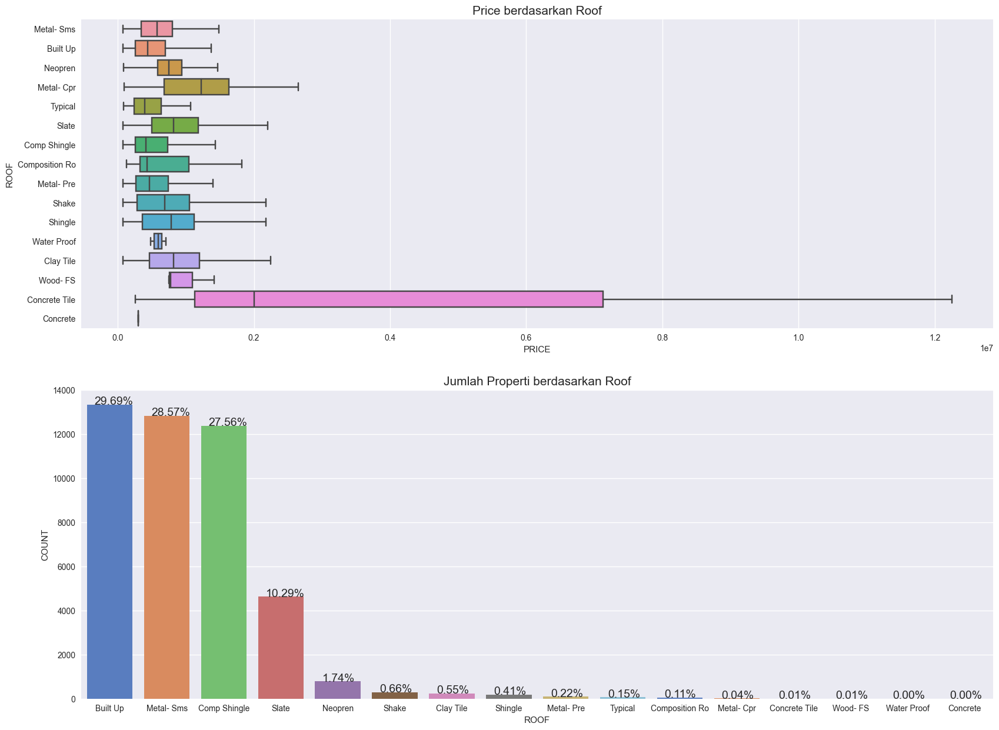

In [135]:
# Melihat distribusi price dan jumlah properti berdasarkan roof 
count_roof = dfAnalytics.groupby('ROOF')['PRICE'].count().reset_index().rename(columns={'PRICE':'COUNT'}).sort_values('COUNT', ascending=False)
plt.style.use('seaborn')
fig, axes = plt.subplots(2,1, figsize=(20,15))
sns.boxplot(x= dfAnalytics['PRICE'], y=dfAnalytics['ROOF'], ax=axes[0], showfliers = False).set_title('Price berdasarkan Roof', size=15)
count_roof = sns.barplot(data=count_roof, x='ROOF', y='COUNT', ax=axes[1], palette='muted')
for bar in count_roof.patches:
        percentage = '{:.2f}%'.format(100 * bar.get_height()/len(dfAnalytics['ROOF']))
        x = bar.get_x() + bar.get_width()/6
        y = bar.get_y() + bar.get_height()
        count_roof.annotate(percentage, (x, y), size = 14)
axes[1].set_title('Jumlah Properti berdasarkan Roof',size=15)
plt.show()

Pada kolom ini, median tertinggi ada pada Concrete Tile dan yang terendah adalah Concrete. Sedangkan untuk material yang paling banyak dipilih adalah Built Up dan diikuti Metal-Sms. Material dengan harga termahal adalah Slate. Dengan begitu, tentu kolom ini tidak berhubungan secara langsung dengan `PRICE`. Secara domain knowledge, disamping harga material untuk atap, luas permukaan sisi atas bangunan juga memiliki pengaruh yang besar terhadap cost yang dikeluarkan yang juga berpengaruh terhadap harga rumah tersebut.

Akan dilihat apabila terdapat perbedaan median harga masing-masing kelompok pada kolom ROOF dengan Uji Kruskal-Wallis.

In [136]:
# Uji Kruskal-Wallis pada ROOF terhadap PRICE
kruskaltest(dfAnalytics, 'ROOF')

Result of ROOF
H stat: 3367.7563019143117
P-value: 0.0


Berdasarkan hasil test Kruskal-Wallis, diketahui bahwa masing-masing kolom mendapatkan nilai P-value di bawah 0.05 (Menolak H0). Hal ini menyatakan bahwa pada fitur tersebut terbukti bahwa median harga properti tiap kelompok berbeda.

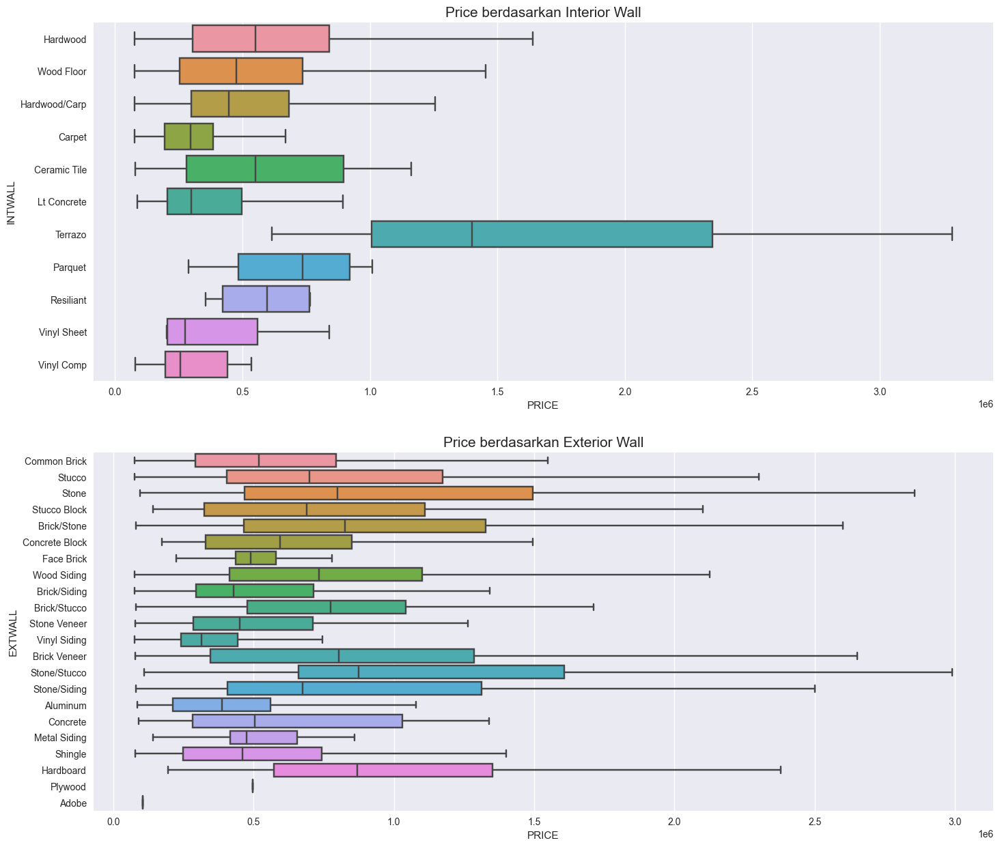

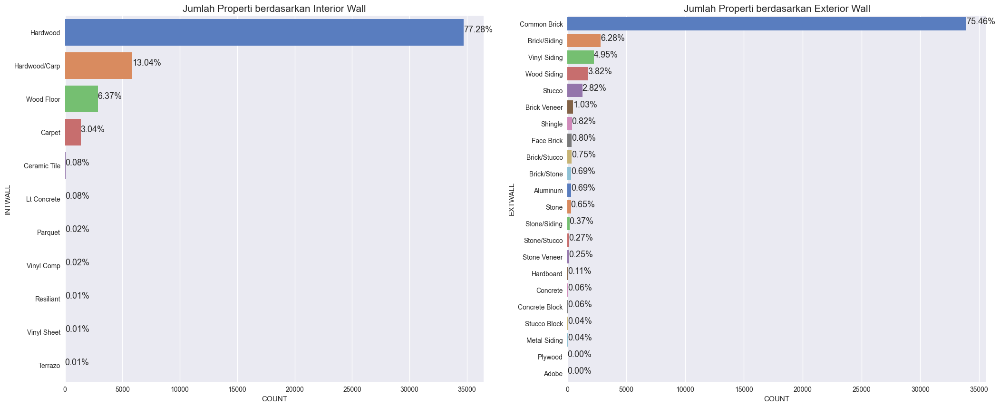

In [166]:
# Melihat distribusi harga dan jumlah properti berdasarkan INTWALL dan EXTWALL
count_int = dfAnalytics.groupby('INTWALL')['PRICE'].count().reset_index().rename(columns={'PRICE':'COUNT'}).sort_values('COUNT', ascending=False)
count_ext = dfAnalytics.groupby('EXTWALL')['PRICE'].count().reset_index().rename(columns={'PRICE':'COUNT'}).sort_values('COUNT', ascending=False)
plt.style.use('seaborn')
fig, axes = plt.subplots(2,1, figsize=(17, 15))
sns.boxplot(x= dfAnalytics['PRICE'], y=dfAnalytics['INTWALL'], ax=axes[0], showfliers = False).set_title('Price berdasarkan Interior Wall', size=15)
sns.boxplot(x= dfAnalytics['PRICE'], y=dfAnalytics['EXTWALL'], ax=axes[1], showfliers = False).set_title('Price berdasarkan Exterior Wall', size=15)

fig, axes = plt.subplots(1,2, figsize=(25, 10))
count_intwall = sns.barplot(data=count_int, y='INTWALL', x='COUNT', ax=axes[0], palette='muted')
for bar in count_intwall.patches:
    _x = bar.get_x() + bar.get_width() + float(0.05)
    _y = bar.get_y() + bar.get_height() - (bar.get_height()*0.5)
    value = '{:.2f}%'.format(100*bar.get_width()/len(dfAnalytics['INTWALL']))
    count_intwall.text(_x, _y, value, ha="left", size=13)
count_extwall = sns.barplot(data=count_ext, y='EXTWALL', x='COUNT', ax=axes[1], palette='muted')
for bar in count_extwall.patches:
    _x = bar.get_x() + bar.get_width() + float(0.05)
    _y = bar.get_y() + bar.get_height() - (bar.get_height()*0.5)
    value = '{:.2f}%'.format(100*bar.get_width()/len(dfAnalytics['EXTWALL']))
    count_extwall.text(_x, _y, value, ha="left", size=13)
axes[0].set_title('Jumlah Properti berdasarkan Interior Wall',size=15)
axes[1].set_title('Jumlah Properti berdasarkan Exterior Wall',size=15)
plt.show()

Pada kolom INTWALL, median harga tertinggi adalah material Terrazo dan Hardwood sebagai material yang terbanyak digunakan. Sedangkan pada kolom EXTWALL, median harga tertinggi adalah Stone/Stucco dan Common Brick sebagai material yang paling banyak digunakan. Sama seperti kolom ROOF, kedua kolom ini juga memiliki faktor lain yang turut berpengaruh dalam menentukan harga rumah yaitu luas sisi dinding. Semakin luas sisi dinding yang ada, semakin banyak cost yang dikeluarkan sehingga harga rumah akan naik.

Akan dilihat apabila terdapat perbedaan median harga masing-masing kelompok pada kolom EXTWALL dan INTWALL dengan Uji Kruskal-Wallis.

In [138]:
# Uji Kruskal-Wallis pada INTWALL dan EXTWALL terhadap PRICE
kruskaltest(dfAnalytics, 'INTWALL')
kruskaltest(dfAnalytics, 'EXTWALL')

Result of INTWALL
H stat: 1094.1306269253096
P-value: 9.720303926167466e-229
Result of EXTWALL
H stat: 2035.7267438951055
P-value: 0.0


Berdasarkan hasil test Kruskal-Wallis, diketahui bahwa masing-masing kolom mendapatkan nilai P-value di bawah 0.05 (Menolak H0). Hal ini menyatakan bahwa pada fitur tersebut terbukti bahwa median harga properti tiap kelompok berbeda.

## Price based on Feature

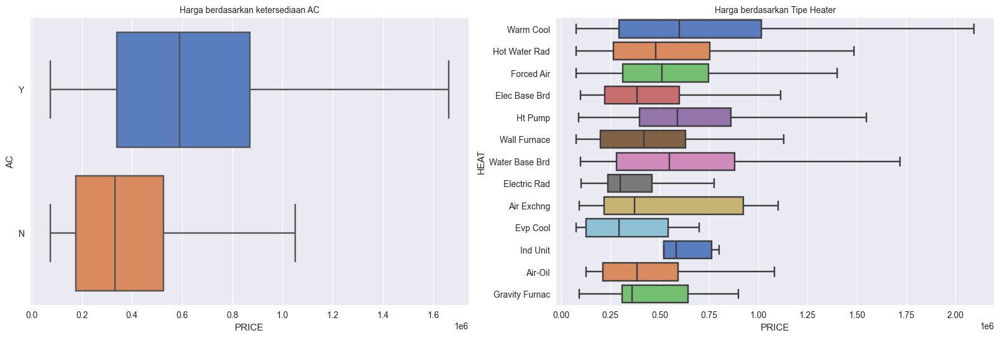

In [139]:
# Melihat distribusi harga berdasarkan AC dan HEAT
fig, axes = plt.subplots(1,2, figsize=(20,6))
sns.boxplot(data=dfAnalytics, y='AC', x='PRICE', ax=axes[0], palette='muted', showfliers=False).set_title('Harga berdasarkan ketersediaan AC', size=10)
sns.boxplot(data=dfAnalytics, y='HEAT', x='PRICE', ax=axes[1], palette='muted', showfliers=False).set_title('Harga berdasarkan Tipe Heater', size=10)
plt.show()

AC,N,Y
GRADE,,
Above Average,3307.0,10058.0
Average,4548.0,9461.0
Excellent,118.0,1436.0
Exceptional-A,14.0,359.0
Exceptional-B,2.0,133.0
Exceptional-C,NaN,29.0
Exceptional-D,NaN,24.0
Fair Quality,13.0,26.0
Good Quality,1671.0,8103.0


Text(0.5, 1.0, 'Proporsi AC berdasarkan Grade')

<Figure size 2000x600 with 0 Axes>

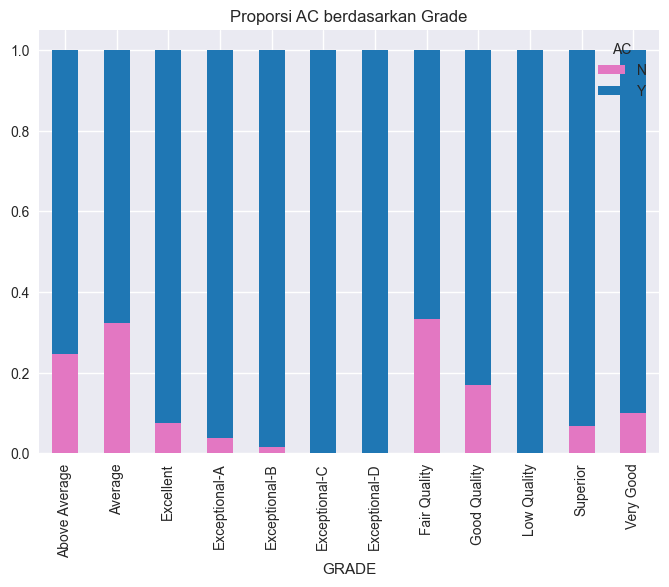

In [140]:
# Melihat proporsi AC berdasarkan CNDTN dan GRADE
AC_grade = dfAnalytics.pivot_table(index='GRADE', columns='AC', values='PRICE', aggfunc='count')
display(AC_grade)
plt.figure(figsize = (20,6))

pd.crosstab(dfAnalytics['GRADE'],dfAnalytics['AC'],normalize='index').sort_index().plot(color=['tab:pink',"tab:blue"], kind='bar', stacked=True).set_title('Proporsi AC berdasarkan Grade', size=12)

Dilihat dari data di atas, didapatkan bahwa rumah dengan AC memiliki harga yang lebih mahal. Selain itu, persentase kepemilikan AC berdasarkan urutan GRADE juga meningkat (kecuali kelas Fair yang hanya memiliki 1 data). Hal itu sejalan dengan domain knowledge bahwa dengan menambah fitur/alat maka harga akan semakin mahal. Dapat dilihat juga pada kolom HEAT bahwa median harga tertinggi adalah heater dengan tipe Warm Cool, sedangkan median harga terendah adalah tipe Evp Cool. Namun bila dibandingkan dengan harga rumah, harga heater sendiri memiliki selisih yang cukup jauh meskipun kapasitasnya bergantung pada luas rumah. Seperti contohnya tipe Furnace yang berada di kisaran 5000 - 11000 termasuk biaya pemasangan. Sehingga bisa dikatakan bahwa terdapat faktor lain selain tipe heater itu sendiri yang berpengaruh terhadap harga rumah.

Akan dilihat apabila terdapat perbedaan median harga masing-masing kelompok pada kolom AC dan HEAT dengan Uji Kruskal-Wallis.

In [141]:
# Uji Kruskal-Wallis pada AC dan HEAT terhadap PRICE
kruskaltest(dfAnalytics, 'AC')
kruskaltest(dfAnalytics, 'HEAT')

Result of AC
H stat: 4391.062487928353
P-value: 0.0
Result of HEAT
H stat: 628.4453865121551
P-value: 8.887269387869494e-127


Berdasarkan hasil test Kruskal-Wallis, diketahui bahwa masing-masing kolom mendapatkan nilai P-value di bawah 0.05 (Menolak H0). Hal ini menyatakan bahwa pada kedua fitur tersebut terbukti bahwa median harga properti tiap kelompok berbeda.

# Modeling
Setelah data dianalisa, akan dilanjutkan modeling dengan menggunakan data train dan data test. Adapun beberapa model yang akan digunakan untuk prediksi harga antara lain:

- LinearRegression
- KNeighborsRegressor
- DecisionTreeRegressor
- RandomForestRegressor
- GradientBoostingRegressor
- XGBRegressor

Selain itu model yang akan digunakan untuk clustering yaitu:

- K-means
- Agglomerative
- Metrik evaluasi yang akan

## Price Prediction
Choosing Benchmark Model

Pertama akan dibuat model sebagai base dengan menggunakan semua fitur dan melihat model terbaik. Setelah melakukan percobaan, model yang akan digunakan diberikan perlakuan dengan Transformed Target Regressor pada target. Transformed Target Regressor berupa fungsi logaritmik untuk liniearisasi target pada saat pemodelan dan target akan diubah menjadi range semula untuk interpretasi. Evaluasi yang akan digunakan adalah cross validation, yaitu metode pengambilan sampel ulang yang menggunakan bagian data yang berbeda untuk menguji dan melatih model pada iterasi yang berbeda guna mendapatkan performa model yang stabil.

Dari data target yang dimiliki, maka pemodelan Regresi adalah cara yang paling tepat. Regresi sendiri memiliki beberapa macam model seperti Linear Regression, Decision Tree, KNearestNeighbor, Random Forest, GradientBoost dan XGBoost. Namun dengan karakteristik data yang kita miliki seperti adanya data outlier dan adanya fitur yang memiliki kolinearitas maka model yang tepat untuk memproses data ini adalah Random Forest, Gradient Boost dan XGBoost. Untuk membuktikan hal tersebut, maka akan dilakukan pemilihan benchmark berdasarkan hasil uji dari ke 6 model Regresi dan melihat hasil yang diberikan.

In [142]:
# Model
lr = LinearRegression()
knn = KNeighborsRegressor()
dt = DecisionTreeRegressor(random_state=0)
rf = RandomForestRegressor(random_state=0)
gb = GradientBoostingRegressor(random_state=0)
xgb = XGBRegressor(random_state=0)

# Pemodelan dilakukan dalam skala logaritmik, namun kemudian di-inverse kembali untuk interpretasi
log_lr = TransformedTargetRegressor(lr, func=np.log, inverse_func=np.exp)
log_knn = TransformedTargetRegressor(knn, func=np.log, inverse_func=np.exp)
log_dt = TransformedTargetRegressor(dt, func=np.log, inverse_func=np.exp)
log_rf = TransformedTargetRegressor(rf, func=np.log, inverse_func=np.exp)
log_gb = TransformedTargetRegressor(gb, func=np.log, inverse_func=np.exp)
log_xgb = TransformedTargetRegressor(xgb, func=np.log, inverse_func=np.exp)

In [143]:
# Algoritma Candidates
models = [log_lr,log_knn,log_dt,log_rf,log_gb,log_xgb]

score_mae = []
score_mape = []
score_r2 = []

# Mencari algoritma terbaik berdasarkan nilai MAE
for model in models:
    
    crossval = KFold(n_splits=5, shuffle=True, random_state=8)

    estimator = Pipeline([
        ('preprocessing', transformer),
        ('model', model)
    ])

    # MAE
    model_cv_mae = cross_val_score(
        estimator, 
        x_train, 
        y_train, 
        cv=crossval, 
        scoring='neg_mean_absolute_error', 
        error_score='raise'
        )

    print(model_cv_mae, model)

    score_mae.append(model_cv_mae.mean())
    
    # MAPE
    model_cv_mape = cross_val_score(
        estimator, 
        x_train, 
        y_train, 
        cv=crossval, 
        scoring='neg_mean_absolute_percentage_error', 
        error_score='raise'
        )

    print(model_cv_mape, model)

    score_mape.append(model_cv_mape.mean())

    # R2
    model_cv_r2 = cross_val_score(
        estimator, 
        x_train, 
        y_train, 
        cv=crossval, 
        scoring='r2', 
        error_score='raise'
        )
    
    print(model_cv_r2, model)

    score_r2.append(model_cv_r2.mean())

[-123631.89653969 -126631.6870294  -122476.39876634 -115556.60075588
 -126008.50132717] TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=LinearRegression())
[-0.2098816  -0.21705277 -0.2154555  -0.21598345 -0.22152501] TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=LinearRegression())
[0.81905899 0.35470985 0.78888749 0.84728999 0.70164099] TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=LinearRegression())
[-255367.75301057 -254420.84656422 -244819.68619725 -250488.16488688
 -250503.57515924] TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=KNeighborsRegressor())
[-0.52122594 -0.539087   -0.52248211 -0.56758222 -0.53934113] TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=

In [144]:
# Melihat evaluasi data train
score_mae2 = [abs(ele) for ele in score_mae]
score_mape2 = [abs(ele) for ele in score_mape]
pd.DataFrame({
    'Model': ['LinearRegression', 'KNN', 'Decision Tree', 'Random Forest', 'Gradient Boosting', 'XGBoost'],
    'MAE': score_mae2,
    'MAPE':score_mape2,
    'R-squared': score_r2
})

,Model,MAE,MAPE,R-squared
0,LinearRegression,122861.016884,0.215980,0.702317
1,KNN,251120.005164,0.537944,0.440221
2,Decision Tree,117040.363544,0.194586,0.809011
3,Random Forest,77242.047628,0.128167,0.906769
4,Gradient Boosting,86234.019718,0.148705,0.892287
5,XGBoost,71849.754571,0.122429,0.919964


Dapat dilihat pada tabel di atas model XGBoost memiliki nilai MAE 71849.75, MAPE 12.24%, dan R-Squared 0.919 dan disusul oleh Random Forest dengan MAE 77242.04, MAPE 12.82%, dan R-Squared 0.907. XGBoost merupakan model yang menggunakan metode Boosting, dimana Boosting merupakan pembelajaran berulang yang memberikan bobot lebih pada prediksi data yang salah terhadap iterasi selanjutnya dengan pemahaman dan pola yang menyeluruh dalam data. XGBoost menggunakan formalisasi model yang lebih teratur untuk mengontrol over-fitting, yang memberikan kinerja yang lebih baik dari Gradient Boost. XGBoost memiliki kinerja yang baik karena termasuk model yang robust untuk berbagai jenis data. Sedangkan, Random Forest menggunakan metode Bagging dengan prediksi yang mengambil majority votes dari beberapa Decision Tree. Optimalisasi Random Forest bergantung pada Hyperparameter tuning. Selanjutnya akan dilakukan prediksi pada test set menggunakan XGBoost dan Random Forest yang merupakan benchmark model.

## Predict Test Set using Benchmark Model

In [145]:
# Melihat prediksi menggunakan test set model XGBoost dan Random Forest
rf = RandomForestRegressor(random_state=0)
xgb = XGBRegressor(random_state=0)

modeltest = [xgb, rf]
score_mae = []
score_mape = []
score_r2 = []

for i in modeltest:
        estimator = Pipeline([('preprocessing', transformer),('model', i)])

        estimator.fit(x_train, y_train)
        y_pred = estimator.predict(x_test)
        score_mae.append(mean_absolute_error(y_test, y_pred))
        score_mape.append(mean_absolute_percentage_error(y_test, y_pred))
        score_r2.append(r2_score(y_test, y_pred))

score_before_tuning = pd.DataFrame({'MAE': score_mae, 'MAPE': score_mape, 'R-squared': score_r2}, index=['XGBoost','Random Forest'])
score_before_tuning

,MAE,MAPE,R-squared
XGBoost,74854.303014,0.131614,0.878719
Random Forest,77432.540281,0.129647,0.881790


Dapat dilihat bahwa terdapat sedikit perbedaan nilai MAE dan MAPE pada model XGBoost dan Random Forest, dimana model XGBoost secara akumulatif memiliki nilai yang lebih baik.

# Kesimpulan :

- Pasar di Amerika dipengaruhi oleh bulan dan musim, dimana pada musim dingin yaitu bulan Desember sampai Februari memiliki nilai harga terendah yang merupakan waktu para pengusaha real estate menurunkan intensitas penjualan karena holiday season. Market residential real estate mulai kembali aktif di musim semi dari bulan Maret sampai Mei, dan median harga dan jumlah properti memuncak dengan demand terbanyak pada musim panas yaitu bulan Juni sampai Agustus.
- Model terbaik yang dipilih adalah XGBoost dengan tuning tanpa outlier dengan nilai MAE sebesar 74854.303014
- Memotong Budget Survey, perusahaan juga mampu memotong pengeluaran untuk pemakaian jasa surveyor properti. Maka dari itu, dengan bantuan Machine Learning, bila diasumsikan jasa surveyor tidak digunakan sama sekali, maka perusahaan bisa menghemat dan menggunakan untuk kepentingan lain seperti promosi
- Features dari dataset yang paling berpengaruh terhadap harga properti adalah GRADE, diikuti dengan kolom GBA dan SALEYEAR. Kolom GRADE memiliki pengaruh yang paling signifikan terhadap PRICE yaitu semakin tinggi GRADE makan harga cenderung semakin tinggi juga, ditunjukkan dengan median tiap GRADE yang meningkat sesuai order. Hal yang sama terdapat pada GBA dan SALEYEAR. Semakin luas nilai GBA maka harga cenderung naik, dan semakin terkini tahun SALEYEAR maka harga cenderung naik.